In [22]:
!python -V

Python 3.10.8


In [25]:
%run entangled_halo_core

output/entangled_halo_proj/(20230212-121932-F) 


In [26]:
%config InlineBackend.figure_format = 'retina'
# %config InlineBackend.figure_format = 'svg'
# %config InlineBackend.figure_format = 'pdf'
%matplotlib inline

## Simulation Parameters

In [27]:
print("zmax =", zmax)
print("(dx,dz) =", (dx, dz) ) 
print("rotate phase =", 1j*hb*dt/(2*m4*dx*dz)) #want this to be small

print("pxmax =", pxmax)
print("pzmax =", pxmax)

print("(dpx,dpz) = ", (dpx, dpz))

print(round((nx*nz)**2/1000/1000,3),"million grid points (ideally want around 1M magnitude)")
print(round(2*8*(nx*nz)**2/1000/1000,3),"MB of data needed estimate")
print(round(5*2*8*(nx*nz)**2/1000/1000,3),"MB of RAM needed to run this thing (estimate)")
print(round((nx*nz)**2*0.001*0.001/60, 2),"minutes/grid_op (for 1μs/element_op)")

assert ((nx*nz)**2 < 1000**4), "This is in the terra range! too big!"

zmax = 22
(dx,dz) = (0.2, 0.55)
rotate phase = 0.03608397727272727j
pxmax = 1005.5588151452754
pzmax = 1005.5588151452754
(dpx,dpz) =  (7.980625517025995, 9.068892632984085)
413.35 million grid points (ideally want around 1M magnitude)
6613.593 MB of data needed estimate
33067.965 MB of RAM needed to run this thing (estimate)
6.89 minutes/grid_op (for 1μs/element_op)


In [28]:
warnings.warn(str(round(5*2*8*(nx*nz)**2/1000/1000/1000,3)) + " GB of RAM needed to run this thing (estimate)")

In [29]:
print("k  =",k,"1/µm")
print("p  =",p, "u*µm/ms")

print("v3 =",v3, "µm/ms")
print("v4 =",v4, "µm/ms")
print("sigma_x =", hb/10, " handwavy heisenberg momentum uncertainty ")
print(2*pi / (2*k), "x-period of cosin bragg lattice")

# sanity check
assert (pxmax > p*2.5 or pzmax > p*2.5), "momentum resolution too small"
assert (dpx < hb/2 and dpz < hb/2), "momentum resolution step too big"
# assert (2*pi / (2*k) > 10*dx), "not even ten x-steps in cosin wave!"

k  = 3.9269908169872414 1/µm
p  = 498.78909481412467 u*µm/ms
v3 = 83.13151580235412 µm/ms
v4 = 62.34863685176558 µm/ms
sigma_x = 6.35078  handwavy heisenberg momentum uncertainty 
0.8 x-period of cosin bragg lattice


AssertionError: momentum resolution too small

In [30]:
# dopd = 60.1025 # 1/ms Doppler detuning (?)
dopd = v3**2 * m3 / hb
print(dopd)
warnings.warn("why? TODO: check")

326.45669915807434


In [18]:
pi / (8*dx)

1.9634954084936207

In [19]:
a4 = 0.007512 # scattering length 
omega = 50 # I don't know, the nature paper used 50 for Rb
V0 = 2*hb*omega
tBraggPi = np.sqrt(2*pi*hb)/V0
# tBraggCenter = 1
tBraggCenter = tBraggPi * 5
tBraggEnd = tBraggPi * 10
print("V0 =", V0)
print("tBraggPi     =", round(tBraggPi,3),"µs")
print("tBraggCenter =", round(tBraggCenter,3),"µs")
print("tBraggEnd    =", round(tBraggEnd,3),"µs")

@njit(cache=True)
def V(t):
    return V0 * (2*pi)**-0.5 * tBraggPi**-1 * np.exp(-0.5*(t-tBraggCenter)**2 * tBraggPi**-2)

@njit(cache=True)
def VB(t, tauMid, tauPi):
        return V0 * (2*pi)**-0.5 * tauPi**-1 * np.exp(-0.5*(t-tauMid)**2 * tauPi**-2)

V0F = 50*1000

@njit(cache=True)
def VBF(t, tauMid, tauPi, V0FArg=V0F):
        return V0FArg * (2*pi)**-0.5 * np.exp(-0.5*(t-tauMid)**2 * tauPi**-2)
    
print(1j*(dt/hb), "term infront of Bragg potential")
print(1j*(dt/hb)*V(tBraggCenter), "max(V)")

pxlin = np.linspace(-pxmax,+pxmax,nx,dtype=dtyper)
pzlin = np.linspace(-pzmax,+pzmax,nz,dtype=dtyper)

V0 = 6350.780000000001
tBraggPi     = 0.003 µs
tBraggCenter = 0.016 µs
tBraggEnd    = 0.031 µs
7.873048664888407e-06j term infront of Bragg potential
6.341670455467974j max(V)


In [20]:
warnings.warn("The code below probably will take " + str(round(5*2*8*(nx*nz)**2/1000/1000/1000,3)) + " GB RAM")

assert 5*2*8*(nx*nz)**2/1000/1000/1000 < 10, " Catch! (stops run all cell - continuing may break the computer!) "

AssertionError:  Catch! (stops run all cell - continuing may break the computer!) 

In [22]:
process = psutil.Process(os.getpid())
def current_py_memory(): return process.memory_info().rss;
def current_py_memory_print(): print(str(round(current_py_memory()/1000**2,3)) + "MB of system memory used")

In [23]:
xlin = np.linspace(-xmax,+xmax, nx, dtype=dtyper)
zlin = np.linspace(-zmax,+zmax, nz, dtype=dtyper)
# psi=np.zeros((nx,nz, nx,nz),dtype=dtype)
# psi=np.random.rand(nx,nz, nx,nz) + 1j*np.random.rand(nx,nz, nx,nz)
# print(round(psi.nbytes/1000/1000 ,3) , "MB per psi 2d*2d array")

In [24]:
current_py_memory_print()

268.73MB of system memory used


In [25]:
xgrid = np.tensordot(xlin, np.ones(nz, dtype=dtyper), axes=0)
cosXGrid = np.cos(2*k*xgrid)
# x3grid = np.tensordot(xgrid, np.ones((nx,nz),dtype=dtyper), axes=0)
# x4grid = np.tensordot(np.ones((nx,nz),dtype=dtyper), xgrid, axes=0)
# cosX3Grid = np.cos(2*k*x3grid)
# cosX4Grid = np.cos(2*k*x4grid)

momory_bytes = current_py_memory()
if (momory_bytes/1000**3 > 1): 
    warnings.warn(str(round(momory_bytes/1000**3,3))+" GB of system memory used already! careful!")
else:
    print(momory_bytes/1000**2 , "MB of system memory used")
del momory_bytes

269.287424 MB of system memory used


In [26]:
current_py_memory_print()

269.304MB of system memory used


### Contact Potential?

In [28]:
# # a34 = 0.029 #µm
# a34 = 0.5 #µm
# strength34 = 1e5 # I don't know

In [29]:
((nx-1)/2,(nz-1)/2)

(125.0, 40.0)

In [30]:
current_py_memory_print()

269.32MB of system memory used


### Checking parameters

78


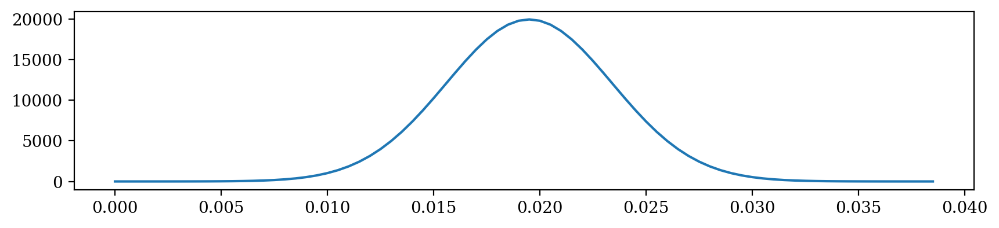

In [31]:
tauPi  = 39*0.0001
tauMid = tauPi*5
tauEnd = tauPi*10

# smooth bragg in time
tbtest = np.arange(0, tauEnd,dt)
# plt.plot(tbtest, V(tbtest))
print(tbtest.size)
plt.figure(figsize=(10,2))
plt.plot(tbtest, VBF(tbtest,tauMid,tauPi))

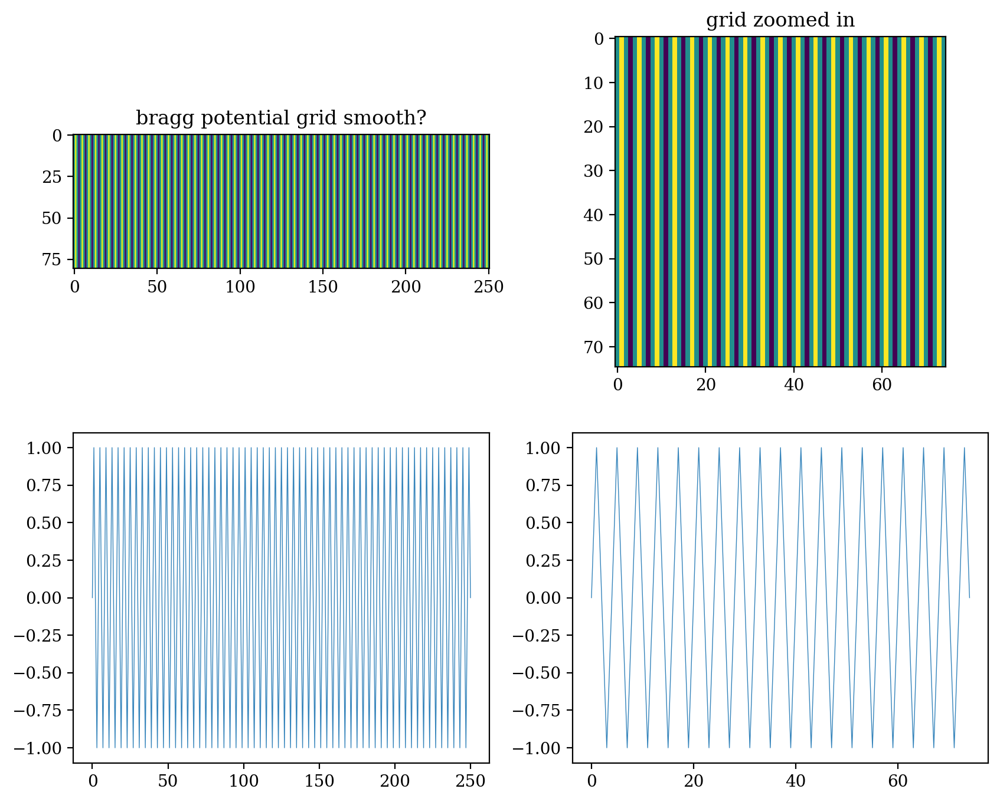

In [32]:
# vtest = np.cos(2*k*xlin)
ncrop = int(0.3*nx)
plt.figure(figsize=(10,8))
plt.subplot(2,2,1)
plt.imshow(cosXGrid.T)
plt.title("bragg potential grid smooth?")

plt.subplot(2,2,2)
plt.imshow(cosXGrid[:ncrop,:ncrop].T)
plt.title("grid zoomed in")

plt.subplot(2,2,3)
plt.plot(cosXGrid[:,0],alpha=0.9,linewidth=0.5)

plt.subplot(2,2,4)
plt.plot(cosXGrid[:ncrop,0],alpha=0.9,linewidth=0.5)

title="bragg_potential_grid"
# plt.savefig("output/"+title+".pdf", dpi=600)
# plt.savefig("output/"+title+".png", dpi=600)

plt.show()
del ncrop
del cosXGrid

## initial wave function

In [33]:
dx

0.2

In [34]:
sg = 8;
# @njit(parallel=True, fastmath=True)
# @jit('c16[::1](f8[::1],f8,f8,f8,f8,f8,f8,f8,f8,f8,f8,f8,)')
@njit(cache=True)
def psi0gaussianNN(x3, z3, x4, z4, sx3=sg, sz3=sg, sx4=sg, sz4=sg, px3=0.0, pz3=0.0, px4=0.0, pz4=0.0):
    return    np.exp(-0.5*x3**2/sx3**2)\
            * np.exp(-0.5*z3**2/sz3**2)\
            * np.exp(-0.5*x4**2/sx4**2)\
            * np.exp(-0.5*z4**2/sz4**2)\
            * np.exp(+(1j/hb)*(px3*x3 + pz3*z3 + px4*x4 + pz4*z4))

# @njit(parallel=True, fastmath=True)
# @jit('f8(c16[::4],f8,f8)', forceobj=True)
# @jit(forceobj=True)
@njit(cache=True)
def check_norm(psi,dx=dx,dz=dz) -> dtyper:
    return np.trapz(np.trapz(np.trapz(np.trapz(np.abs(psi)**2))))*(dx*dx*dz*dz)
#     return  np.trapz(
#                 np.trapz(
#                     np.trapz(
#                         np.trapz(np.abs(psi)**2,
#                             dx=dz,axis=numba.literally(3)),
#                         dx=dx,axis=numba.literally(2)),
#                     dx=dz,axis=numba.literally(1))
#                 ,dx=dx,axis=numba.literally(0))
#     with objmode(psi='intp[:]',dx='intp[:]',dz='intp[:]'):
#     return np.trapz(np.trapz(np.trapz(np.trapz(np.abs(psi)**2,dx=dz,axis=3),dx=dx,axis=2),dx=dz,axis=1),dx=dx,axis=0)
#     out = -1
#     with objmode(out='intp[:]'):
#         out = np.trapz(np.trapz(np.trapz(np.trapz(np.abs(psi)**2,dx=dz,axis=3),dx=dx,axis=2),dx=dz,axis=1),dx=dx,axis=0)
#     return out
        
# @njit(parallel=True, fastmath=True)
# @njit(parallel=True)

# @njit(parallel=True)
# def psi0gaussian_loop_helper(sx3,sz3,sx4,sz4,px3,pz3,px4,pz4,xlin,zlin):
#     psi=np.zeros((nx,nz, nx,nz),dtype=dtype)
# #     for (iz3, z3) in enumerate(zlin):
#     for iz3 in prange(nz):
#         z3 = zlin[iz3]
#         for (ix4, x4) in enumerate(xlin):
#             for (iz4, z4) in enumerate(zlin):
#                 psi[:,iz3,ix4,iz4] = psi0gaussianNN(xlin, z3, x4, z4,sx3,sz3,sx4,sz4,px3,pz3,px4,pz4)
#     return psi

@njit(parallel=True, cache=True)
# @njit(cache=True)
def psi0gaussian(sx3=sg, sz3=sg, sx4=sg, sz4=sg, px3=0, pz3=0, px4=0, pz4=0, xlin=xlin,zlin=zlin) -> np.ndarray:
#     psi =  psi0gaussian_loop_helper(sx3,sz3,sx4,sz4,px3,pz3,px4,pz4,xlin,zlin)
    psi=np.zeros((nx,nz, nx,nz),dtype=dtype)
#     for (iz3, z3) in enumerate(zlin):
    for iz3 in prange(nz):
        z3 = zlin[iz3]
        for (ix4, x4) in enumerate(xlin):
            for (iz4, z4) in enumerate(zlin):
                psi[:,iz3,ix4,iz4] = psi0gaussianNN(xlin, z3, x4, z4,sx3,sz3,sx4,sz4,px3,pz3,px4,pz4)
    normalisation = check_norm(psi)
    return (psi/sqrt(normalisation)).astype(dtype)

# @njit(parallel=True)
@jit(forceobj=True)
# @njit
def only3(psi):
    return np.trapz(np.trapz(np.abs(psi)**2 ,dx=dz,axis=3),dx=dx,axis=2)
#     return np.trapz(np.trapz(np.abs(psi)**2,axis=3),axis=2)*(dx*dz)

# @njit(parallel=True)
@jit(forceobj=True)
def only4(psi):
    return np.trapz(np.trapz(np.abs(psi)**2 ,dx=dx,axis=0),dx=dz,axis=0)



In [35]:
psi0gaussian.signatures

[]

In [36]:
# @njit(parallel=True)
# def psi0_just_opposite_loop_helper(dx3,dz3,dx4,dz4,s3,s4,px,pz,xlin,zlin):
#     psi = np.zeros((nx,nz,nx,nz),dtype=dtype)
# #     for (iz3, z3) in enumerate(zlin):
#     for iz3 in prange(nz):
#         z3 = zlin[iz3]
#         for (ix4, x4) in enumerate(xlin):
#             for (iz4, z4) in enumerate(zlin):
#                 psi[:,iz3,ix4,iz4] = psi0gaussianNN(xlin-dx3,z3-dz3, x4+dx4,z4+dz4, s3,s3, s4,s4,+px,+pz,-px,-pz)
#     return psi


@njit(parallel=True, cache=True)
# @jit(forceobj=True)
# @njit(cache=True)
def psi0_just_opposite(dr=20,s3=sg,s4=sg,pt=0,a=0,xlin=xlin,zlin=zlin):
    dr3 = 0.5 * dr;
    dr4 = 0.5 * (m3/m4) * dr;
    dx3 = dr3 * cos(a)
    dz3 = dr3 * sin(a)
    dx4 = dr4 * cos(a)
    dz4 = dr4 * sin(a)
    ph = 0.5 * pt;
    px = +ph * cos(a)
    pz = +ph * sin(a)
    
#     print((+px,+pz,-px,-pz))
#     psi = psi0_just_opposite_loop_helper(dx3,dz3,dx4,dz4,s3,s4,px,pz,xlin,zlin)
    psi = np.zeros((nx,nz,nx,nz),dtype=dtype)
#     for (iz3, z3) in enumerate(zlin):
    for iz3 in prange(nz):
        z3 = zlin[iz3]
        for (ix4, x4) in enumerate(xlin):
            for (iz4, z4) in enumerate(zlin):
                psi[:,iz3,ix4,iz4] = psi0gaussianNN(xlin-dx3,z3-dz3, x4+dx4,z4+dz4, s3,s3, s4,s4,+px,+pz,-px,-pz)
    normalisation = check_norm(psi)
    return (psi/sqrt(normalisation)).astype(dtype)
    

In [37]:
@njit(cache=True)
def psi0PairNN(x3,z3,x4,z4,dr=20,s3=sg,s4=sg,pt=p,a=0):
    dr3 = 0.5 * dr;
    dr4 = 0.5 * (m3/m4) * dr;
    dx3 = dr3 * cos(a)
    dz3 = dr3 * sin(a)
    dx4 = dr4 * cos(a)
    dz4 = dr4 * sin(a)
    ph = 0.5 * pt;
    px3 = +ph * cos(a)
    pz3 = +ph * sin(a)
    px4 = -ph * cos(a)
    pz4 = -ph * sin(a)
    return (psi0gaussianNN(x3-dx3,z3-dz3, x4+dx4,z4+dz4, s3,s3, s4,s4,+px3,+pz3,+px4,+pz4) + 
            psi0gaussianNN(x3+dx3,z3+dz3, x4-dx4,z4-dz4, s3,s3, s4,s4,-px3,-pz3,-px4,-pz4)
           )

# @njit(parallel=True)
# def psi0Pair_loop_helper(dr,s3,s4,pt,a,xlin=xlin,zlin=zlin):
#     psi = np.zeros((nx,nz,nx,nz),dtype=dtype)
# #     for (iz3, z3) in enumerate(zlin):
#     for iz3 in prange(nz):
#         z3 = zlin[iz3]
#         for (ix4, x4) in enumerate(xlin):
#             for (iz4, z4) in enumerate(zlin):
#                 psi[:,iz3,ix4,iz4] = psi0PairNN(xlin, z3, x4, z4, dr,s3,s4,pt,a)
#     return psi

@njit(cache=True, parallel=True)
# @njit(cache=True)
def psi0Pair(dr=20,s3=sg,s4=sg,pt=p,a=0,nx=nx,nz=nz):
    psi = np.zeros((nx,nz,nx,nz),dtype=dtype)
#     for (iz3, z3) in enumerate(zlin):
    for iz3 in prange(nz):
        z3 = zlin[iz3]
        for (ix4, x4) in enumerate(xlin):
            for (iz4, z4) in enumerate(zlin):
                psi[:,iz3,ix4,iz4] = psi0PairNN(xlin, z3, x4, z4, dr,s3,s4,pt,a)
    normalisation = check_norm(psi)
    #print(normalisation)
    return (psi/sqrt(normalisation)).astype(dtype)

In [38]:
@njit(nogil=True,parallel=True,cache=True) # psi0Pair already parallelised
# @njit(nogil=True,cache=True)
# @njit(cache=True)
def psi0ring_loop_helper(dr,s3,s4,pt,an, 
#                         ):
                         progress_proxy=None):
    psi = np.zeros((nx,nz,nx,nz),dtype=dtype)
    angles_list = np.linspace(0,pi,an+1)[:-1]
#     print(an, psi.shape)
    for ia in range(an):
        a = angles_list[ia]
        # print("working on a = "+str(round(a/pi,4))+" * pi      ",end='\r')
#         print(psi0Pair(dr=dr,s3=s3,s4=s4,pt=pt,a=a).shape)
        psi += (1/an) * psi0Pair(dr=dr,s3=s3,s4=s4,pt=pt,a=a,nx=nx,nz=nz)
#         psi_un = psi0Pair_loop_helper(dr=dr,s3=s3,s4=s4,pt=pt,a=a)
        if progress_proxy != None:
            progress_proxy.update(1)
    return psi.astype(dtype)

# @jit(cache=True,forceobj=True)
def psi0ring_with_logging(dr=20,s3=3,s4=3,pt=p,an=4):   
#     psi = np.zeros((nx,nz,nx,nz),dtype=dtype)
#     for (iz3, z3) in enumerate(zlin):
#         for (ix4, x4) in enumerate(xlin):
#             print("working on "+str((iz3,ix4))+"      ",end='\r')
#             for (iz4, z4) in enumerate(zlin):
#                 for a in np.linspace(0,2*pi,360):
#                     psi[:,iz3,ix4,iz4] += psi0PairNN(xlin, z3, x4, z4, dr,s3,s4,pt,a)
#     angles_divs = 4
    angles_list = np.linspace(0,pi,an+1)[:-1]
    
#     if logging:
    print("angles_list = "+ str(np.round(angles_list/pi,4)) + " * pi")
    with ProgressBar(total=an) as progress:
        psi = psi0ring_loop_helper(dr,s3,s4,pt,an,progress)
#     psi = psi0ring_loop_helper(dr,s3,s4,pt,an)
    normalisation = check_norm(psi)
#     print(" ")
#     print("normalisation =", normalisation)
    return (psi/sqrt(normalisation)).astype(dtype)
#     else:
# #         for a in angles_list:
# #             psi += (1/an) * psi0Pair(dr=dr,s3=s3,s4=s4,pt=p,a=a)
#         psi = psi0ring_loop_helper(dr,s3,s4,pt,an,None)
#         normalisation = check_norm(psi)
#         return psi/sqrt(normalisation)
    
# @njit(cache=True)
def psi0ring(dr=20,s3=3,s4=3,pt=p,an=4):   
    psi = psi0ring_loop_helper(dr,s3,s4,pt,an)
    normalisation = check_norm(psi)
    return (psi/sqrt(normalisation)).astype(dtype)

In [39]:
gc.collect()

12850

#### Testings

In [ ]:
su = 4
psi = psi0gaussian(sx3=su, sz3=su, sx4=su, sz4=su, px3=-100, pz3=-50, px4=100, pz4=50)
t = 0

tempTest3 = only3(psi)
tempTest4 = only4(psi)
print("check normalisation psi", check_norm(psi))
phi, swnf = phiAndSWNF(psi)
tempTest3phi = only3phi(phi)
tempTest4phi = only4phi(phi)
print("check normalisation phi", check_norm_phi(phi))
print("swnf =", swnf)

plt.figure(figsize=(12,6))
plt.subplot(2,2,1)
plt.imshow(np.flipud(tempTest3.T), extent=[-xmax,xmax,-zmax,zmax])

plt.subplot(2,2,2)
plt.imshow(np.flipud(tempTest4.T), extent=[-xmax,xmax,-zmax,zmax])

plt.subplot(2,2,3)
plt.imshow((tempTest3phi.T), extent=[-pxmax,pxmax,-pzmax,pzmax])
# plt.colorbar()

plt.subplot(2,2,4)
plt.imshow((tempTest4phi.T), extent=[-pxmax,pxmax,-pzmax,pzmax])
# plt.colorbar()

plt.show()
del tempTest3, tempTest4, tempTest3phi, tempTest4phi
current_py_memory_print()

In [ ]:
tempTest3phi = only3phi(phi)

#### Testings v2

In [39]:
print(22*32/60, "min")

11.733333333333333 min


In [ ]:
# su = 4
# psi = psi0Pair(dx=20,s3=su,s4=su,pt=0,a=0)
# del psi
psi = psi0ring_with_logging(dr=5,s3=1.7,s4=1.7,pt=2*hb*k,an=32)
t = 0

check normalisation psi 1.0000000000000002
check normalisation phi 0.9999999999999998
swnf = (192.47056959528948+0j)


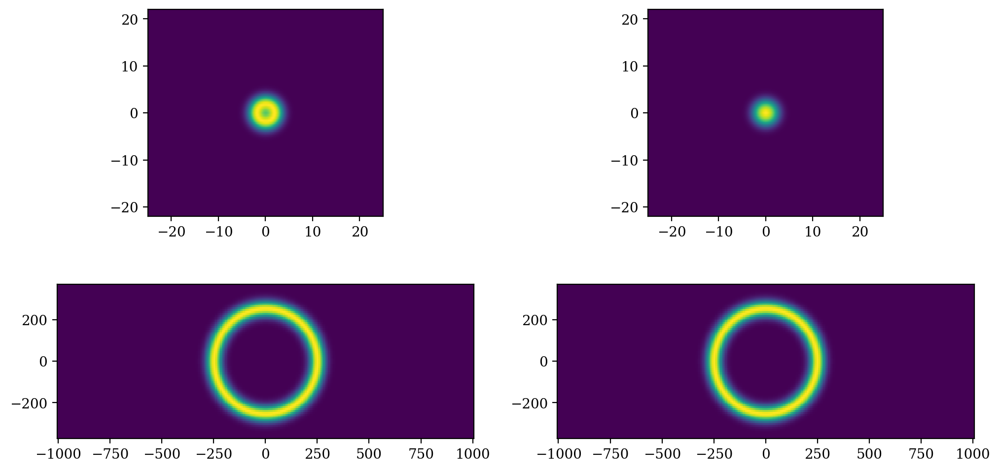

13638.975MB of system memory used


In [56]:
print("check normalisation psi", check_norm(psi))
phi, swnf = phiAndSWNF(psi)
print("check normalisation phi", check_norm_phi(phi))
print("swnf =", swnf)

plt.figure(figsize=(12,6))
plt.subplot(2,2,1)
plt.imshow(np.flipud(only3(psi).T), extent=[-xmax,xmax,-zmax,zmax])

plt.subplot(2,2,2)
plt.imshow(np.flipud(only4(psi).T), extent=[-xmax,xmax,-zmax,zmax])

plt.subplot(2,2,3)
plt.imshow(np.flipud(only3phi(phi).T), extent=[-pxmax,pxmax,-pzmax,pzmax])
# plt.colorbar()

plt.subplot(2,2,4)
plt.imshow(np.flipud(only4phi(phi).T), extent=[-pxmax,pxmax,-pzmax,pzmax])
# plt.colorbar()

plt.show()
current_py_memory_print()

Notes on parameters

`psi = psi0ring(dr=40,s3=2,s4=2,pt=p,an=32,logging=True)` took fucking 15 minutes to generate but it looks pretty smooth

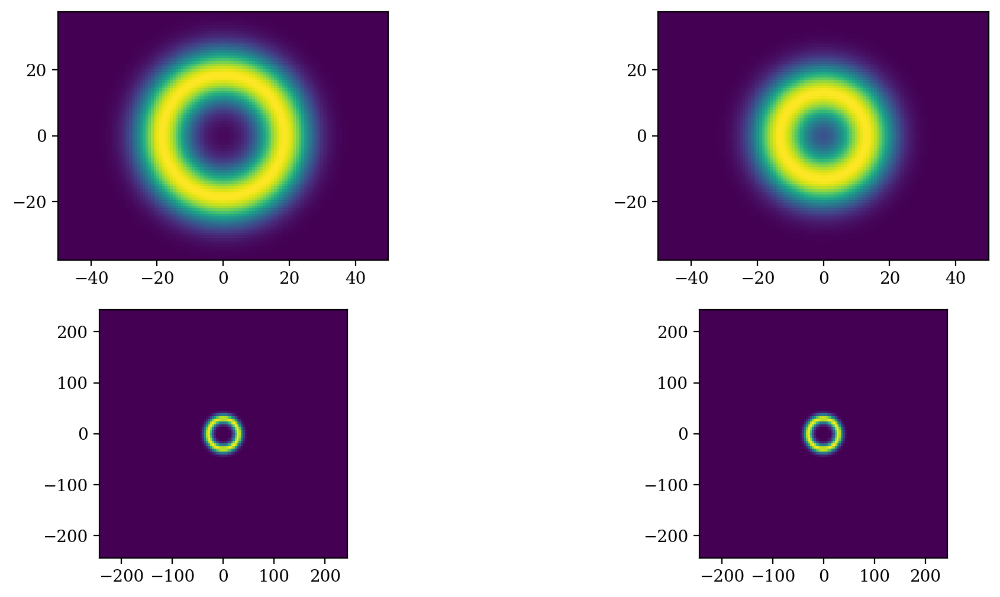

`psi = psi0ring_with_logging(dr=40,s3=3,s4=3,pt=2*hb*k,an=32)`
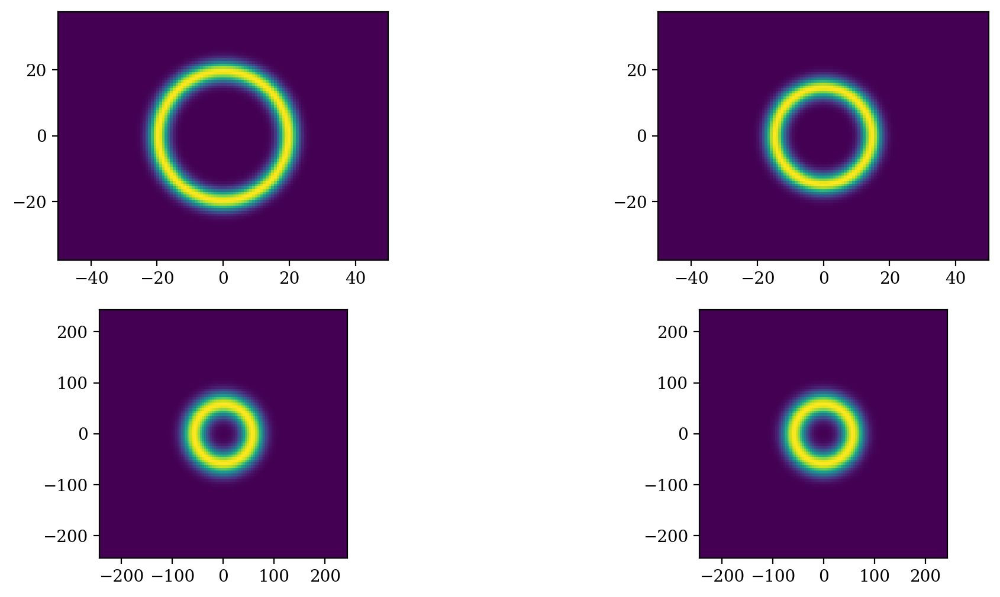

In [106]:
((nx-1)/2, (nz-1)/2)

(60.0, 45.0)

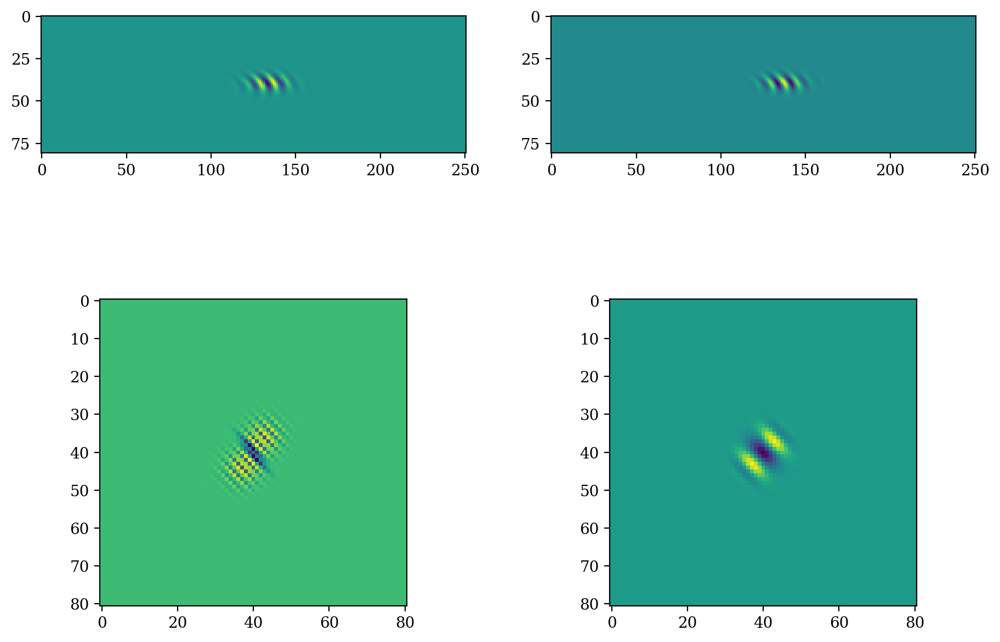

In [57]:
plt.figure(figsize=(11,8))
plt.subplot(2,2,1)
plt.imshow(np.real(psi[60,:,:,45]))
plt.subplot(2,2,2)
plt.imshow(np.real(psi[:,45,60,:].T))
plt.subplot(2,2,3)
plt.imshow(np.real(psi[60,:,60,:]))
plt.subplot(2,2,4)
plt.imshow(np.real(psi[30,:,90,:]))

no idea what those mean...

## Correlation Function

In [39]:
def gx3x4_calc(psi,cut=5.0):
    ind = abs(zlin) < (cut+1e-15)*dz
    gx3x4 = np.trapz(np.abs(psi[:,:,:,ind])**2,zlin[ind],axis=3)
    gx3x4 = np.trapz(gx3x4[:,ind,:],zlin[ind],axis=1)
    return gx3x4

In [40]:
def plot_gx3x4(gx3x4,cut):
    xip = xlin > 0
    xim = xlin < 0
    gpp = np.trapz(np.trapz(gx3x4[:,xip],xlin[xip],axis=1)[xip],xlin[xip],axis=0)
    gpm = np.trapz(np.trapz(gx3x4[:,xim],xlin[xim],axis=1)[xip],xlin[xip],axis=0)
    gmp = np.trapz(np.trapz(gx3x4[:,xip],xlin[xip],axis=1)[xim],xlin[xim],axis=0)
    gmm = np.trapz(np.trapz(gx3x4[:,xim],xlin[xim],axis=1)[xim],xlin[xim],axis=0)
    E = (gpp+gmm-gpm-gmp)/((gpp+gmm+gpm+gmp))
    
    plt.imshow(np.flipud(gx3x4.T),extent=[-xmax,xmax,-xmax,xmax])
    plt.title("$g^{(2)}_{\pm\pm}$ of $z_\mathrm{cut} = "+str(cut)+"dz$ and $E="+str(round(E,4))+"$")
    plt.xlabel("$x_3$")
    plt.ylabel("$x_4$")
    plt.axhline(y=0,color='white',alpha=0.8,linewidth=0.7)
    plt.axvline(x=0,color='white',alpha=0.8,linewidth=0.7)
    plt.text(+xmax*0.6,+xmax*0.8,"$g^{(2)}_{++}="+str(round(gpp,4))+"$", color='white',ha='center',alpha=0.9)
    plt.text(-xmax*0.6,+xmax*0.8,"$g^{(2)}_{-+}="+str(round(gmp,4))+"$", color='white',ha='center',alpha=0.9)
    plt.text(+xmax*0.6,-xmax*0.8,"$g^{(2)}_{+-}="+str(round(gpm,4))+"$", color='white',ha='center',alpha=0.9)
    plt.text(-xmax*0.6,-xmax*0.8,"$g^{(2)}_{--}="+str(round(gmm,4))+"$", color='white',ha='center',alpha=0.9)
    

In [74]:
def plot_gx3x4_phi(gx3x4,cut):
    xip = pxlin > 0
    xim = pxlin < 0
    gpp = np.trapz(np.trapz(gx3x4[:,xip],pxlin[xip],axis=1)[xip],pxlin[xip],axis=0)
    gpm = np.trapz(np.trapz(gx3x4[:,xim],pxlin[xim],axis=1)[xip],pxlin[xip],axis=0)
    gmp = np.trapz(np.trapz(gx3x4[:,xip],pxlin[xip],axis=1)[xim],pxlin[xim],axis=0)
    gmm = np.trapz(np.trapz(gx3x4[:,xim],pxlin[xim],axis=1)[xim],pxlin[xim],axis=0)
    E = (gpp+gmm-gpm-gmp)/((gpp+gmm+gpm+gmp))
    
    plt.imshow(np.flipud(gx3x4.T),extent=np.array([-pxmax,pxmax,-pxmax,pxmax])/(hb*k))
    plt.title("$g^{(2)}_{\pm\pm}$ of $z_\mathrm{cut} = "+str(cut)+"dz$ and $E="+str(round(E,4))+"$")
    plt.xlabel("$px_3$")
    plt.ylabel("$px_4$")
    plt.axhline(y=0,color='white',alpha=0.8,linewidth=0.7)
    plt.axvline(x=0,color='white',alpha=0.8,linewidth=0.7)
    xtext = pxmax/(hb*k)
    plt.text(+xtext*0.6,+xtext*0.8,"$g^{(2)}_{++}="+str(round(gpp,4))+"$", color='white',ha='center',alpha=0.9)
    plt.text(-xtext*0.6,+xtext*0.8,"$g^{(2)}_{-+}="+str(round(gmp,4))+"$", color='white',ha='center',alpha=0.9)
    plt.text(+xtext*0.6,-xtext*0.8,"$g^{(2)}_{+-}="+str(round(gpm,4))+"$", color='white',ha='center',alpha=0.9)
    plt.text(-xtext*0.6,-xtext*0.8,"$g^{(2)}_{--}="+str(round(gmm,4))+"$", color='white',ha='center',alpha=0.9)
    

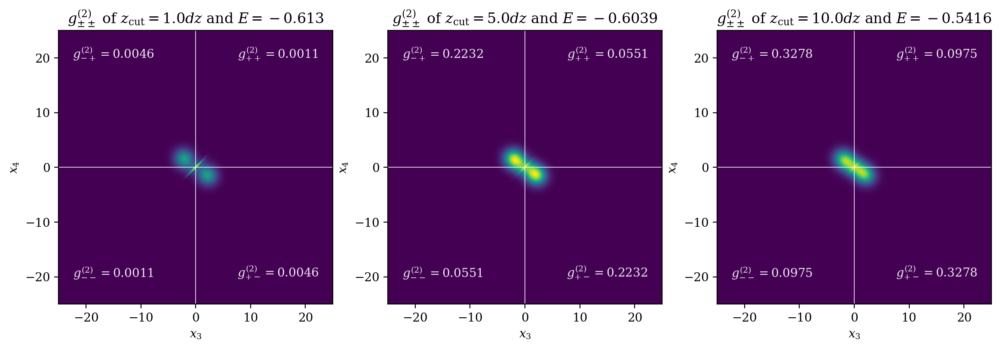

In [67]:
plt.figure(figsize=(14,6))

cut_list = [1.0, 5.0, 10.0]
for i in range(3):
    cut = cut_list[i]
    gx3x4 = gx3x4_calc(psi,cut=cut)
    plt.subplot(1,3,i+1)
    plot_gx3x4(gx3x4,cut)
plt.show()

 eq on p.73 GoodNotes document
 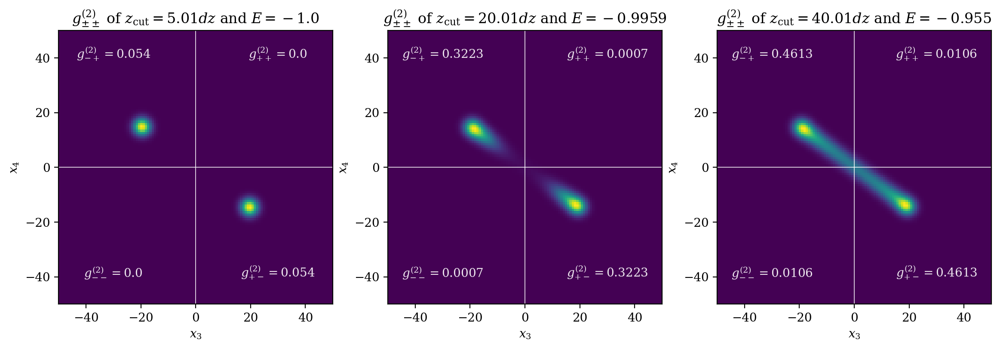

In [61]:
del gx3x4

## FFT to momentum

In [41]:
@jit(forceobj=True, cache=True)
def only3phi(phi):
    return np.trapz(np.trapz(np.abs(phi)**2,dx=dpz,axis=3),dx=dpx,axis=2)
#     return np.trapz(np.trapz(np.abs(phi)**2,dx=dpx,axis=2),dx=dpz,axis=2)
@jit(forceobj=True, cache=True)
def only4phi(phi):
    return np.trapz(np.trapz(np.abs(phi)**2,dx=dpx,axis=0),dx=dpz,axis=0)

@njit(cache=True)
def check_norm_phi(phi):
#     return np.trapz(np.trapz(np.trapz(np.trapz(np.abs(phi)**2,dx=dpz,axis=3),dx=dpx,axis=2),dx=dpz,axis=1),dx=dpx,axis=0)
    return np.trapz(np.trapz(np.trapz(np.trapz(np.abs(phi)**2))))*(dpx*dpx*dpz*dpz)



In [42]:
@jit(forceobj=True, cache=True)
def phiAndSWNF(psi, nthreads=nthreads):
    phiUN = np.flip(np.flip(np.fft.fftshift(pyfftw.interfaces.numpy_fft.fftn(psi,threads=nthreads,norm='ortho')),axis=1),axis=3)
    superWeirdNormalisationFactorSq = check_norm_phi(phiUN)
    swnf = sqrt(superWeirdNormalisationFactorSq)
    phi = phiUN/swnf
    return phi, (swnf+0*1j)

@jit(forceobj=True, cache=True)
def toPhi(psi, swnf, nthreads=nthreads) -> np.ndarray:
    return np.flip(np.flip(np.fft.fftshift(pyfftw.interfaces.numpy_fft.fftn(psi,threads=nthreads,norm='ortho')),axis=1),axis=3)/swnf

@jit(forceobj=True, cache=True)
def toPsi(phi, swnf, nthreads=nthreads) -> np.ndarray:
    return pyfftw.interfaces.numpy_fft.ifftn(np.fft.ifftshift(np.flip(np.flip(phi*swnf,axis=3),axis=1)),threads=nthreads,norm='ortho')




In [44]:
# # @njit(parallel=True,cache=True)
# @jit
# def phiAndSWNF(psi):
#     phiUN = np.flip(np.flip(np.fft.fftshift(np.fft.fftn(psi,norm='ortho')),axis=1),axis=3)
#     superWeirdNormalisationFactorSq = check_norm_phi(phiUN)
#     swnf = sqrt(superWeirdNormalisationFactorSq)
#     phi = phiUN/swnf
#     return phi, swnf

# @njit(parallel=True,cache=True)
# def toPhi(psi, swnf):
#     return np.flip(np.flip(np.fft.fftshift(np.fft.fftn(psi,norm='ortho')),axis=1),axis=3)/swnf

# @njit(parallel=True,cache=True)
# def toPsi(phi, swnf):
#     return np.fft.ifftn(np.fft.ifftshift(np.fliplr(phi*swnf)),norm='ortho')

In [47]:
del t, psi, phi, swnf

NameError: name 't' is not defined

## Scattering via contact potential ?

In [46]:
3*hb*k/m3

249.39454740706233

In [47]:
20/249/dt

160.6425702811245

In [47]:
# del psi_test

In [46]:
numba.set_num_threads(7)
# Each thread will multiply the memory usage!
# e.g. single thread 20GB -> 2 threads ~30GB

In [43]:
# a34 = 0.029 #µm
a34 = 0.5 #µm
strength34 = 1e5 # I don't know

In [45]:
-(1j/hb) * strength34 * np.exp(-((0-0)**2 +(0-0)**2)/(4*a34**2)) *0.5*dt

-0.3936524332444204j

In [44]:
@njit(parallel=True,cache=True)
# @njit
def scattering_evolve_loop_helper2_inner_psi_step(psi_init):
    psi = psi_init
    for iz3 in prange(nz):
        z3 = zlin[iz3]
#     for (iz3, z3) in enumerate(zlin):
        for (ix4, x4) in enumerate(xlin):
            for (iz4, z4) in enumerate(zlin):
                psi[:,iz3,ix4,iz4] *= np.exp(-(1j/hb) * # this one is unitary time evolution operator
                                        strength34 *
                                        np.exp(-((xlin-x4)**2 +(z3-z4)**2)/(4*a34**2))
                                               # inside the guassian contact potential
                                               *0.5*dt
                                            )
    return psi

@njit(parallel=True,cache=True)
# @njit
def scattering_evolve_loop_helper2_inner_phi_step(phi_init):
    phi = phi_init
    for iz3 in prange(nz):
        pz3 = pzlin[iz3]
#     for (iz3, pz3) in enumerate(pzlin):
        for (ix4, px4) in enumerate(pxlin):
            for (iz4, pz4) in enumerate(pzlin):
                phi[:,iz3,ix4,iz4] *= np.exp(-(1j/hb) * (0.5/m3) * (dt) * (pxlin**2 + pz3**2) \
                                               -(1j/hb) * (0.5/m4) * (dt) * (  px4**2 + pz4**2))
    return phi

# @jit(nogil=True, parallel=True, forceobj=True)
@jit(nogil=True, forceobj=True)
# @njit(nogil=True, parallel=True)
def scattering_evolve_loop_helper2(t_init, psi_init, swnf, steps=20, progress_proxy=None):
    t = t_init
    psi = psi_init
    for ia in prange(steps):
        
        psi = scattering_evolve_loop_helper2_inner_psi_step(psi)
#         phi = np.zeros_like(psi, dtype=dtype)
#         with objmode(phi='complex128[:,:,:,:]'):
        phi = toPhi(psi, swnf, nthreads=7)
        phi = scattering_evolve_loop_helper2_inner_phi_step(phi)
        #del psi 
        # might cause memory issues
#         psi2 = np.zeros_like(phi, dtype=dtype)
#         with objmode(psi2='complex128[:,:,:,:]'):
        psi = toPsi(phi, swnf, nthreads=7)
#         psi = psi2
        psi = scattering_evolve_loop_helper2_inner_psi_step(psi)
        t += dt 
        if progress_proxy != None:
            progress_proxy.update(1)                                   
    return (t, psi, phi)

In [45]:
gc.collect()
su = 1.7
se = 5
print("want to stop at t =", (0.5*se+5)/v3)
print("number of steps is ", (0.5*se+5)/v3/dt)

print_every = 2
frames_count = 90
total_steps = print_every * frames_count
print("Total steps =" ,total_steps)
print("t_final =", total_steps*dt)

want to stop at t = 0.09021849207984266
number of steps is  180.43698415968532
Total steps = 180
t_final = 0.09


In [56]:
psi = psi0_just_opposite(dr=se,s3=su,s4=su,pt=-2*hb*k,a=0.5*pi)
t = 0
f = 0
phi, swnf = phiAndSWNF(psi, nthreads=7)

tested on A2485
```
%timeit _ = phiAndSWNF(psi,nthreads=1)
28.2 s ± 161 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)

%timeit _ = phiAndSWNF(psi,nthreads=2)
21.1 s ± 352 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)

%timeit _ = phiAndSWNF(psi,nthreads=3)
18.8 s ± 827 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)

%timeit _ = phiAndSWNF(psi,nthreads=4)
17.2 s ± 216 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)

%timeit _ = phiAndSWNF(psi,nthreads=5)
16.6 s ± 249 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)

%timeit _ = phiAndSWNF(psi,nthreads=6)
12.9 s ± 1.51 s per loop (mean ± std. dev. of 7 runs, 1 loop each)

%timeit _ = phiAndSWNF(psi,nthreads=7)
11.9 s ± 164 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)

%timeit _ = phiAndSWNF(psi,nthreads=8)
11.8 s ± 114 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)

```

In [46]:
def scattering_evolve_loop_plot(t,f,psi,phi, 
                                plt_show=True, plt_save=False, 
                                plt_save_func_name="scattering_evolve_loop_plot"):
    t_str = f"{t:.5f}"
    if plt_show:
        print("t = " +t_str+ " \t\t frame =", f, "\t\t memory used: " + 
              str(round(current_py_memory()/1000**2,3)) + "MB  ")

    fig = plt.figure(figsize=(12,7))
    plt.subplot(2,2,1)
    plt.imshow(np.flipud(only3(psi).T), extent=[-xmax,xmax,-zmax, zmax])
    plt.xlabel("$x \ (\mu m)$")
    plt.ylabel("$z \ (\mu m)$")
    plt.title("$t="+t_str+" \ ms $")

    plt.subplot(2,2,2)
    plt.imshow(np.flipud(only4(psi).T), extent=[-xmax,xmax,-zmax, zmax])
    plt.xlabel("$x \ (\mu m)$")
    plt.ylabel("$z \ (\mu m)$")

    plt.subplot(2,2,3)
    plt.imshow((only3phi(phi).T), extent=np.array([-pxmax,pxmax,-pzmax,pzmax])/(hb*k))
    # plt.colorbar()
    plt.xlabel("$p_x \ (\hbar k)$")
    plt.ylabel("$p_z \ (\hbar k)$")

    plt.subplot(2,2,4)
    plt.imshow((only4phi(phi).T), extent=np.array([-pxmax,pxmax,-pzmax,pzmax])/(hb*k))
    # plt.colorbar()
    plt.xlabel("$p_x \ (\hbar k)$")
    plt.xlabel("$p_x \ (\hbar k)$")

    if plt_save:
        title= output_prefix_bracket + " "+plt_save_func_name+" (f="+str(f)+",t="+t_str+")" 
        plt.savefig("output/"+title+".pdf", dpi=600)
        plt.savefig("output/"+title+".png", dpi=600)
    
    if plt_show: plt.show() 
    else:        plt.close(fig) 

In [59]:
scattering_evolve_loop_plot(t,f,psi,phi, plt_show=False, plt_save=False)

In [ ]:
with ProgressBar(total=total_steps) as progressbar:
    for f in range(frames_count):
        scattering_evolve_loop_plot(t,f,psi,phi, plt_show=True, plt_save=True)
        gc.collect()
        (t,psi,phi) = scattering_evolve_loop_helper2(t,psi,swnf,steps=print_every,progress_proxy=progressbar)
scattering_evolve_loop_plot(t,f+1,psi,phi, plt_show=True, plt_save=True)

In [47]:
import glob
import contextlib
import PIL

In [52]:
# https://stackoverflow.com/a/57751793/8798606
# filepaths
fp_in  = "/Users/tonyyan/Documents/_ANU/_Mass-Entanglement/bell correlations/simulations/output/(20230211-114917-F) scattering/*.png"
fp_out = "/Users/tonyyan/Documents/_ANU/_Mass-Entanglement/bell correlations/simulations/output/(20230211-114917-F) scattering/animated.gif"


In [90]:
# use exit stack to automatically close opened images
with contextlib.ExitStack() as stack:

    # lazily load images
    imgs = (stack.enter_context(PIL.Image.open(f)) for f in sorted(glob.glob(fp_in)))

    # extract  first image from iterator
    img = next(imgs)

    # https://pillow.readthedocs.io/en/stable/handbook/image-file-formats.html#gif
    img.save(fp=fp_out, format='GIF', append_images=imgs,
             save_all=True, duration=50, loop=0)

In [ ]:
with ProgressBar(total=total_steps) as progressbar:
    for f in range(frames_count):
        scattering_evolve_loop_plot()
        (t,psi,phi) = scattering_evolve_loop_helper(t,psi,swnf,steps=print_every,progress_proxy=progressbar)
scattering_evolve_loop_plot()

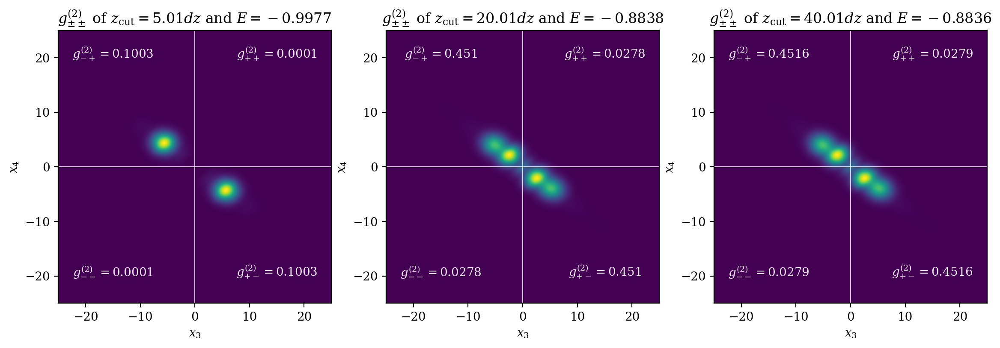

In [91]:
plt.figure(figsize=(14,6))

cut_list = [5.01, 20.01, 40.01]
for i in range(3):
    cut = cut_list[i]
    gx3x4 = gx3x4_calc(psi,cut=cut)
    plt.subplot(1,3,i+1)
    plot_gx3x4(gx3x4,cut)
plt.show()


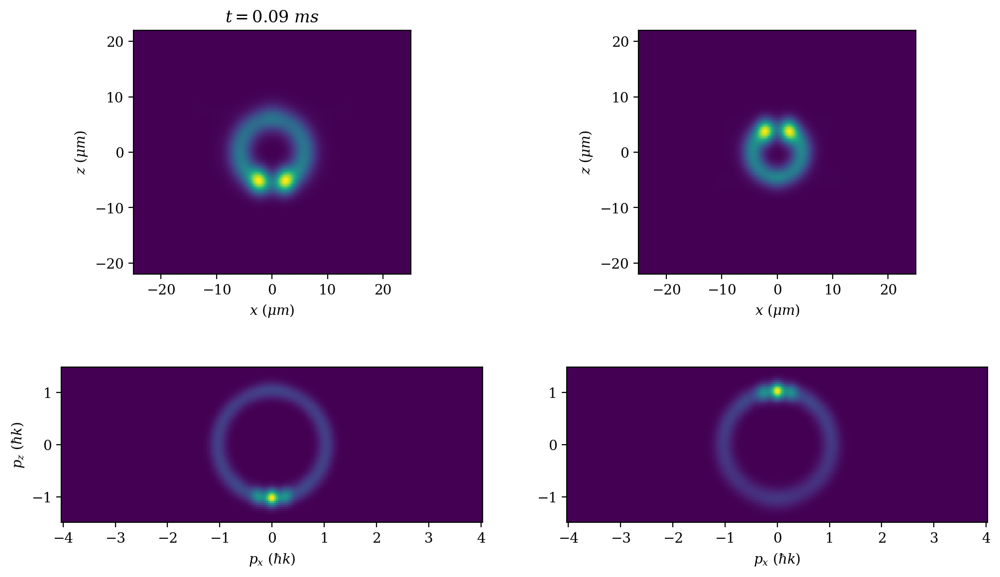

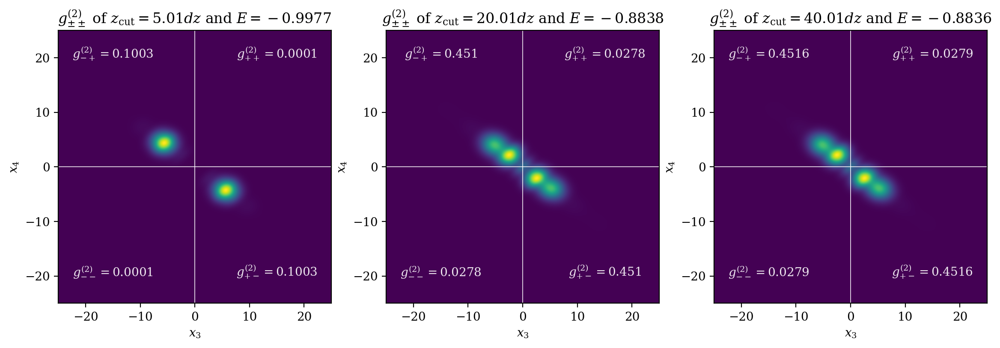

In [53]:
assert False, "Catch auto runs"

AssertionError: Catch auto runs

In [52]:
t= total_steps*dt

## Bragg Time Evolution Operator

### old code

Notes

`V0FArg=1*V0F, phase=0, doppd=-10*dopd` doesn't quite work with `tauPi = 0.0039`

`V0FArg=2*V0F, phase=0, doppd=-10*dopd` worked ish

`V0FArg=3*V0F, phase=0, doppd=-10*dopd` worked

`V0FArg=4*V0F, phase=0, doppd=-10*dopd` worked

`V0FArg=10*V0F, phase=0, doppd=-10*dopd` might be too fast

The problem with these are they don't have transfers

then I realised I set the doppler frequency different incorrectly ....

### New Code

In [50]:
abs(t - total_steps * dt) < 0.00000001

True

In [51]:
tau4Pi1  = 9.3*0.001
tau4Mid1 = tau4Pi1*5
tau4End1 = tau4Pi1*10

tau4Pi2  = 5.2*0.001
tau4Mid2 = tau4Pi2*5
tau4End2 = tau4Pi2*10

# tau3Pi1  = 9.0*0.001
tau3Pi1  = tau4Pi1
tau3Mid1 = tau3Pi1*5
tau3End1 = tau3Pi1*10

# tau3Pi2  = 5.3*0.001
tau3Pi2  = tau4Pi2
tau3Mid2 = tau3Pi2*5
tau3End2 = tau3Pi2*10


tMirMid = t + max(tau4Mid1, tau3Mid1)
tMirEnd = t + max(tau4End1, tau3End1)


tMix = 0.165
phase0 = 1.54
phasePi = 1.54*3+0.09
phasePi2 = 0
phasePi4 = 1.54*0.25+0.13

# tauMixBeg = tMix - tau4Pi2*5
# tauMixMid = tMix
# tauMixEnd = tMix + tau4Pi2*5

In [52]:
print(f"tMirMid = {round(tMirMid,8)}")
print(f"tMirEnd = {round(tMirEnd,8)}")
stepsBragg = int((tMirEnd-t)/dt)
print(f"stepsBragg = {round((tMirEnd-t)/dt,8)} -> (to int: {stepsBragg})")
frames_count_bragg = stepsBragg // print_every
print(f"frames_count_bragg = {round(stepsBragg / print_every,8)} -> (to int: {frames_count_bragg})")

tMirMid = 0.1365
tMirEnd = 0.183
stepsBragg = 186.0 -> (to int: 186)
frames_count_bragg = 93.0 -> (to int: 93)


In [53]:
VBF(t+tau4Mid1,tMirMid, tau4Pi1, V0F)

19947.114020071636

In [54]:
@njit(parallel=True,cache=True)
def bragg_evolve_helper_psi_step(t,psi_init,tw3,tc3,tw4,tc4,ph3,ph4,V3,V4,dop3,dop4):
    psi = psi_init
    cosX3Lin = np.exp(-(1j/hb) * 0.5*dt * VBF(t,tc3,tw3,V3) * \
                        np.cos(2*k*xlin + dop3*(t-tc3) + ph3) )
    cosX4Lin = np.exp(-(1j/hb) * 0.5*dt * VBF(t,tc4,tw4,V4) * \
                        np.cos(2*k*xlin + dop4*(t-tc4) + ph4) )
    for iz3 in prange(nz):
        z3 = zlin[iz3]
        for (ix4, x4) in enumerate(xlin):
            for (iz4, z4) in enumerate(zlin):
                psi[:,iz3,ix4,iz4] *= cosX3Lin
    for ix3 in prange(nx):
        x3 = xlin[ix3]
        for (iz3, z3) in enumerate(zlin):
            for (iz4, z4) in enumerate(zlin):
                psi[ix3,iz3,:,iz4] *= cosX4Lin
    return psi

@jit(nogil=True, forceobj=True)
def bragg_evolve_helper_step(t_init,psi_init,tw3,tc3,tw4,tc4,ph3,ph4,V3,V4,dop3,dop4,
                             swnf,steps,
                             progress_proxy=None):
    t = t_init
    psi = psi_init
    for ia in prange(steps):
        psi = bragg_evolve_helper_psi_step(t,psi,tw3,tc3,tw4,tc4,ph3,ph4,V3,V4,dop3,dop4)
        phi = toPhi(psi,swnf,nthreads=7)
        phi = scattering_evolve_loop_helper2_inner_phi_step(phi)
        psi = toPsi(phi,swnf,nthreads=7)
        psi = bragg_evolve_helper_psi_step(t,psi,tw3,tc3,tw4,tc4,ph3,ph4,V3,V4,dop3,dop4)
        t+=dt
        if progress_proxy != None: progress_proxy.update(1)
    return (t,psi,phi)

  0%|                                                                                                         …

t = 0.09000 		 frame = 0 		 memory used: 13844.152MB  


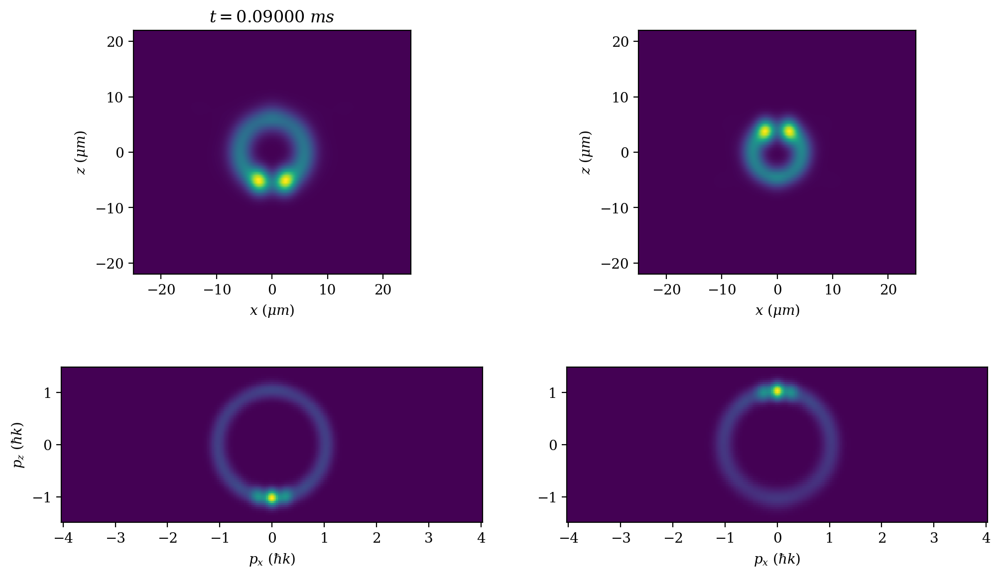

t = 0.09100 		 frame = 1 		 memory used: 6886.441MB  


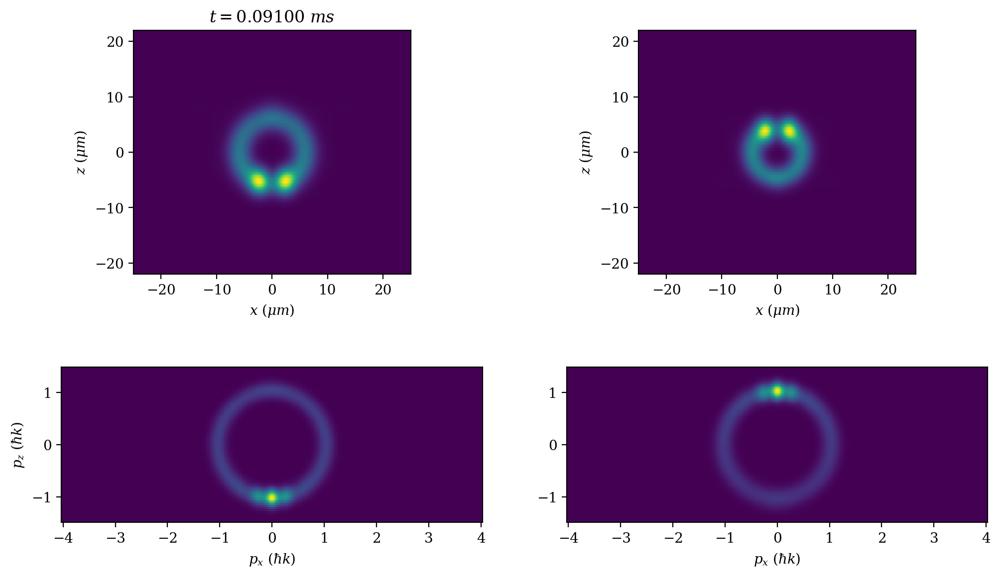

t = 0.09200 		 frame = 2 		 memory used: 14037.729MB  


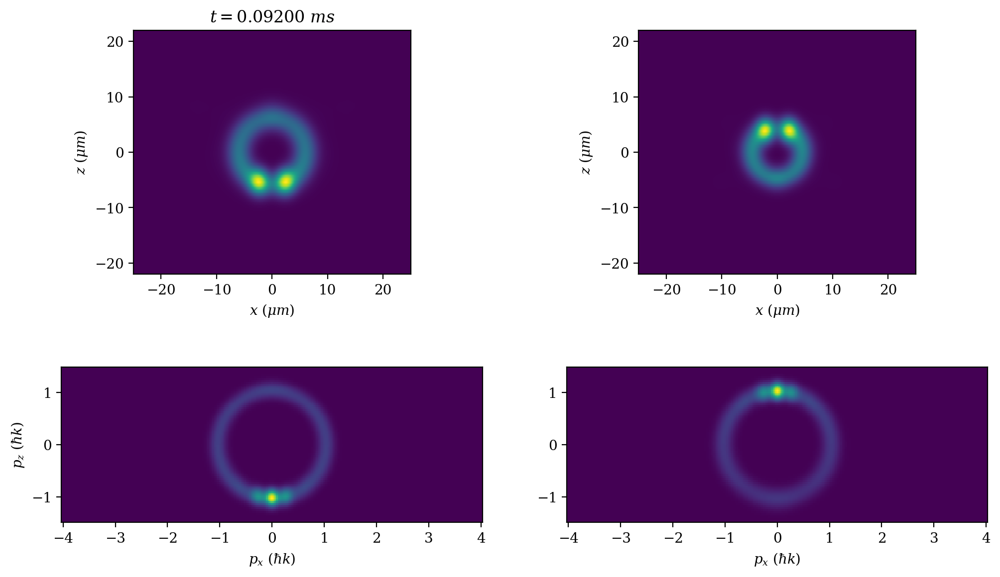

t = 0.09300 		 frame = 3 		 memory used: 14087.799MB  


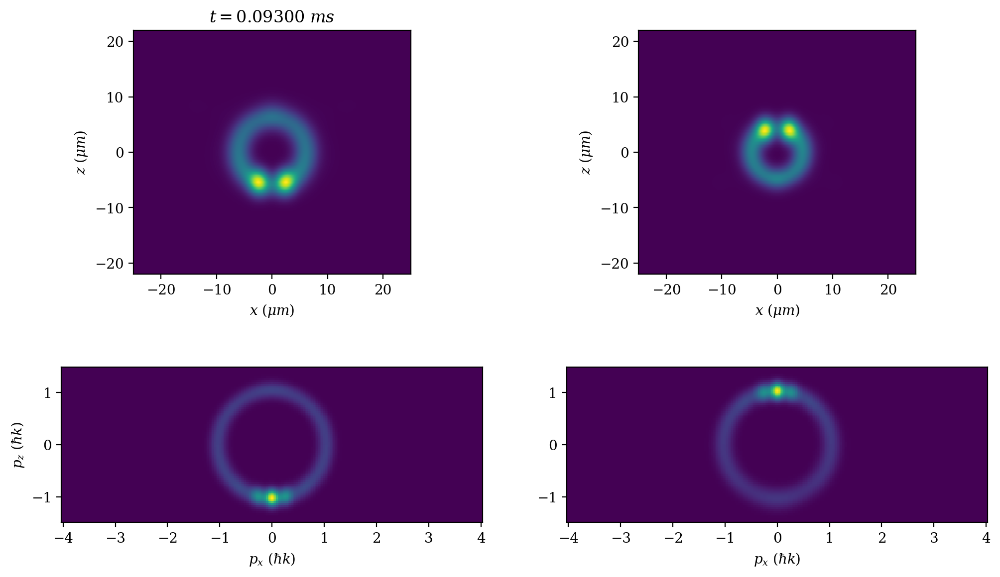

t = 0.09400 		 frame = 4 		 memory used: 14110.278MB  


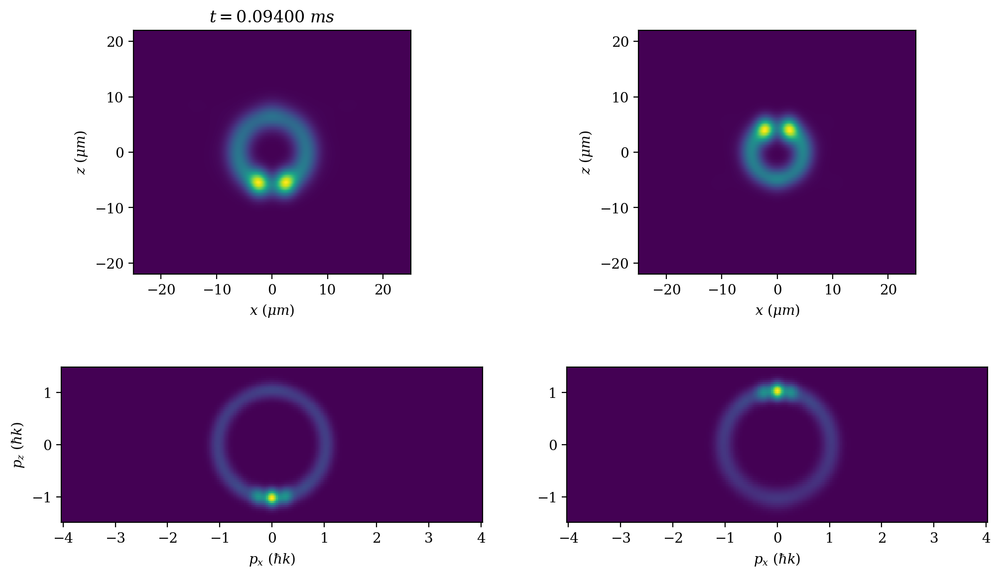

t = 0.09500 		 frame = 5 		 memory used: 14115.357MB  


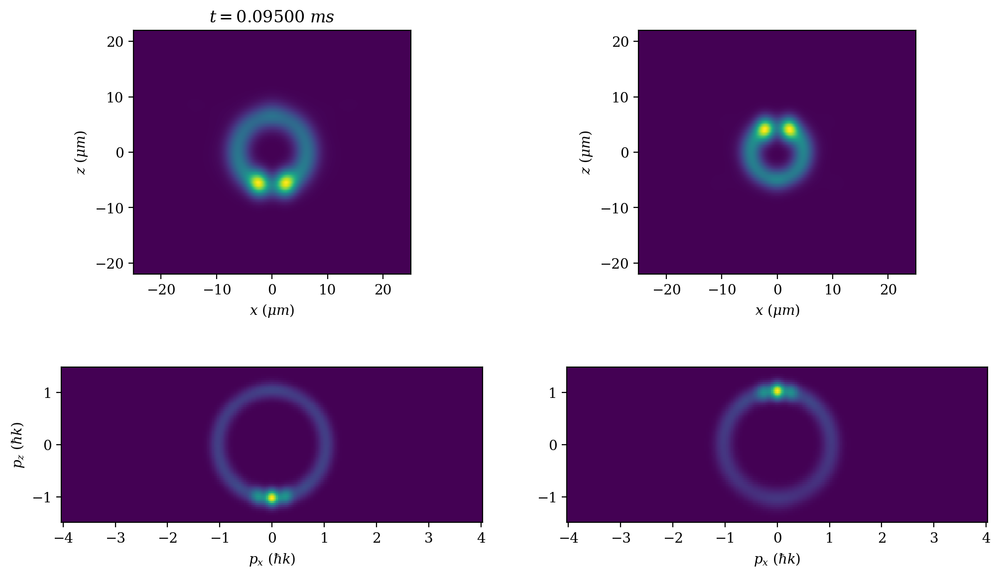

t = 0.09600 		 frame = 6 		 memory used: 14115.734MB  


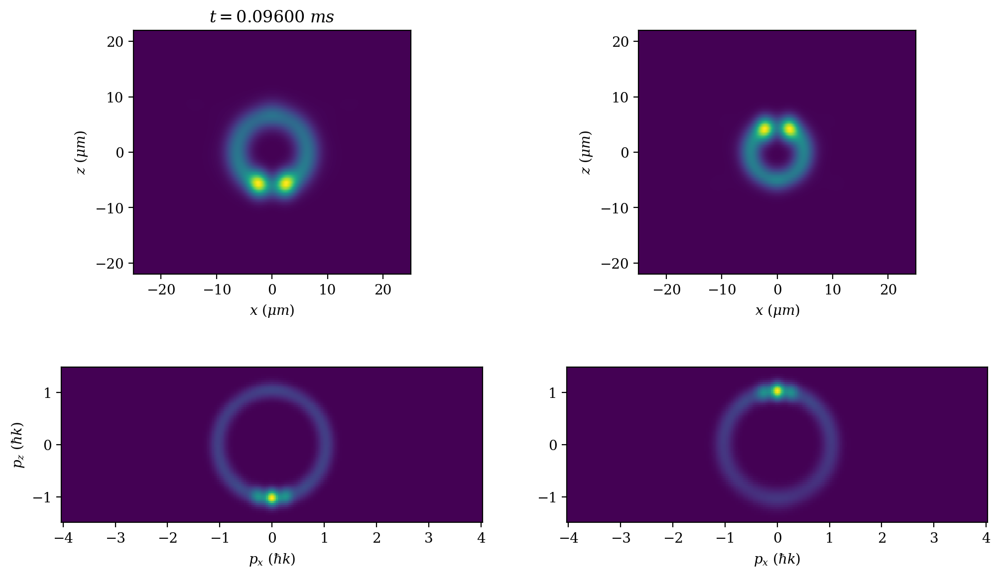

t = 0.09700 		 frame = 7 		 memory used: 14116.143MB  


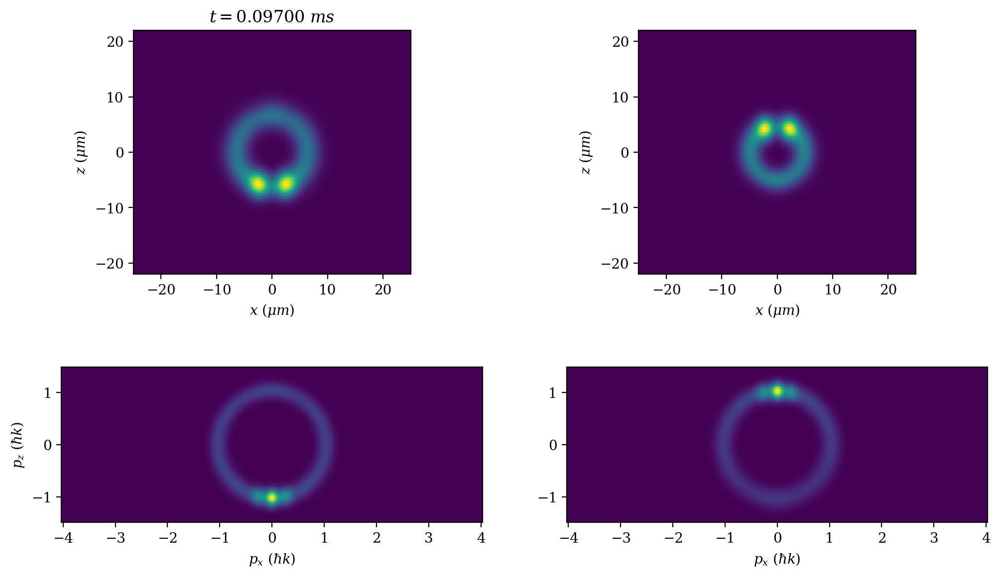

t = 0.09800 		 frame = 8 		 memory used: 6892.732MB  


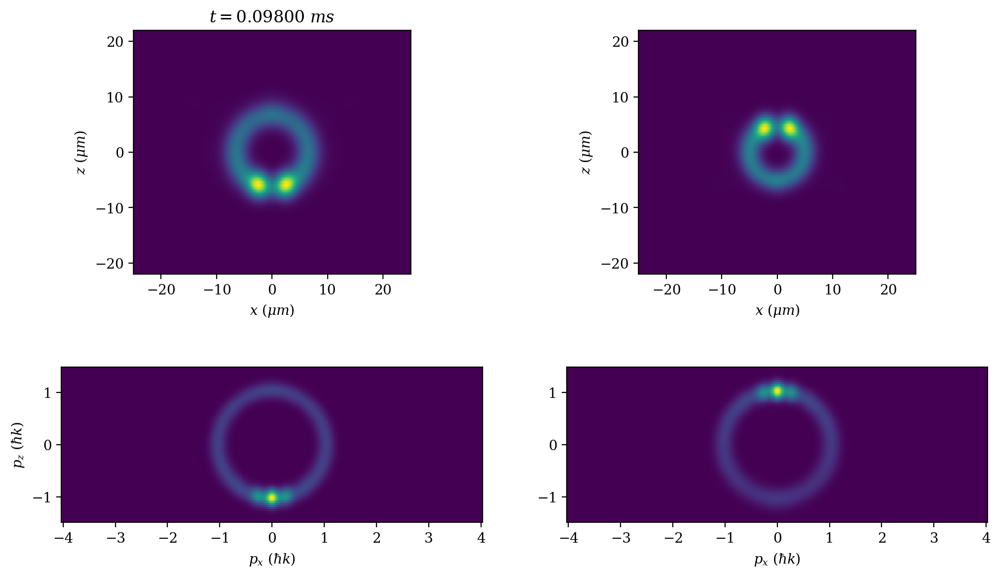

t = 0.09900 		 frame = 9 		 memory used: 9525.756MB  


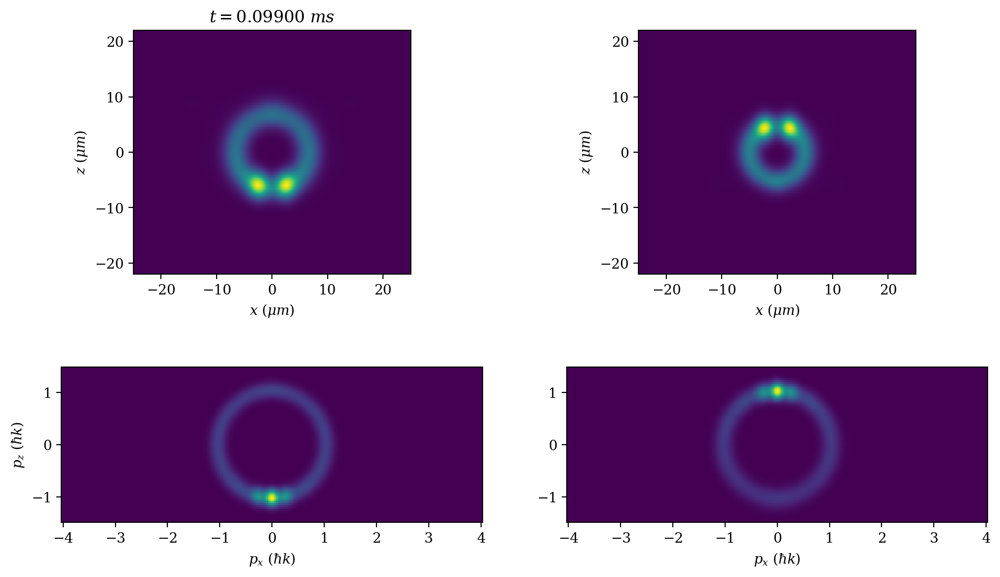

t = 0.10000 		 frame = 10 		 memory used: 7244.218MB  


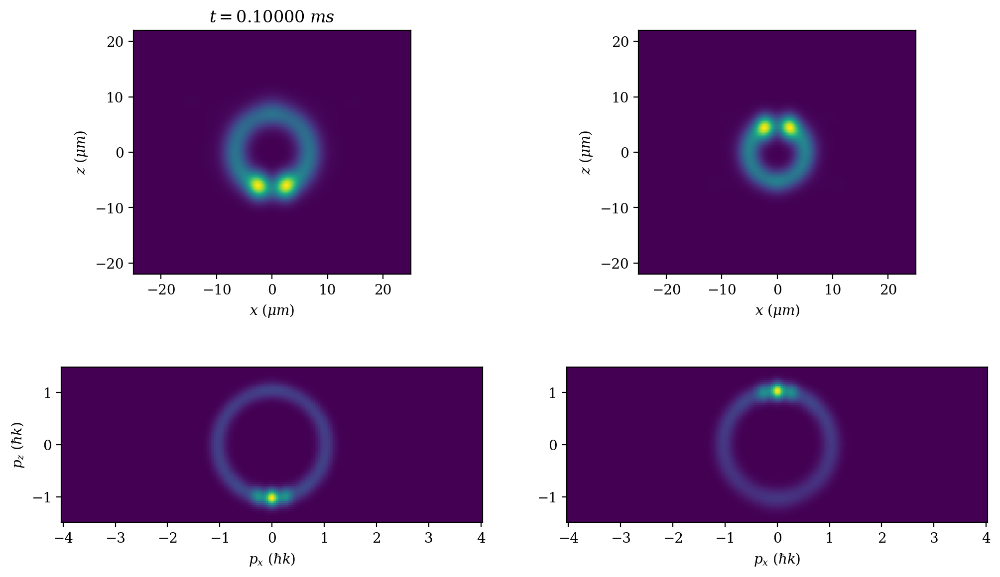

t = 0.10100 		 frame = 11 		 memory used: 6886.851MB  


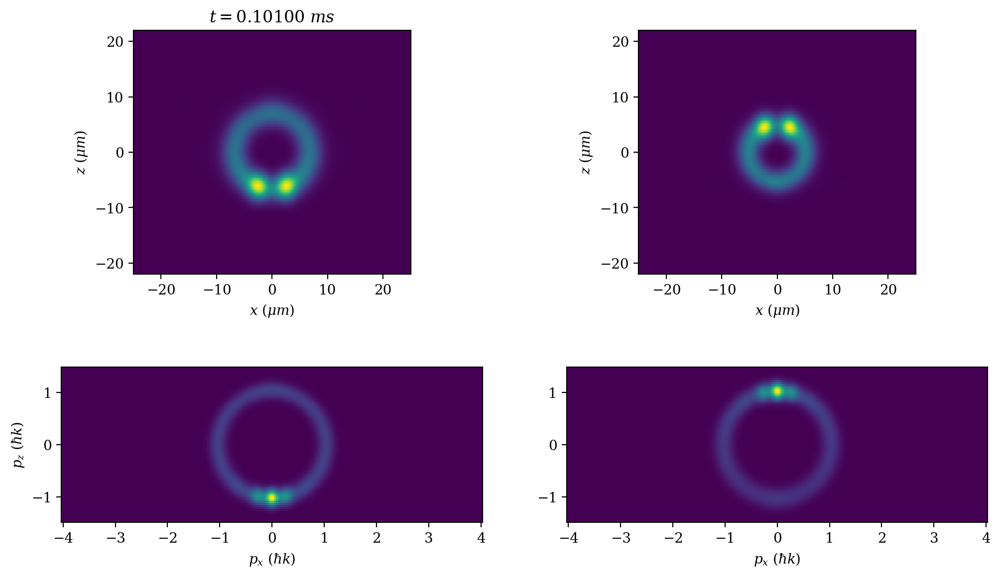

t = 0.10200 		 frame = 12 		 memory used: 9152.528MB  


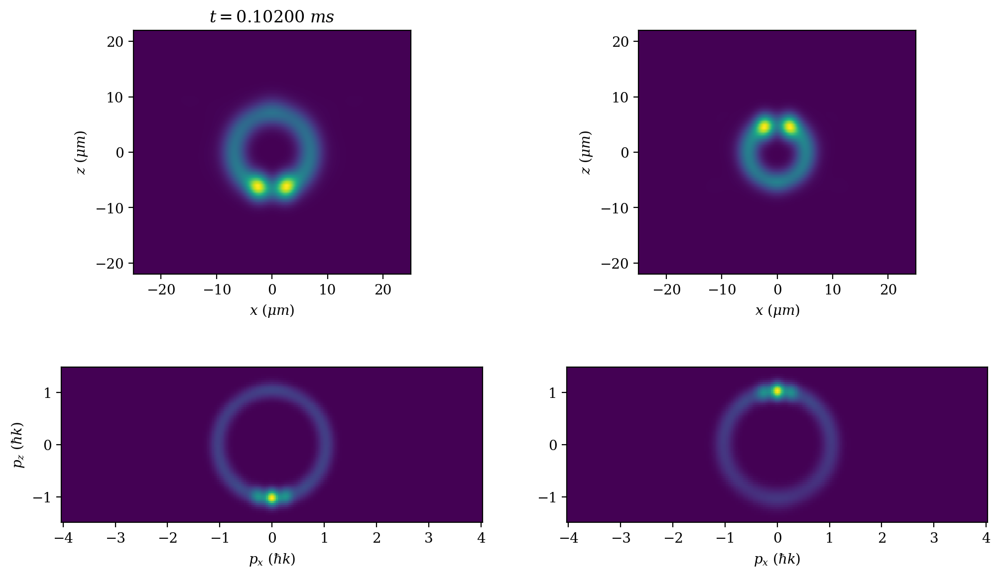

t = 0.10300 		 frame = 13 		 memory used: 6894.567MB  


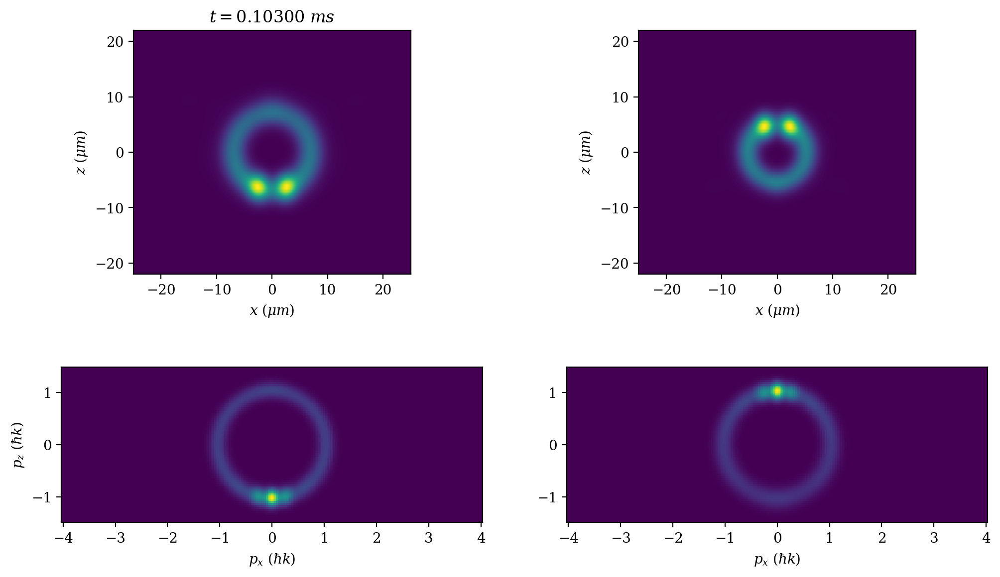

t = 0.10400 		 frame = 14 		 memory used: 7033.176MB  


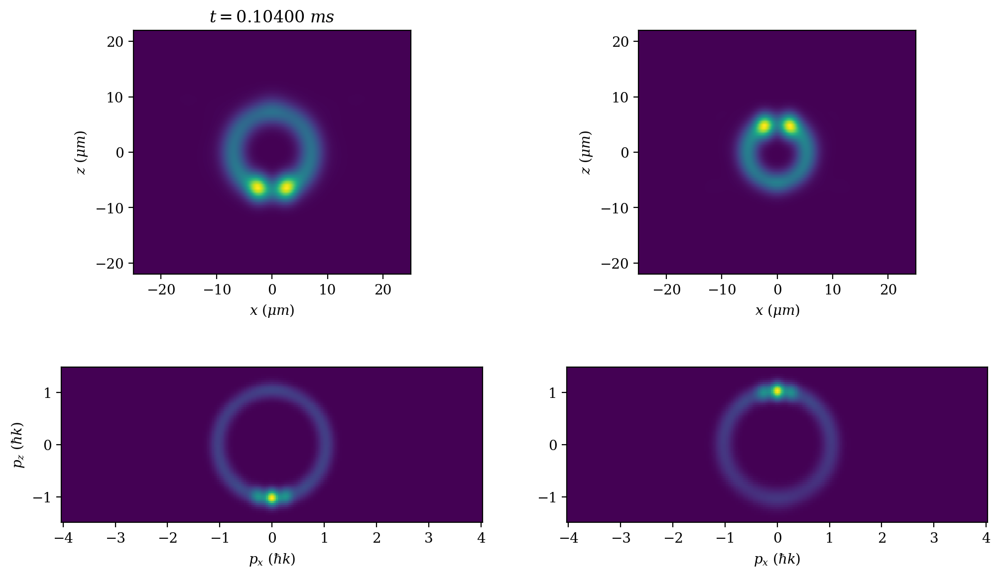

t = 0.10500 		 frame = 15 		 memory used: 9453.535MB  


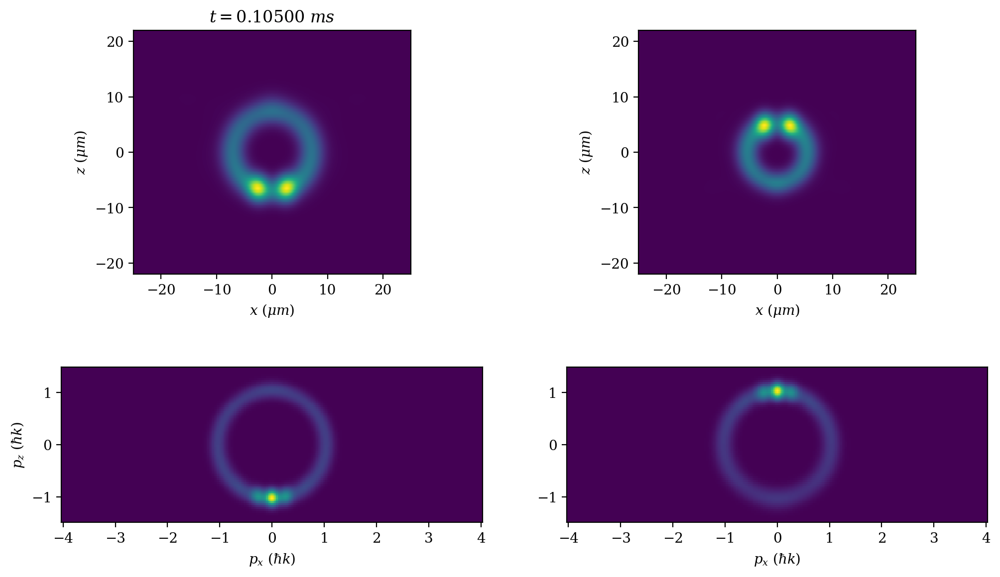

t = 0.10600 		 frame = 16 		 memory used: 9547.825MB  


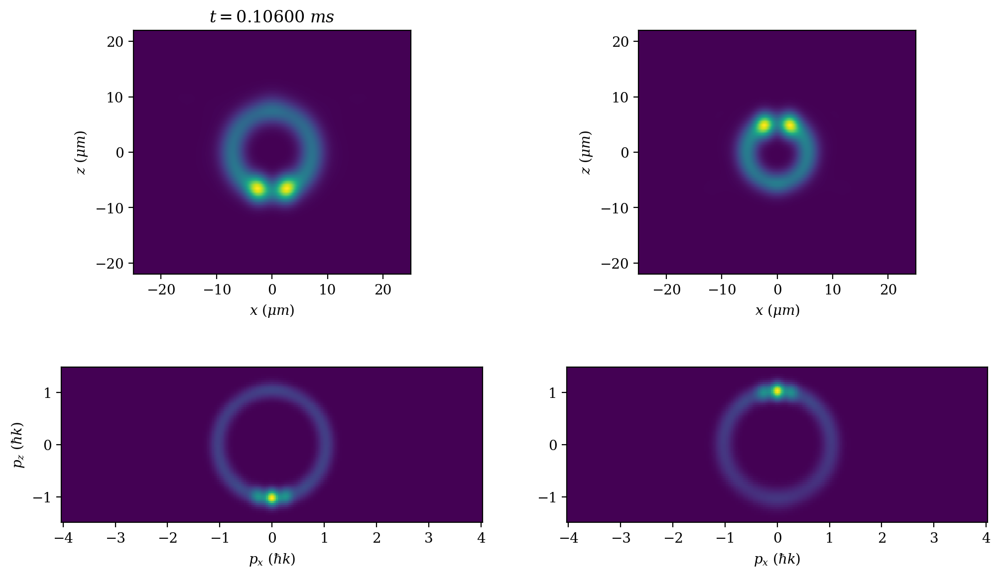

t = 0.10700 		 frame = 17 		 memory used: 6988.628MB  


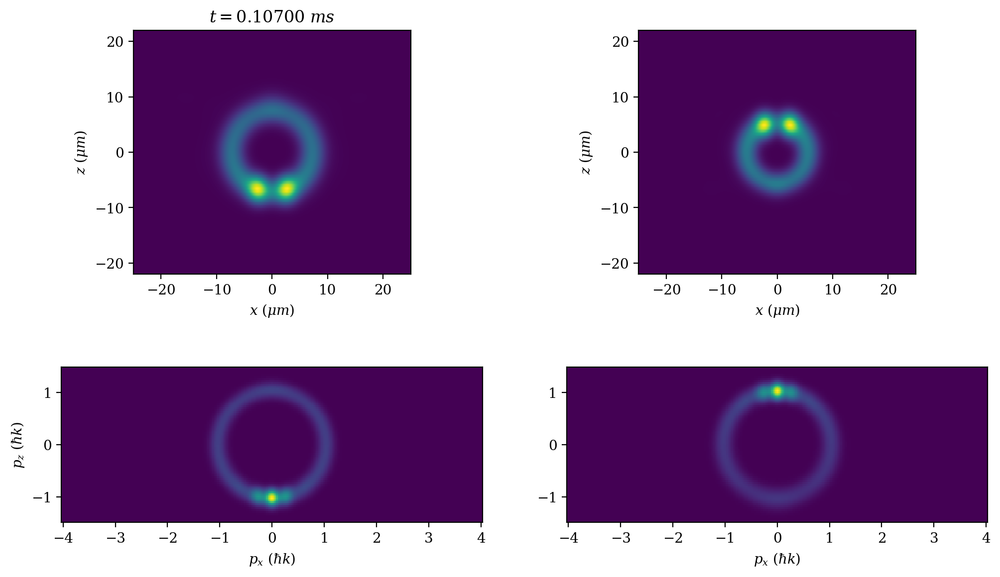

t = 0.10800 		 frame = 18 		 memory used: 6810.403MB  


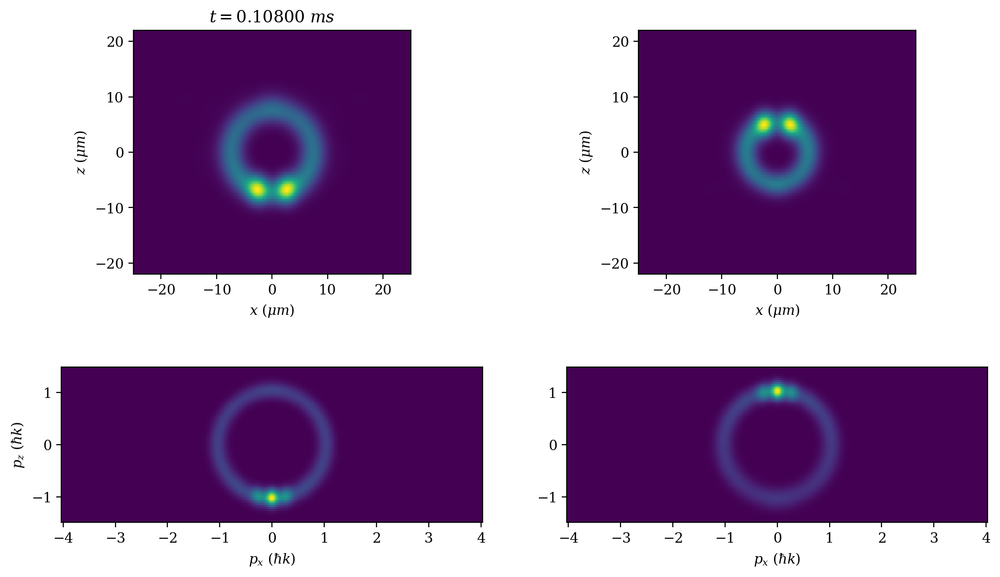

t = 0.10900 		 frame = 19 		 memory used: 13969.621MB  


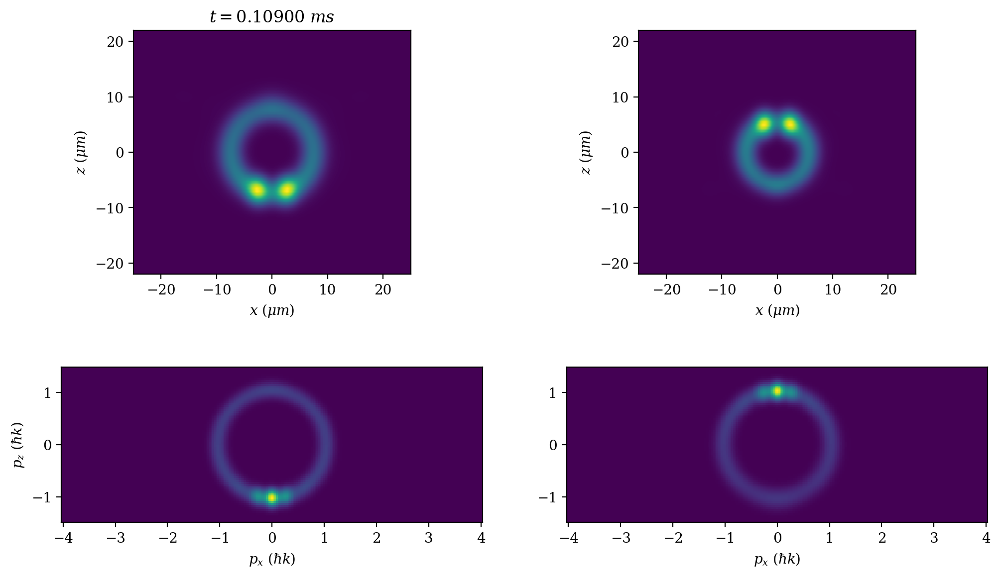

t = 0.11000 		 frame = 20 		 memory used: 13971.997MB  


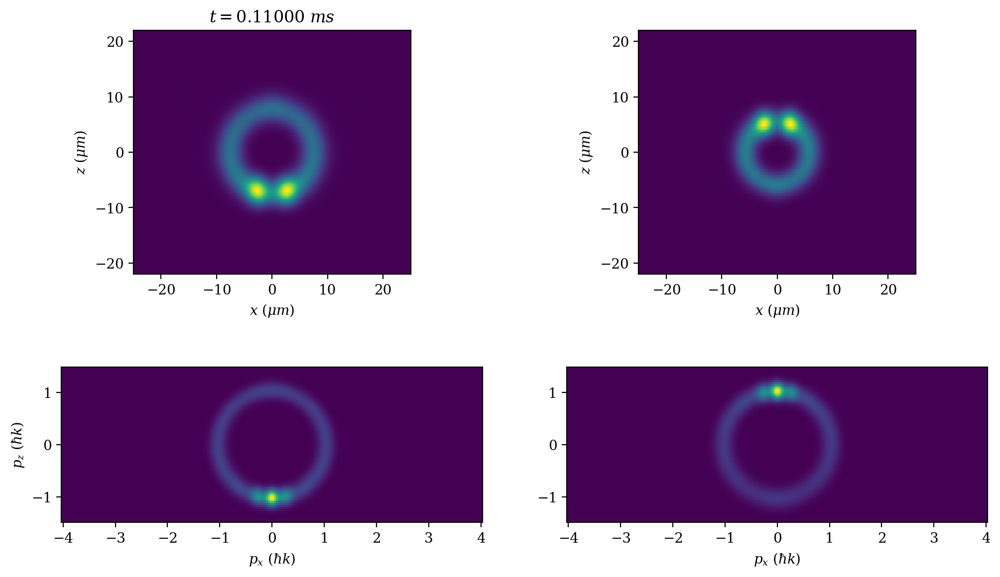

t = 0.11100 		 frame = 21 		 memory used: 13992.182MB  


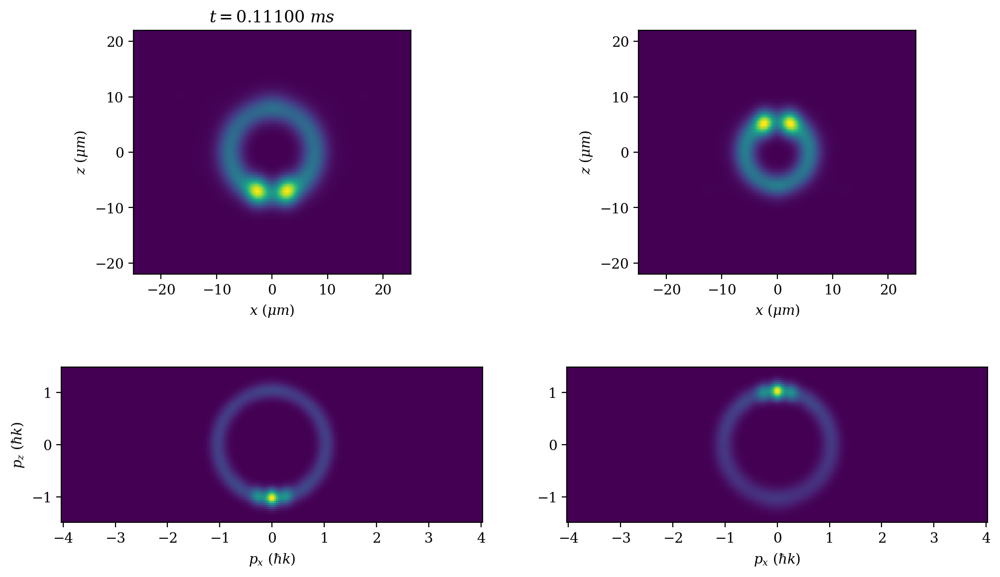

t = 0.11200 		 frame = 22 		 memory used: 13994.525MB  


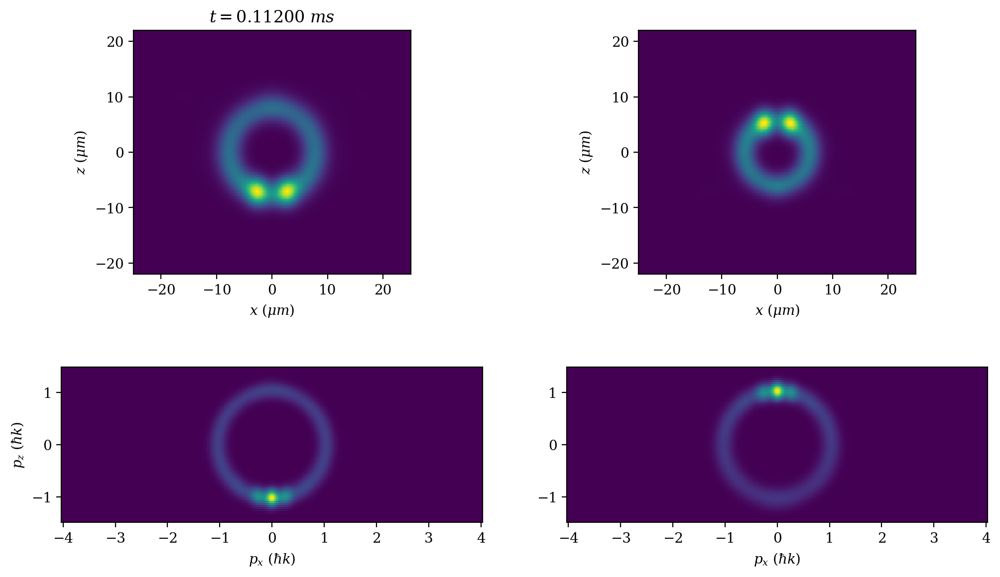

t = 0.11300 		 frame = 23 		 memory used: 13997.425MB  


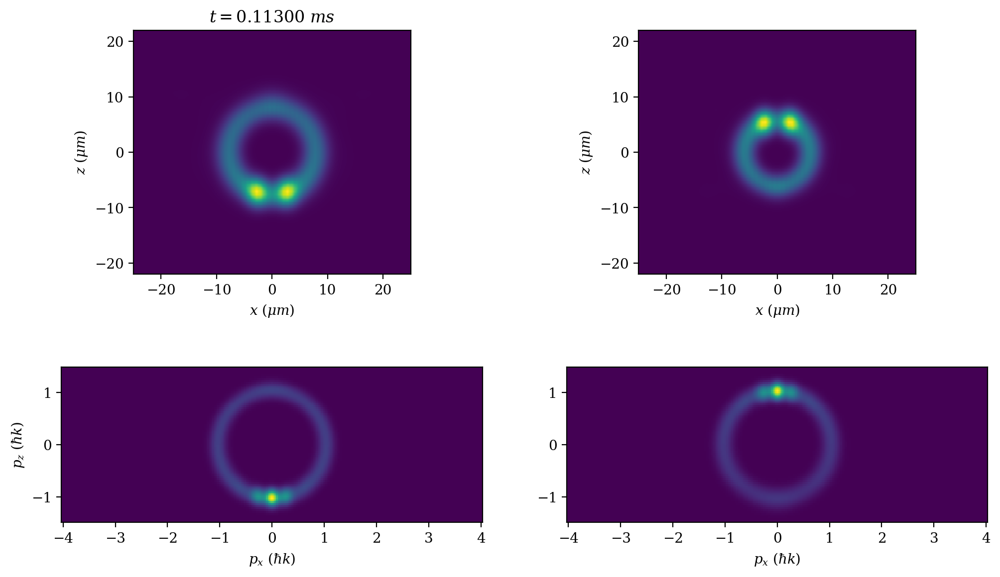

t = 0.11400 		 frame = 24 		 memory used: 14001.75MB  


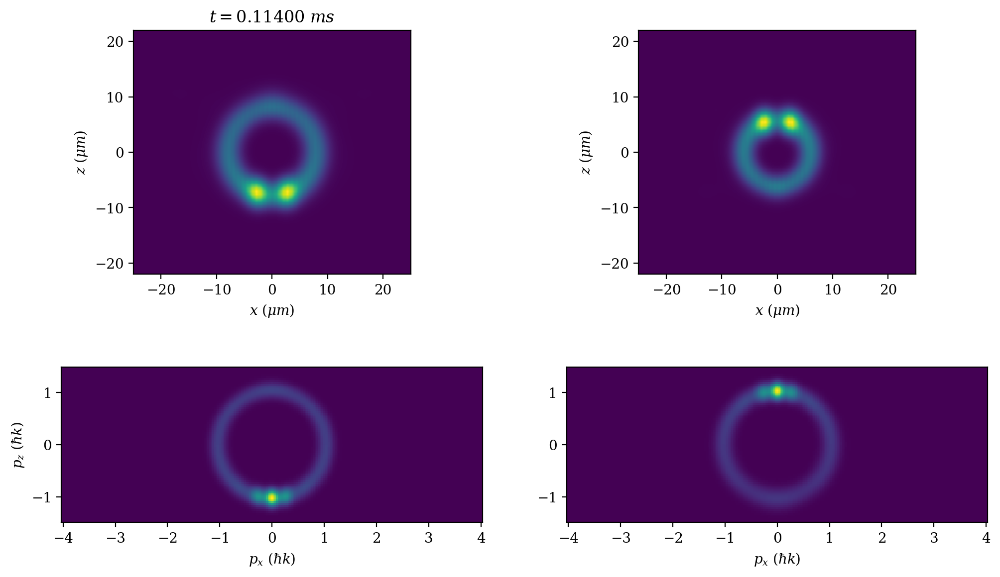

t = 0.11500 		 frame = 25 		 memory used: 14002.258MB  


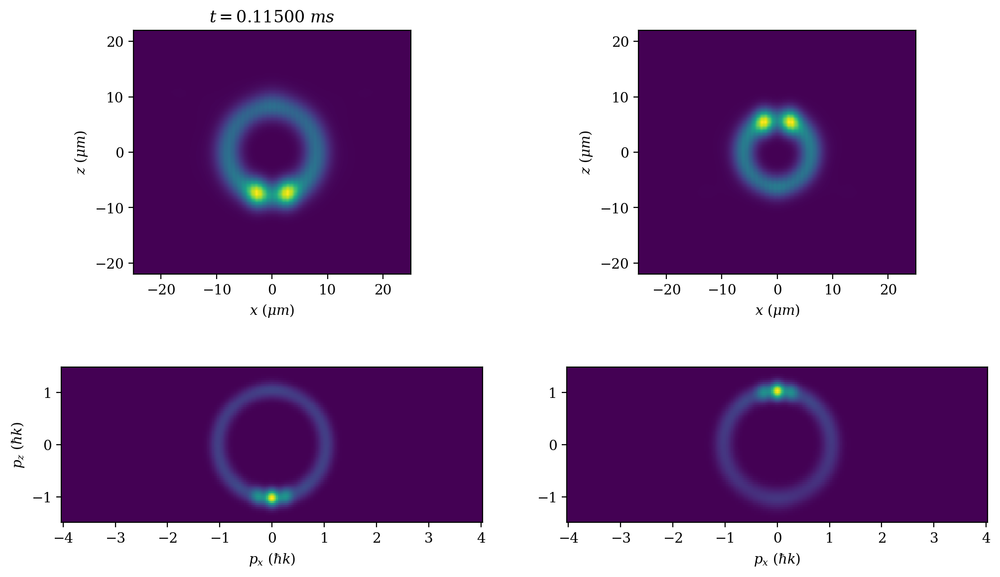

t = 0.11600 		 frame = 26 		 memory used: 13738.59MB  


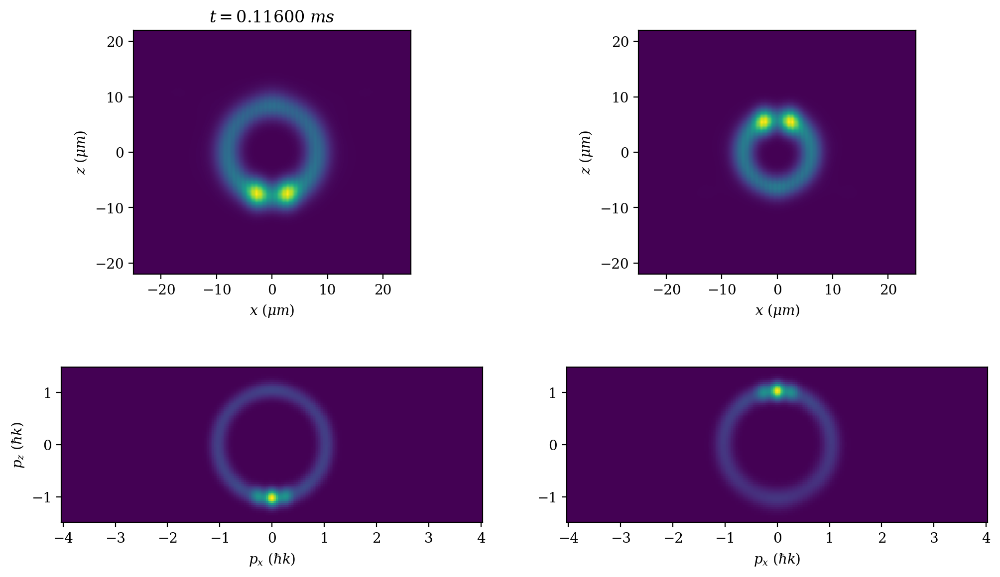

t = 0.11700 		 frame = 27 		 memory used: 13988.643MB  


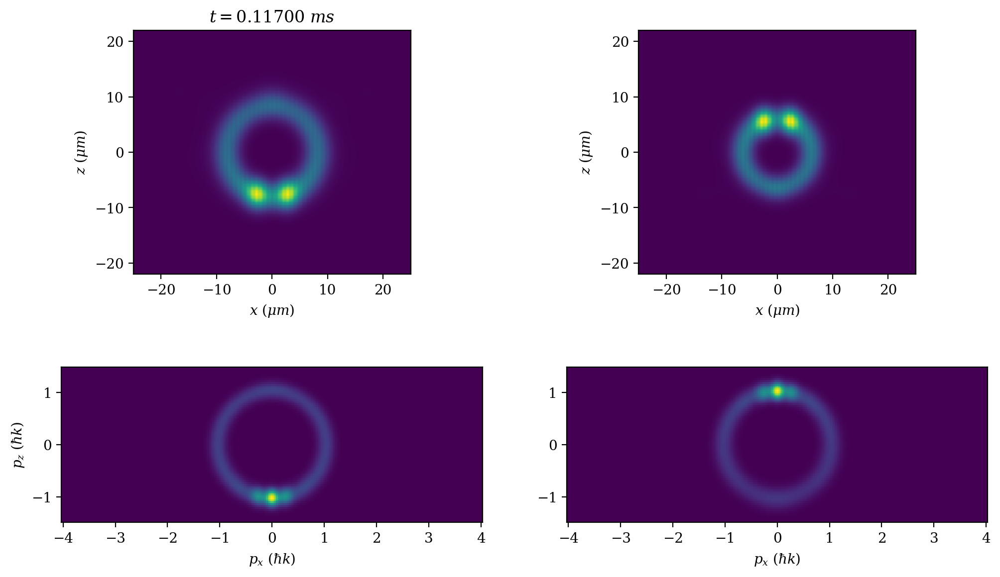

t = 0.11800 		 frame = 28 		 memory used: 9973.678MB  


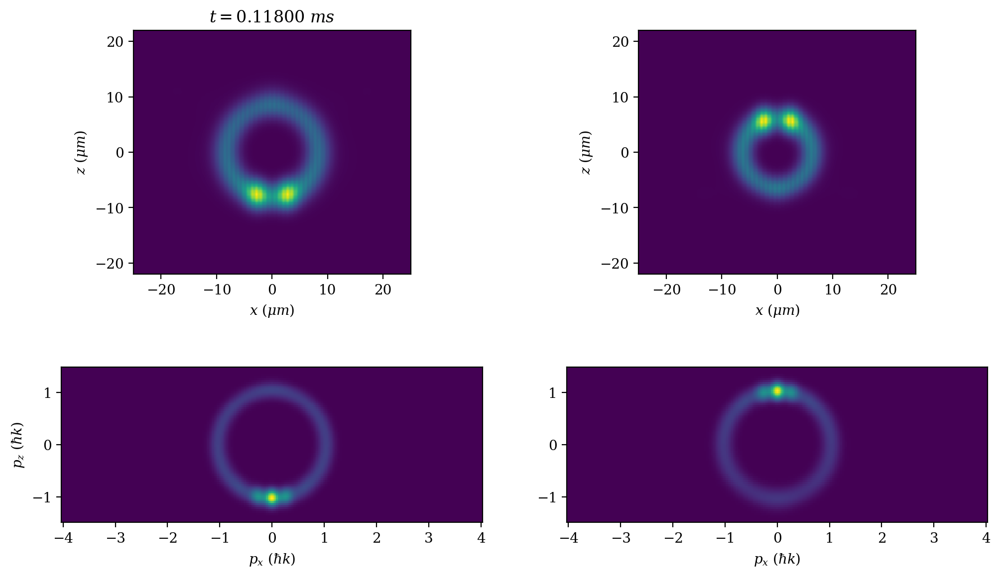

t = 0.11900 		 frame = 29 		 memory used: 13570.064MB  


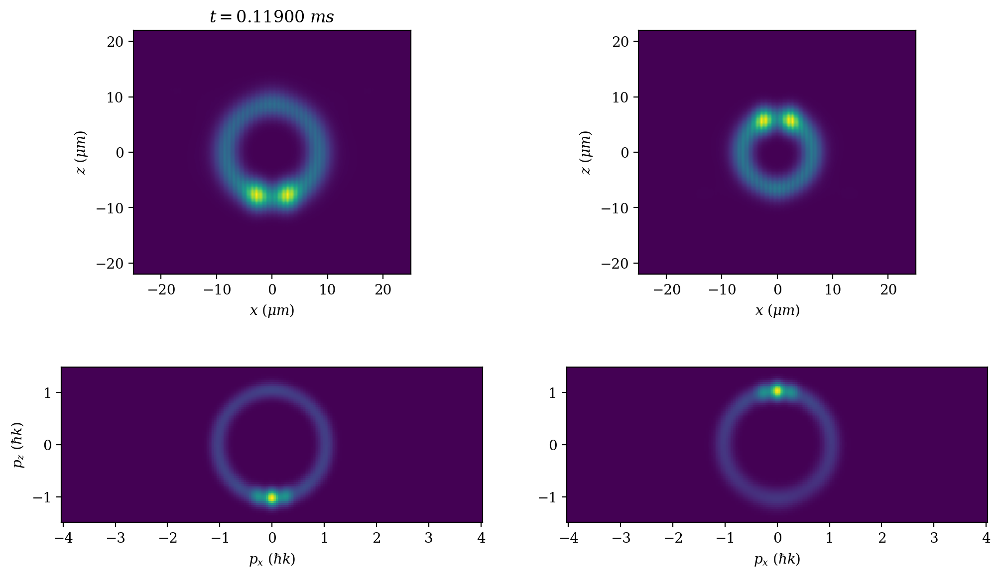

t = 0.12000 		 frame = 30 		 memory used: 13988.938MB  


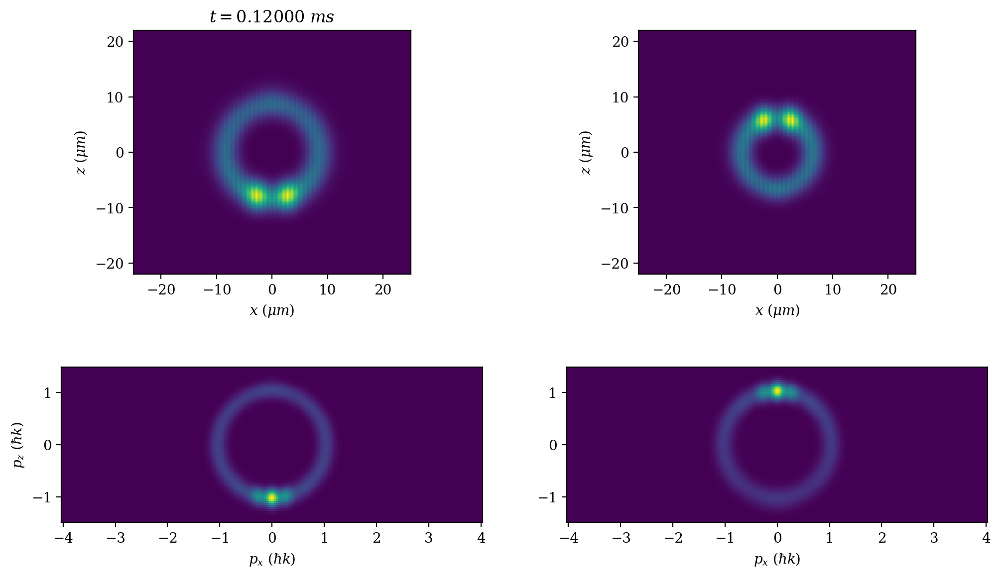

t = 0.12100 		 frame = 31 		 memory used: 13999.423MB  


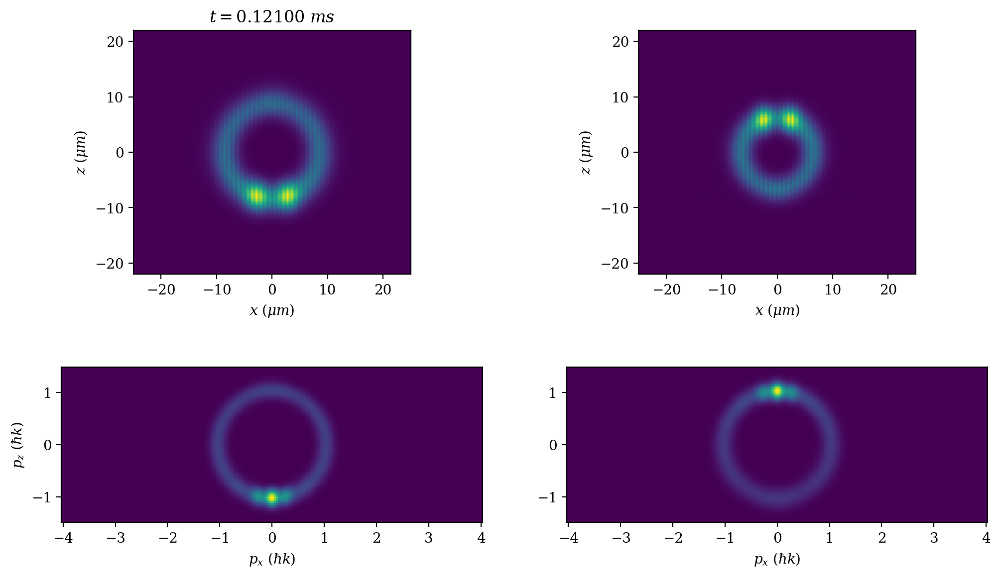

t = 0.12200 		 frame = 32 		 memory used: 14007.812MB  


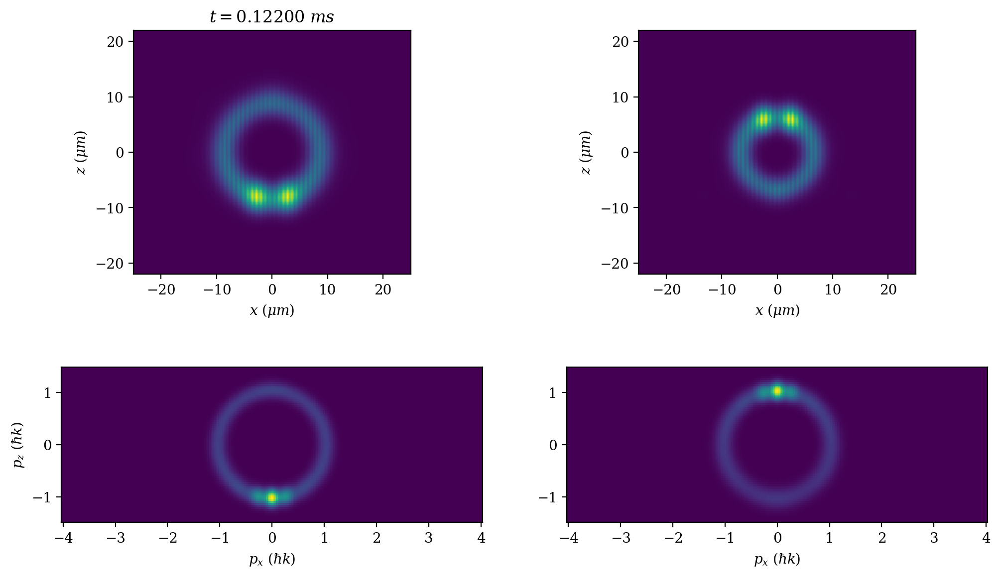

t = 0.12300 		 frame = 33 		 memory used: 14017.954MB  


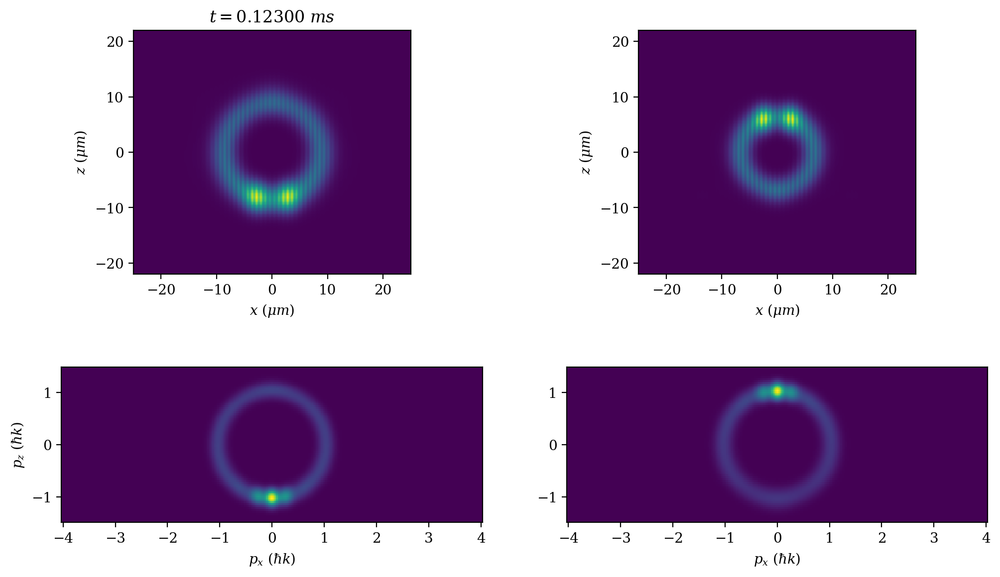

t = 0.12400 		 frame = 34 		 memory used: 14033.863MB  


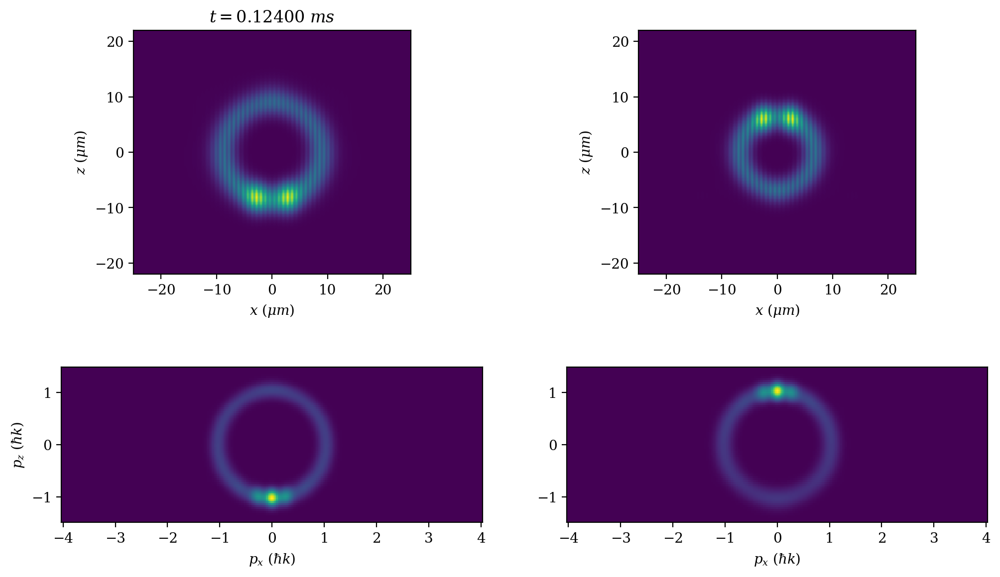

t = 0.12500 		 frame = 35 		 memory used: 7399.211MB  


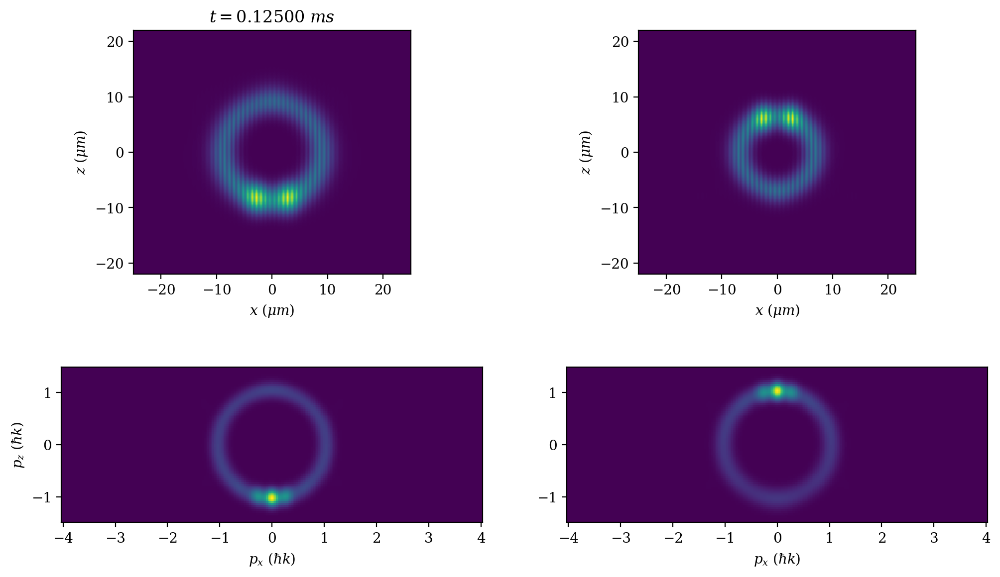

t = 0.12600 		 frame = 36 		 memory used: 13504.561MB  


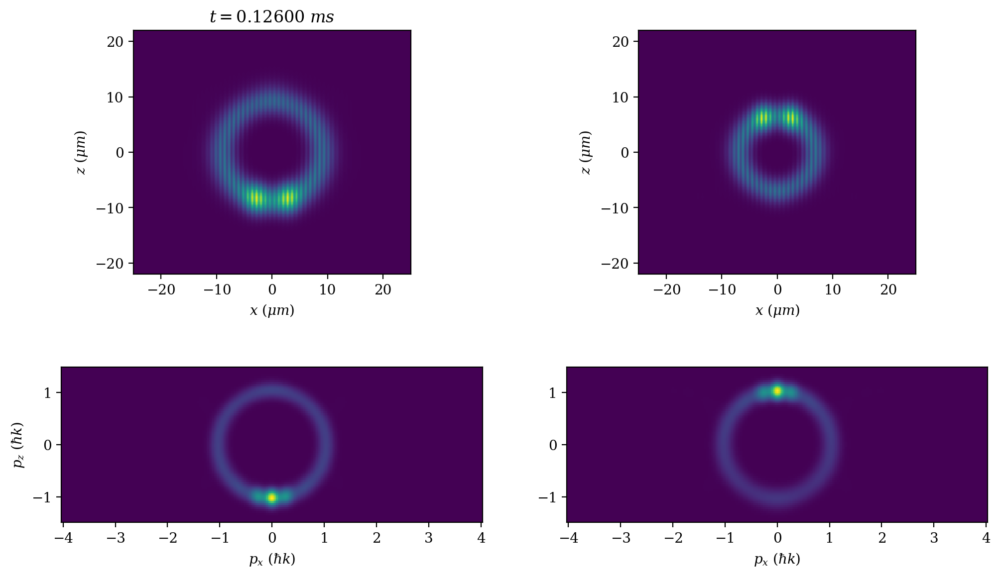

t = 0.12700 		 frame = 37 		 memory used: 7246.086MB  


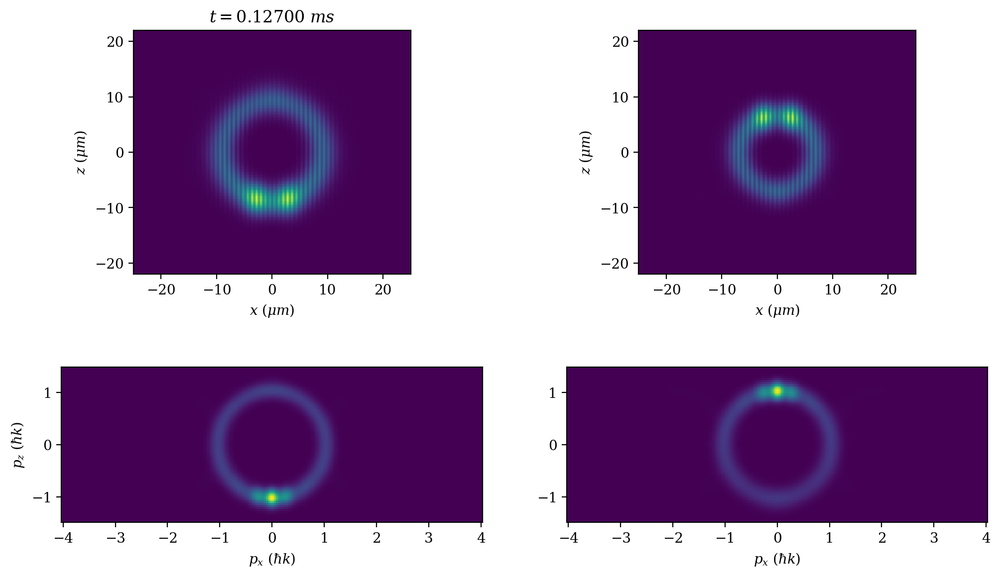

t = 0.12800 		 frame = 38 		 memory used: 6855.901MB  


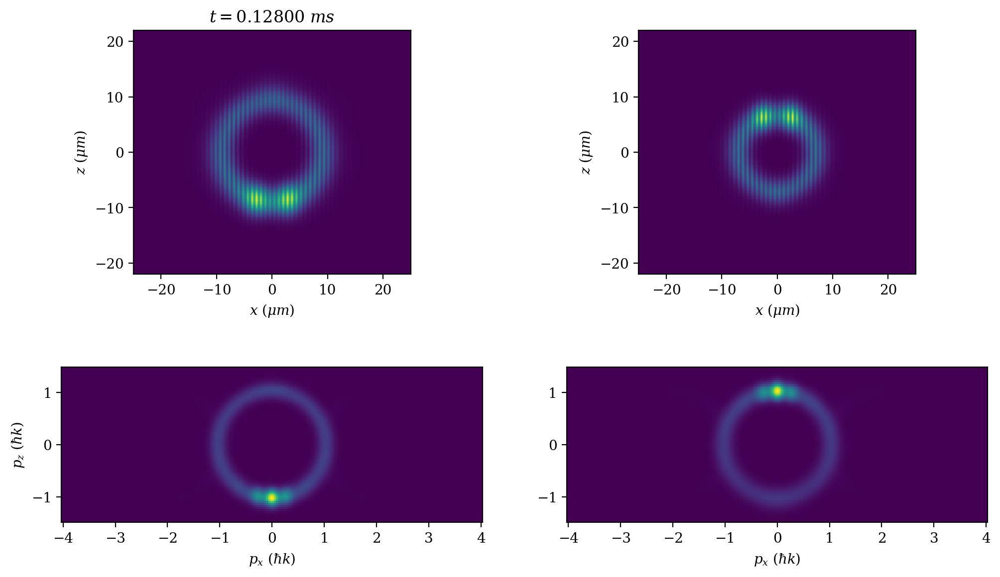

t = 0.12900 		 frame = 39 		 memory used: 7133.397MB  


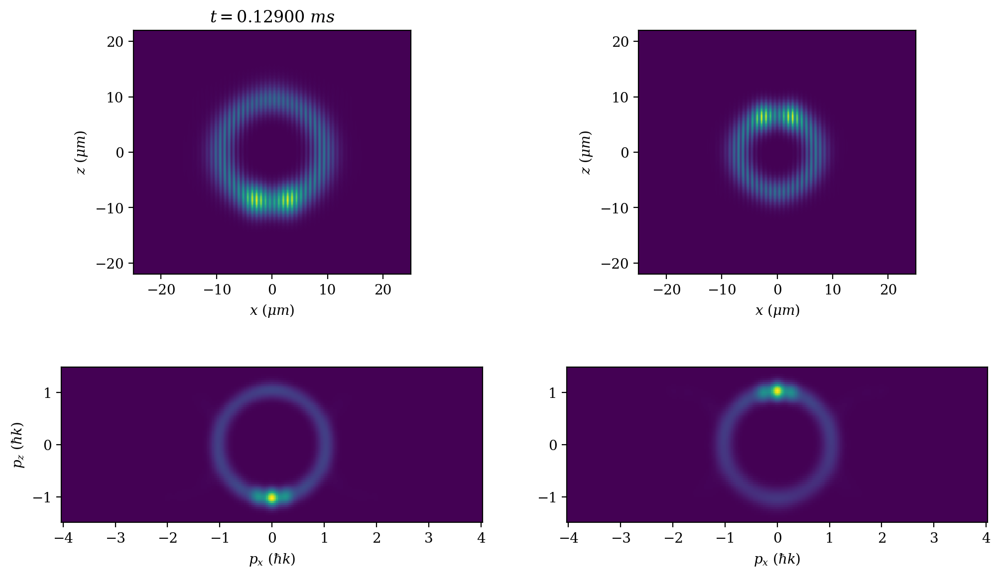

t = 0.13000 		 frame = 40 		 memory used: 6885.769MB  


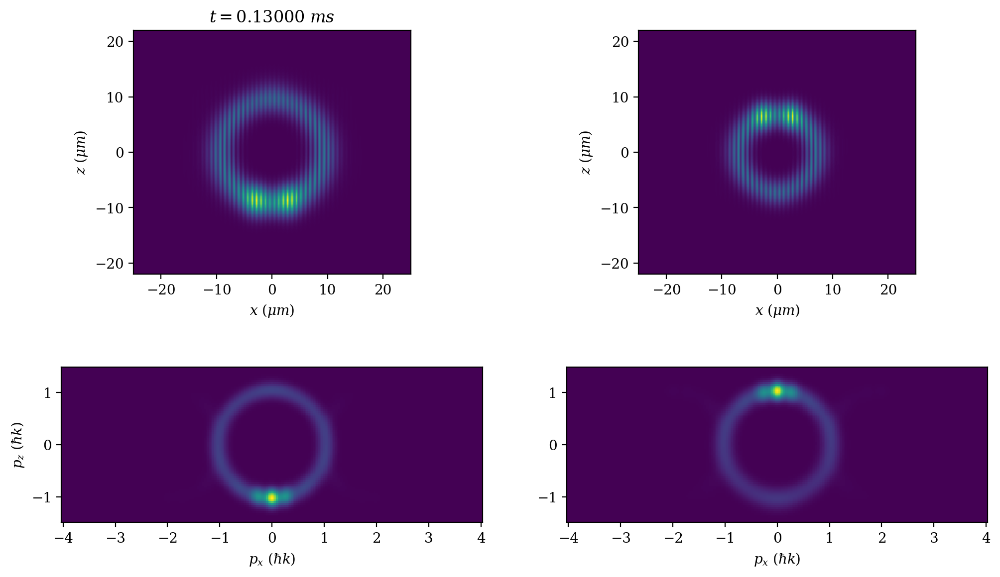

t = 0.13100 		 frame = 41 		 memory used: 9648.046MB  


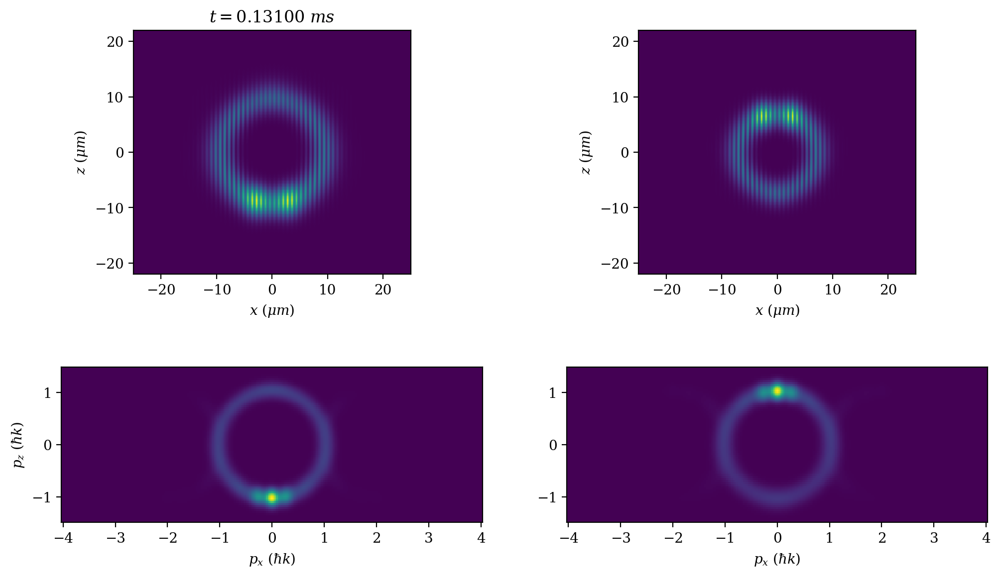

t = 0.13200 		 frame = 42 		 memory used: 9632.432MB  


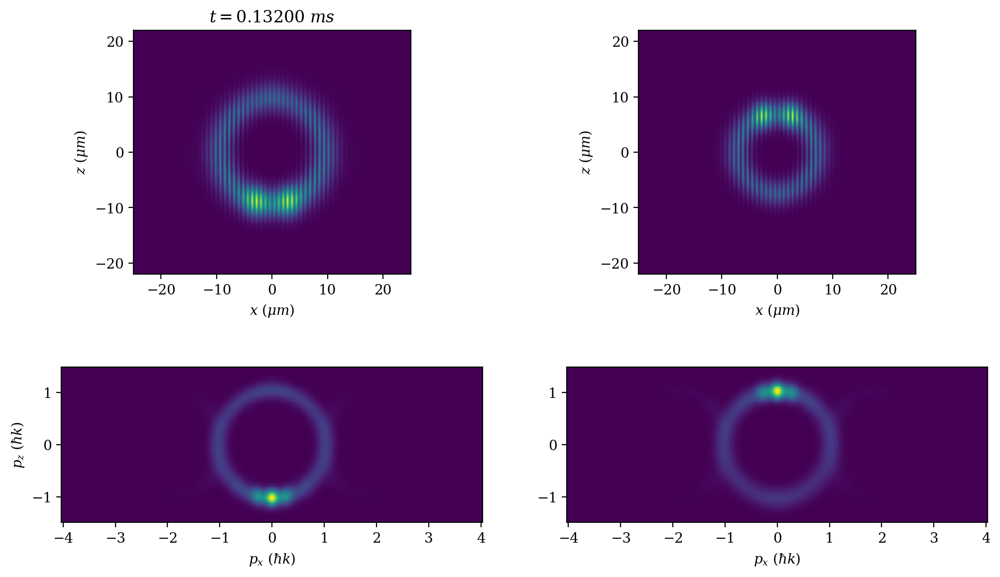

t = 0.13300 		 frame = 43 		 memory used: 9802.94MB  


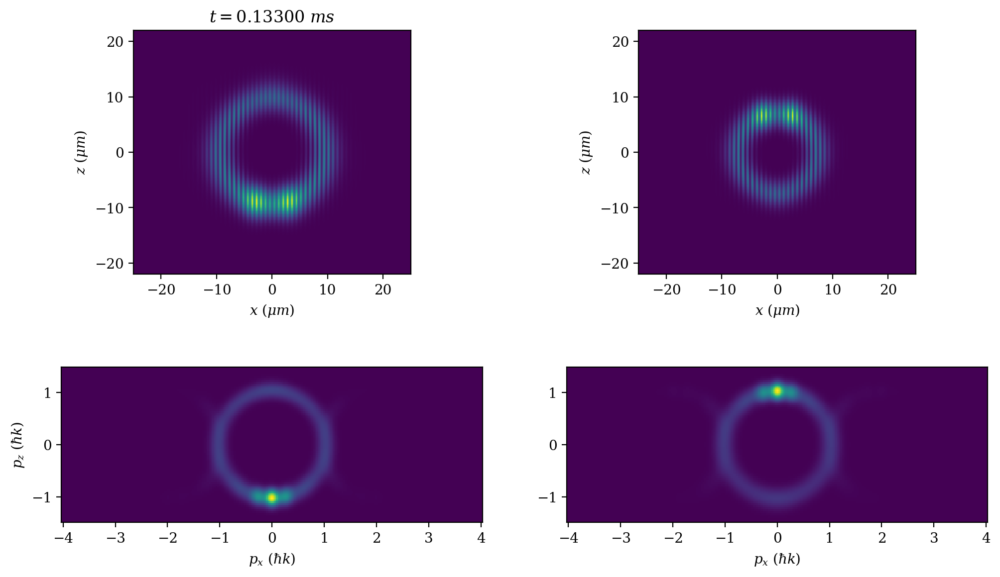

t = 0.13400 		 frame = 44 		 memory used: 7207.404MB  


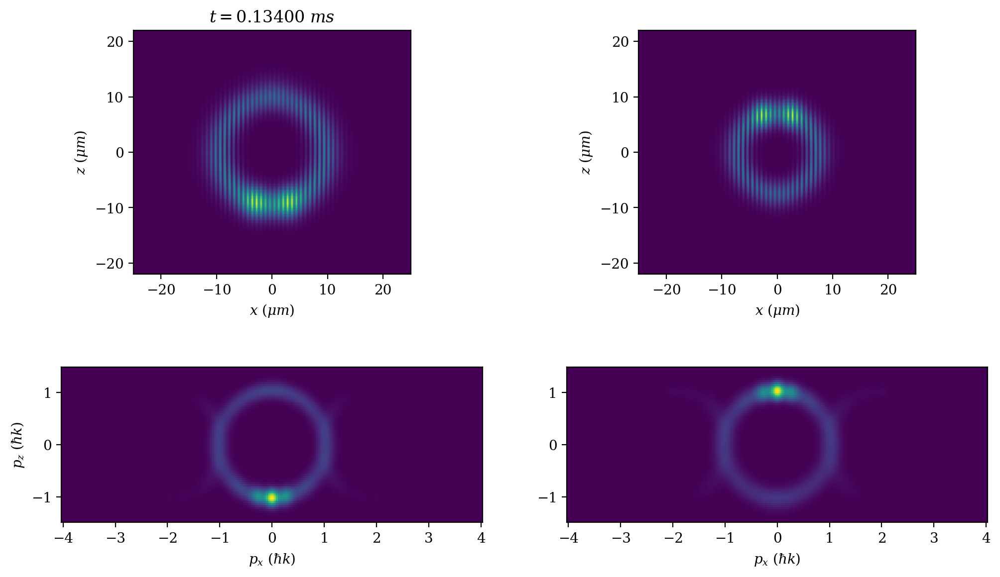

t = 0.13500 		 frame = 45 		 memory used: 6840.123MB  


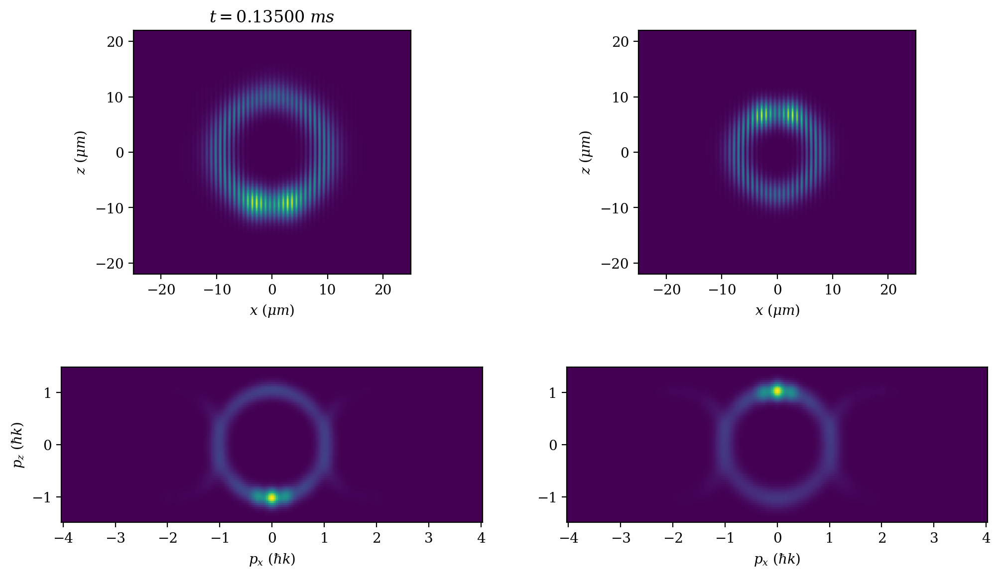

t = 0.13600 		 frame = 46 		 memory used: 7163.576MB  


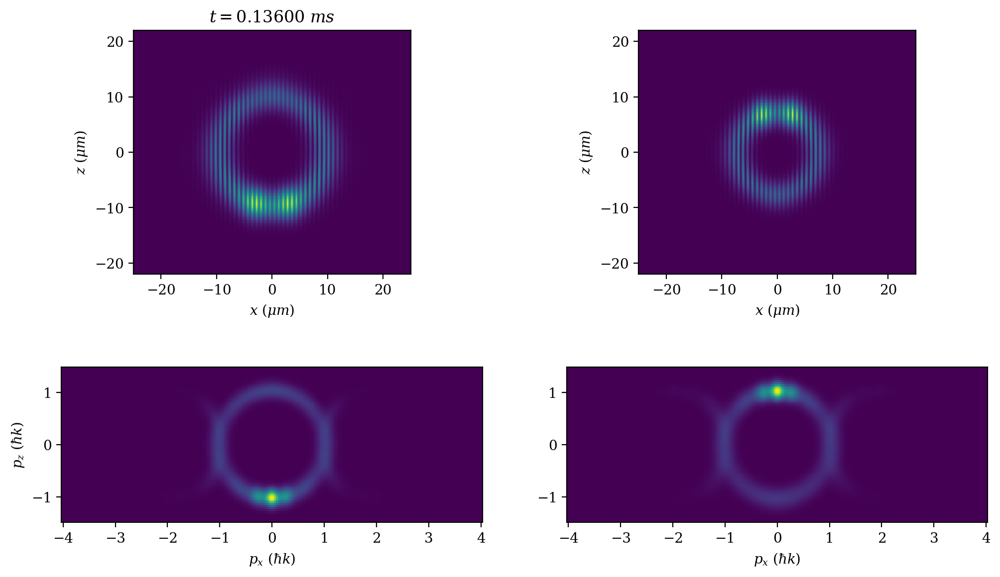

t = 0.13700 		 frame = 47 		 memory used: 6860.194MB  


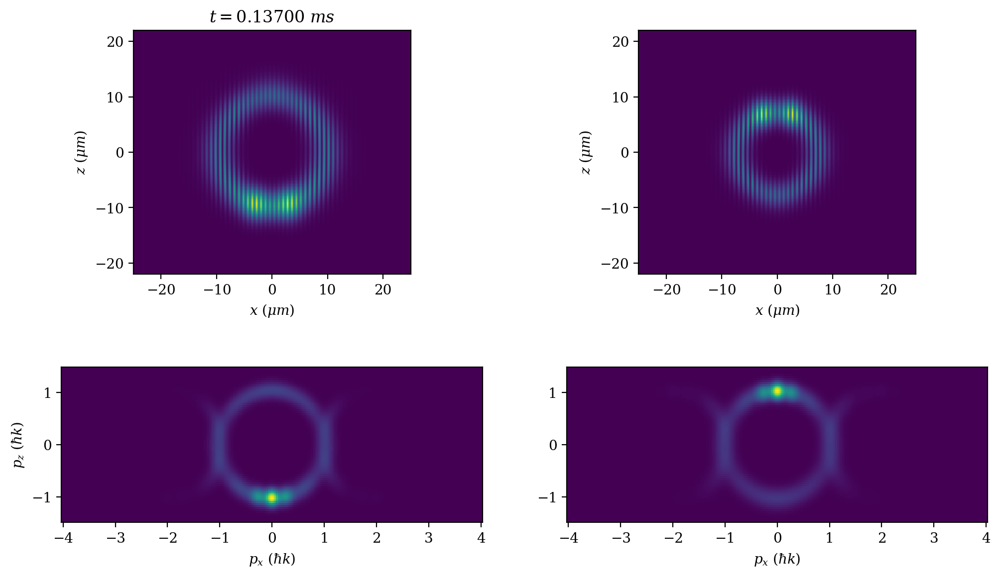

t = 0.13800 		 frame = 48 		 memory used: 6650.151MB  


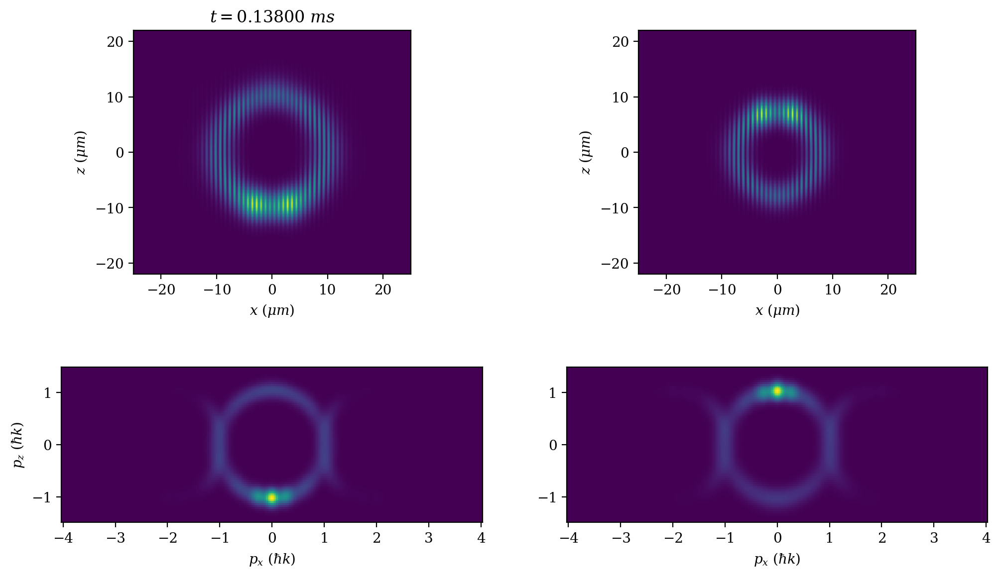

t = 0.13900 		 frame = 49 		 memory used: 9718.612MB  


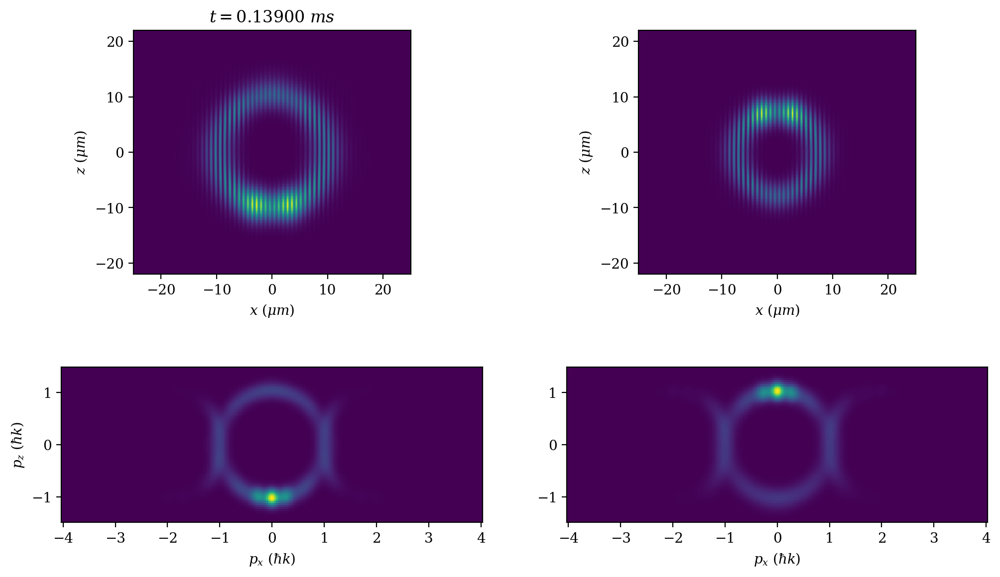

t = 0.14000 		 frame = 50 		 memory used: 9613.541MB  


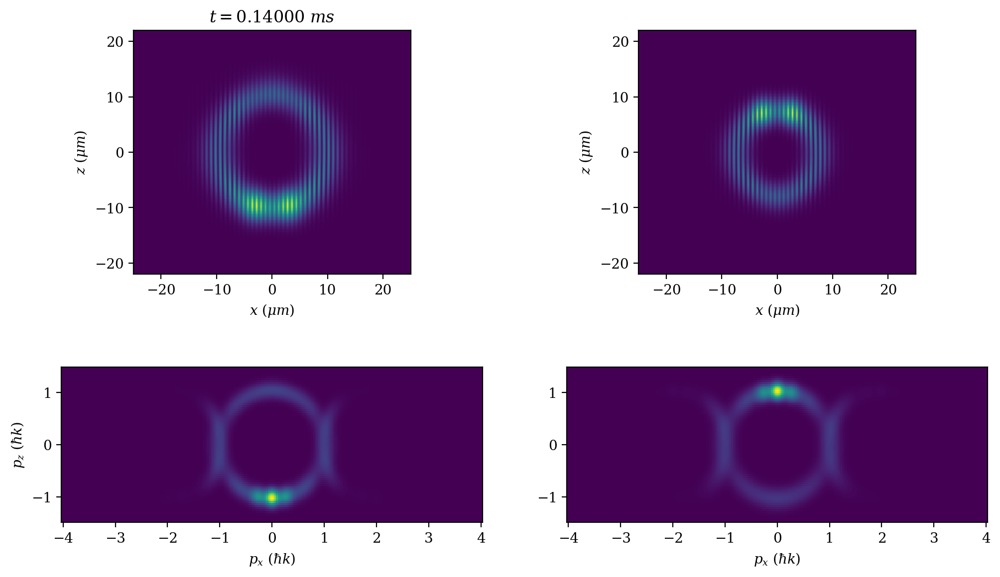

t = 0.14100 		 frame = 51 		 memory used: 6860.308MB  


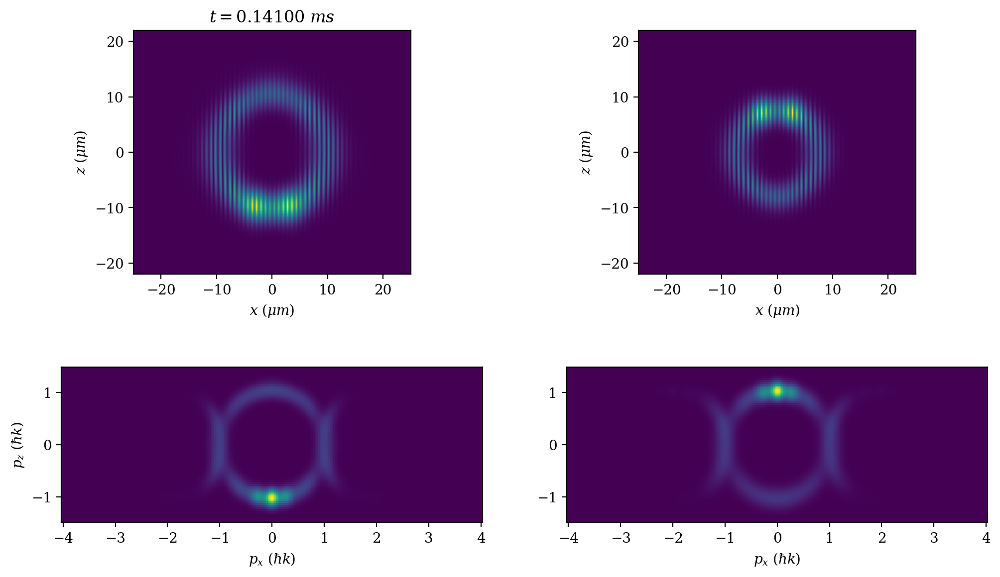

t = 0.14200 		 frame = 52 		 memory used: 9651.503MB  


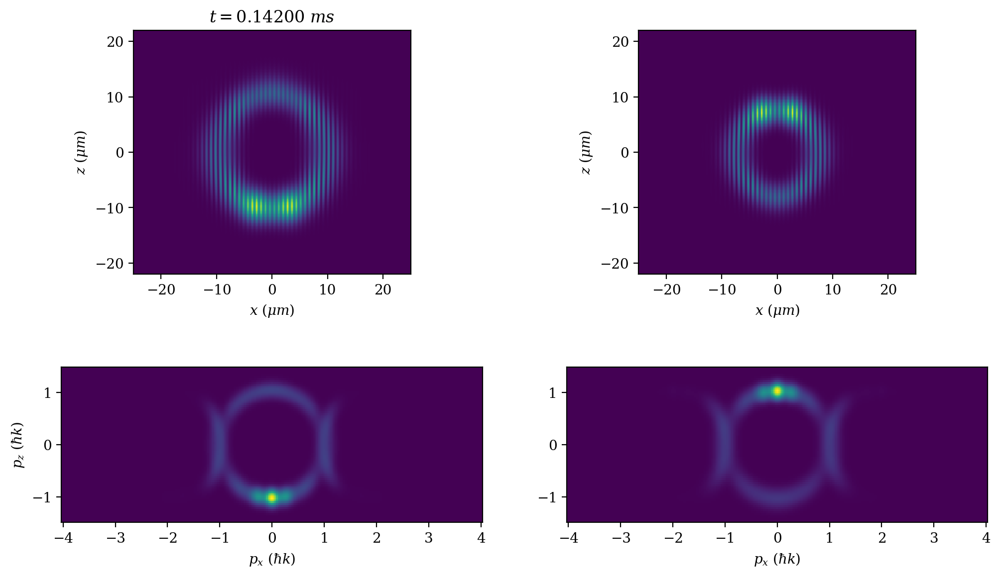

t = 0.14300 		 frame = 53 		 memory used: 7672.676MB  


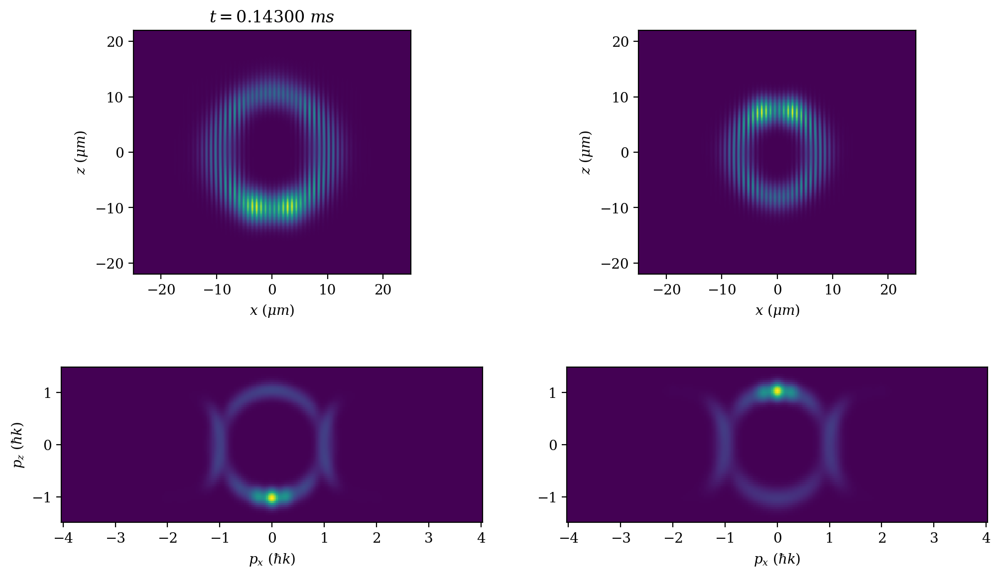

t = 0.14400 		 frame = 54 		 memory used: 9252.454MB  


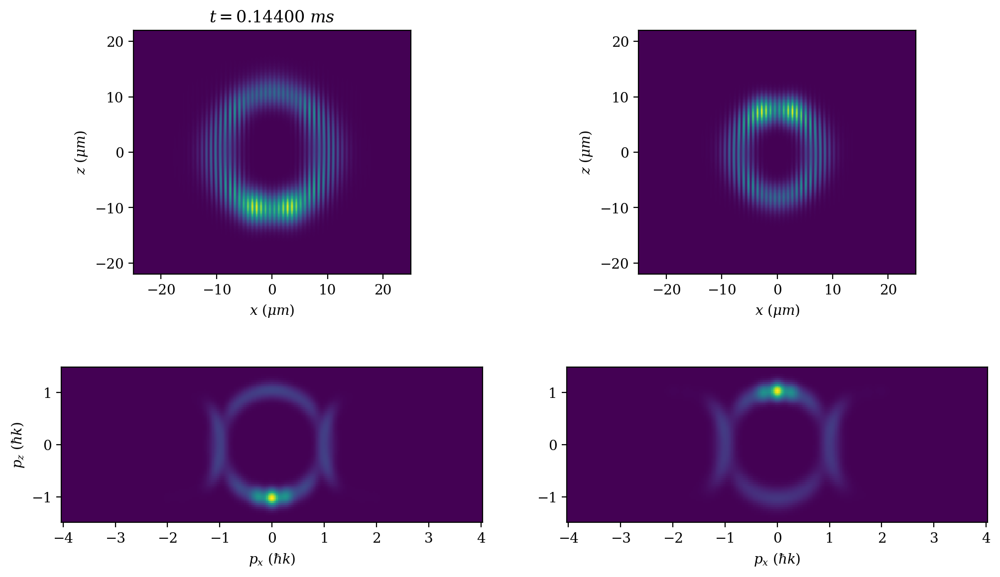

t = 0.14500 		 frame = 55 		 memory used: 6954.795MB  


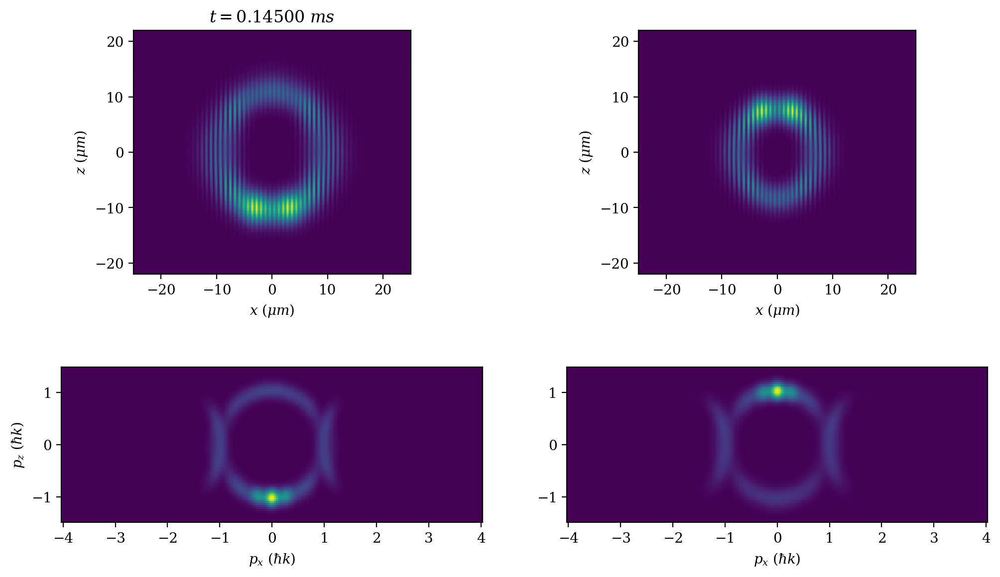

t = 0.14600 		 frame = 56 		 memory used: 6999.917MB  


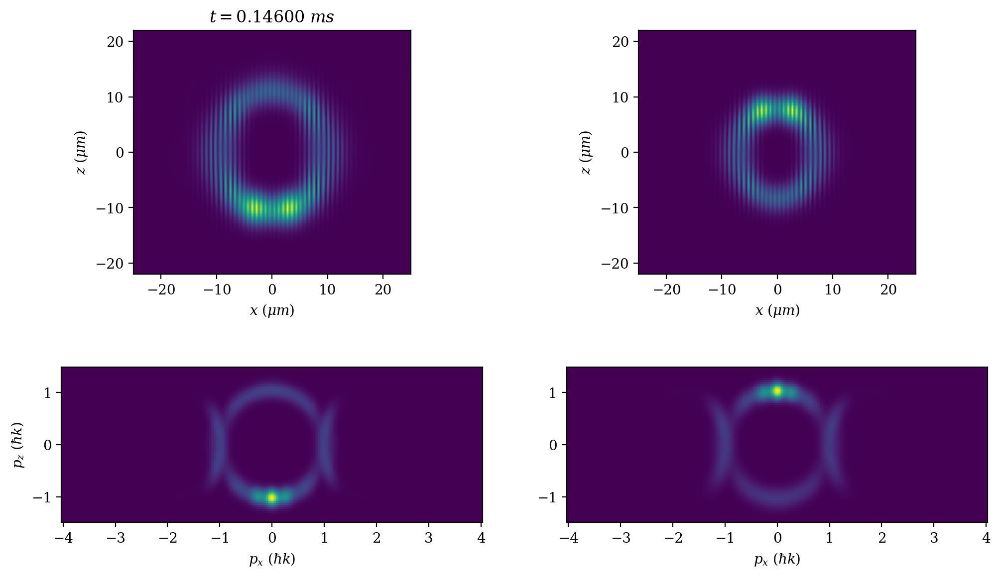

t = 0.14700 		 frame = 57 		 memory used: 7014.007MB  


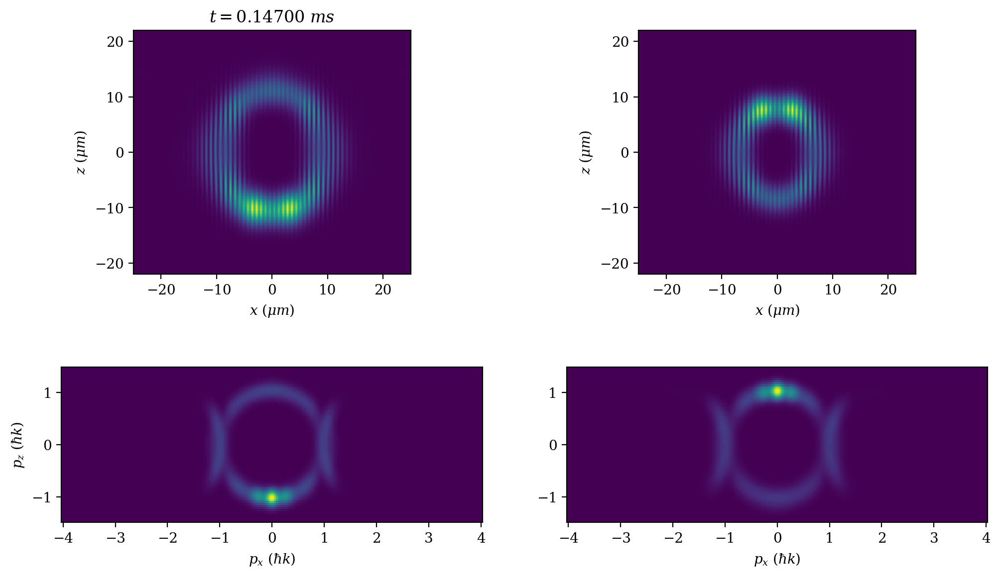

t = 0.14800 		 frame = 58 		 memory used: 6837.207MB  


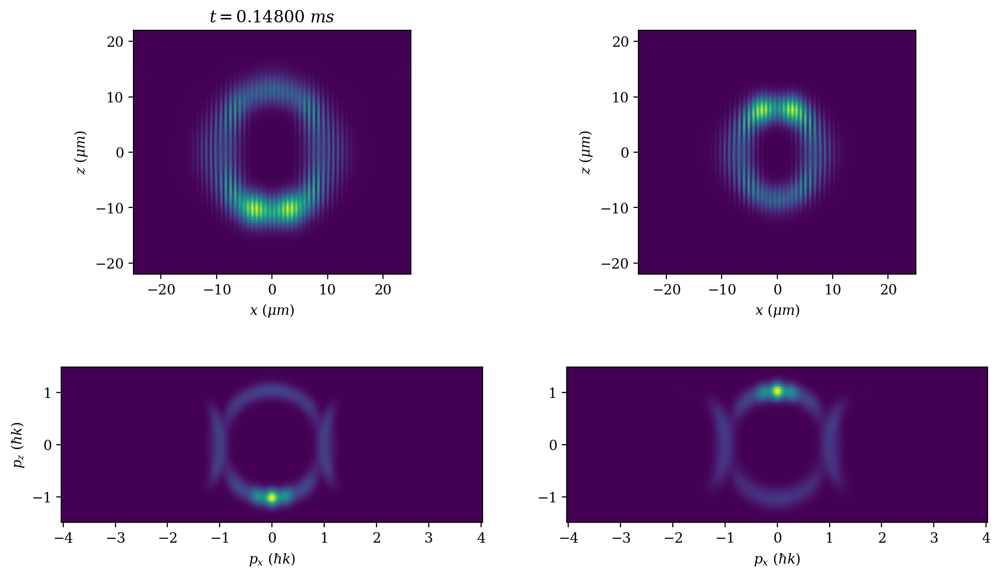

t = 0.14900 		 frame = 59 		 memory used: 6815.973MB  


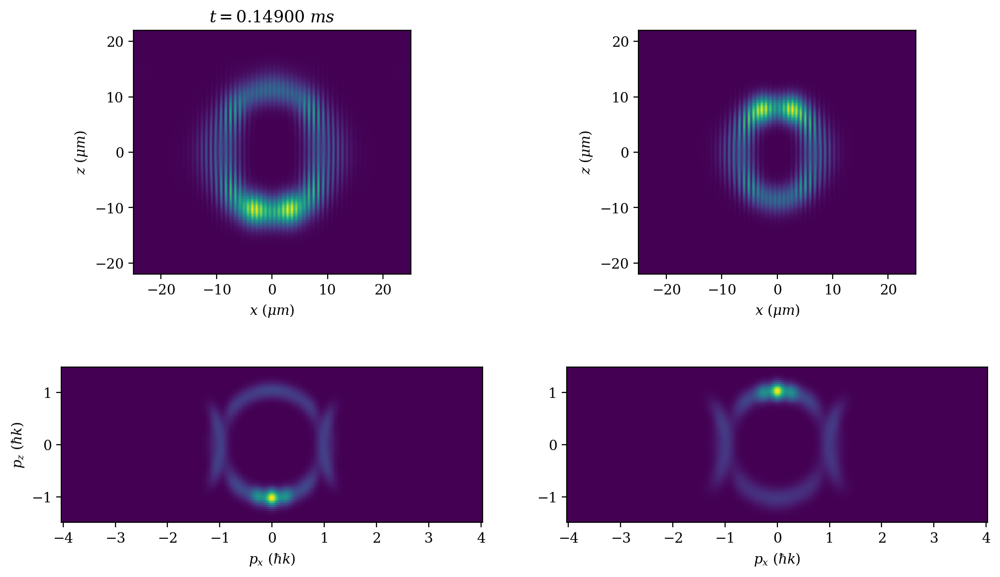

t = 0.15000 		 frame = 60 		 memory used: 6846.611MB  


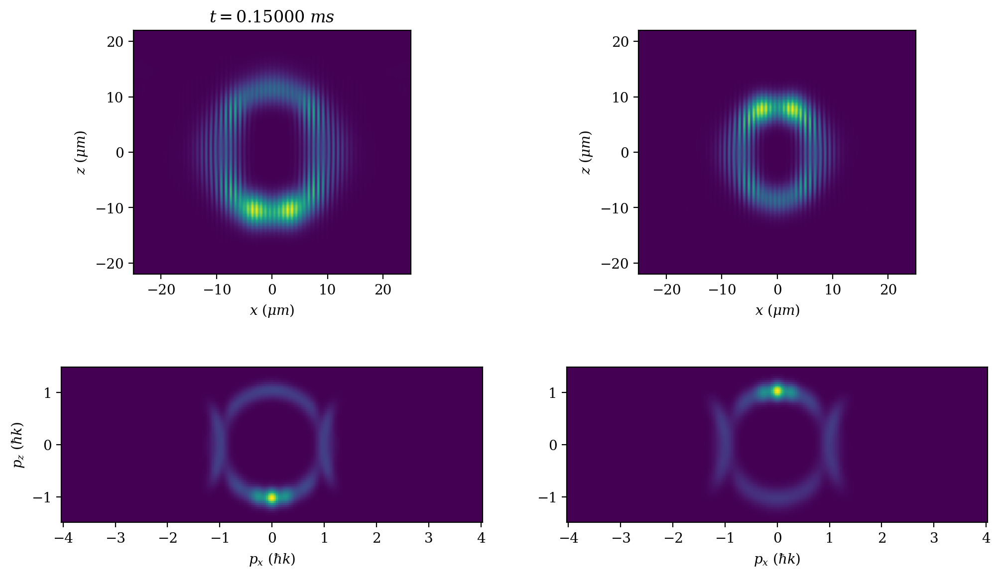

t = 0.15100 		 frame = 61 		 memory used: 6671.663MB  


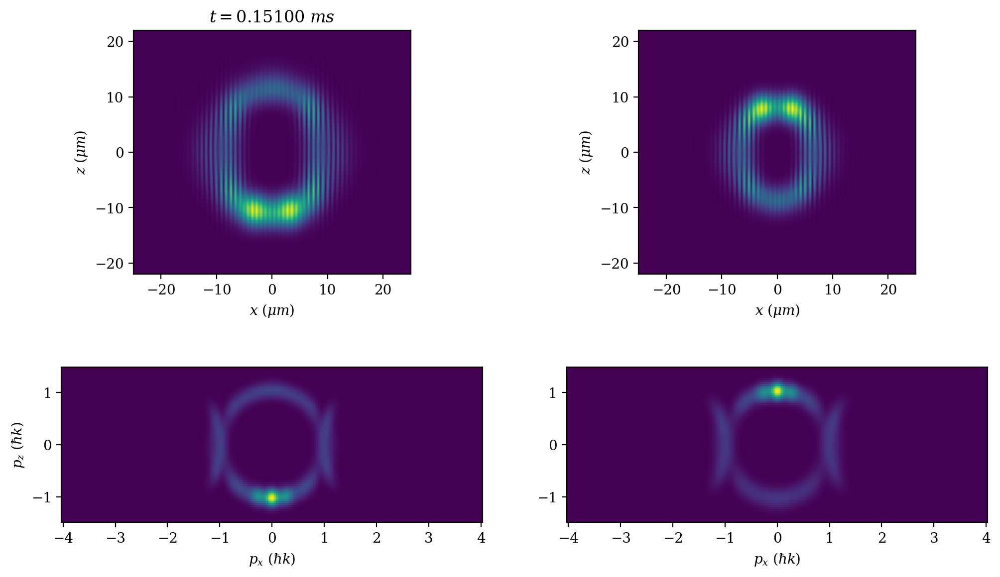

t = 0.15200 		 frame = 62 		 memory used: 9331.769MB  


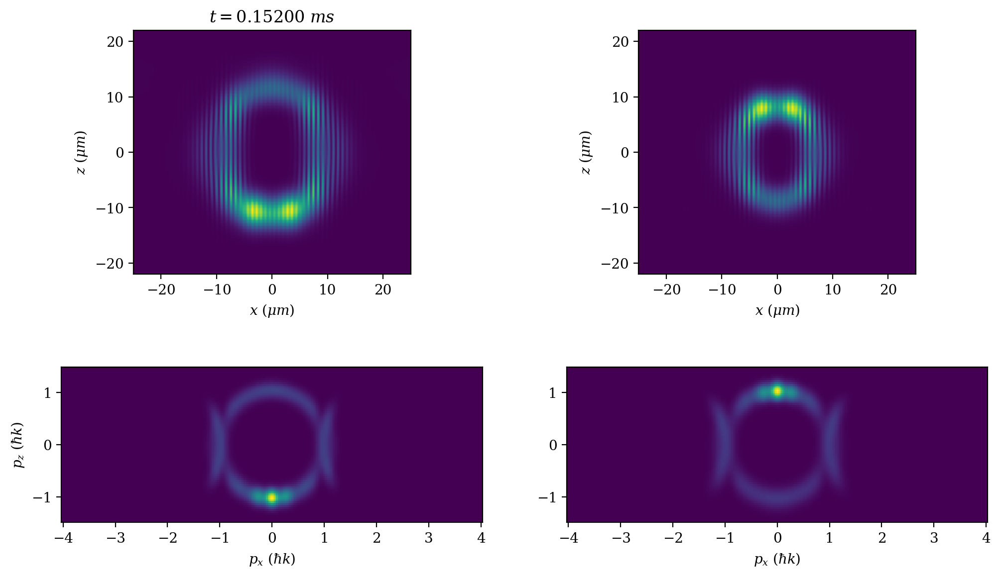

t = 0.15300 		 frame = 63 		 memory used: 6652.248MB  


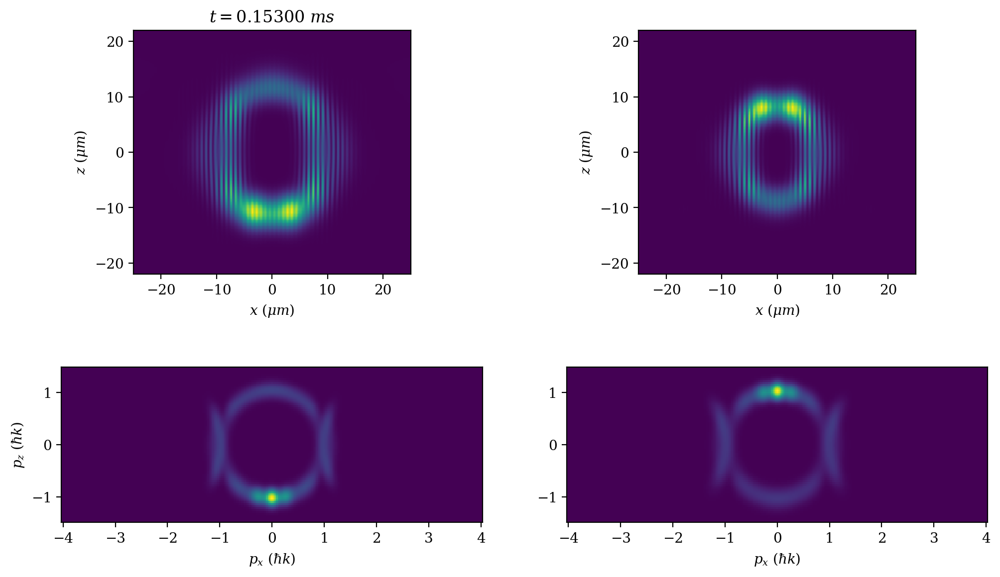

t = 0.15400 		 frame = 64 		 memory used: 9703.834MB  


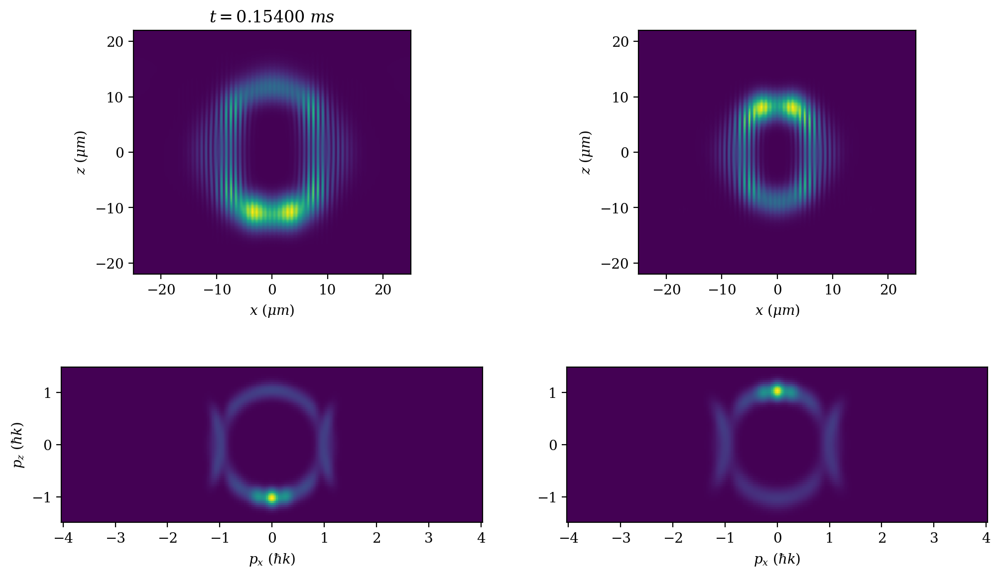

t = 0.15500 		 frame = 65 		 memory used: 6814.237MB  


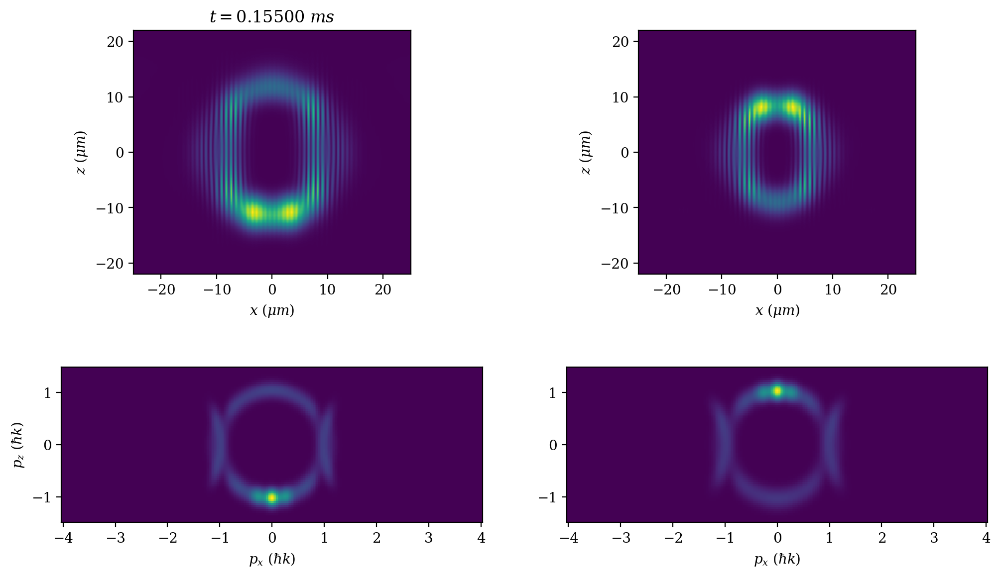

t = 0.15600 		 frame = 66 		 memory used: 6860.145MB  


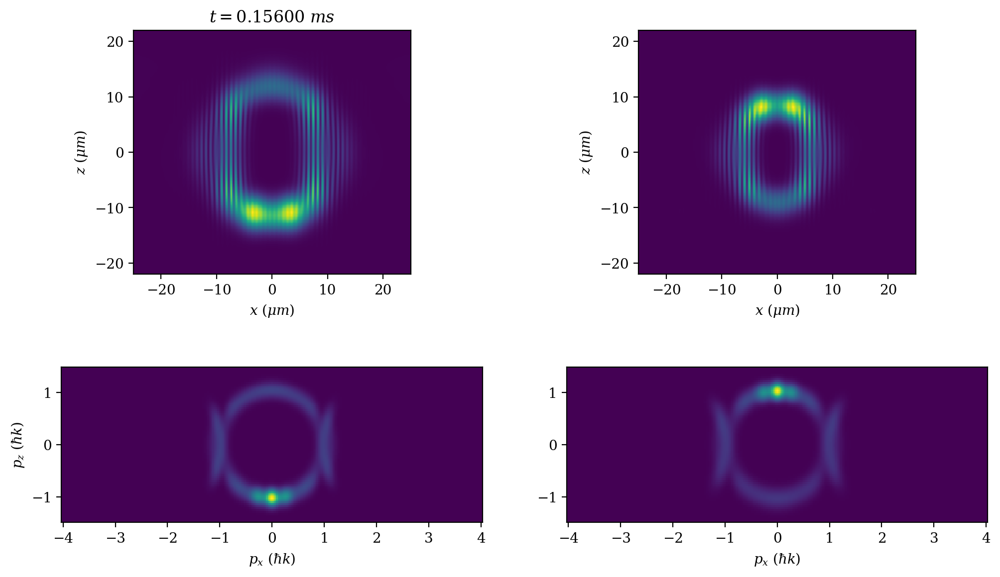

t = 0.15700 		 frame = 67 		 memory used: 6703.186MB  


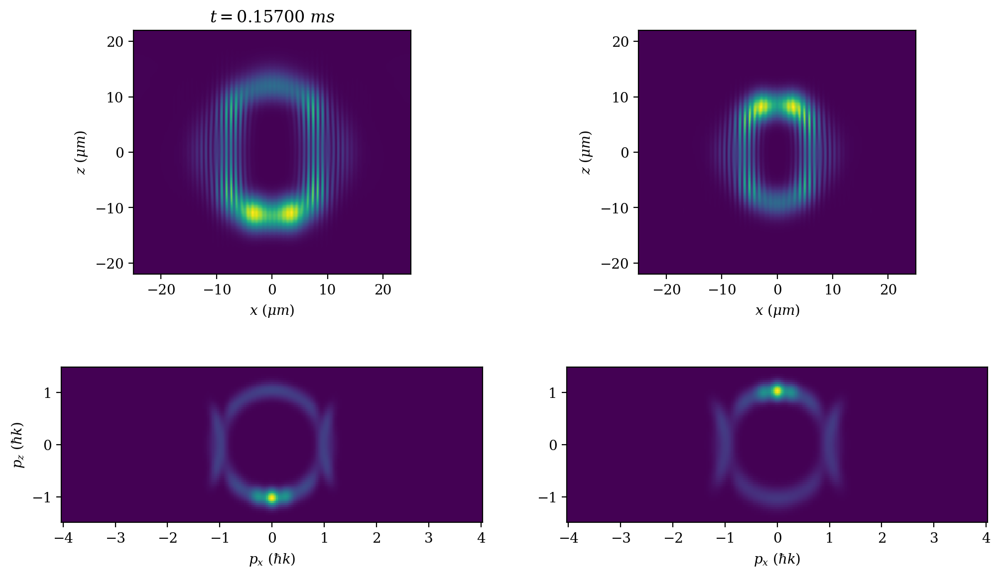

t = 0.15800 		 frame = 68 		 memory used: 6836.29MB  


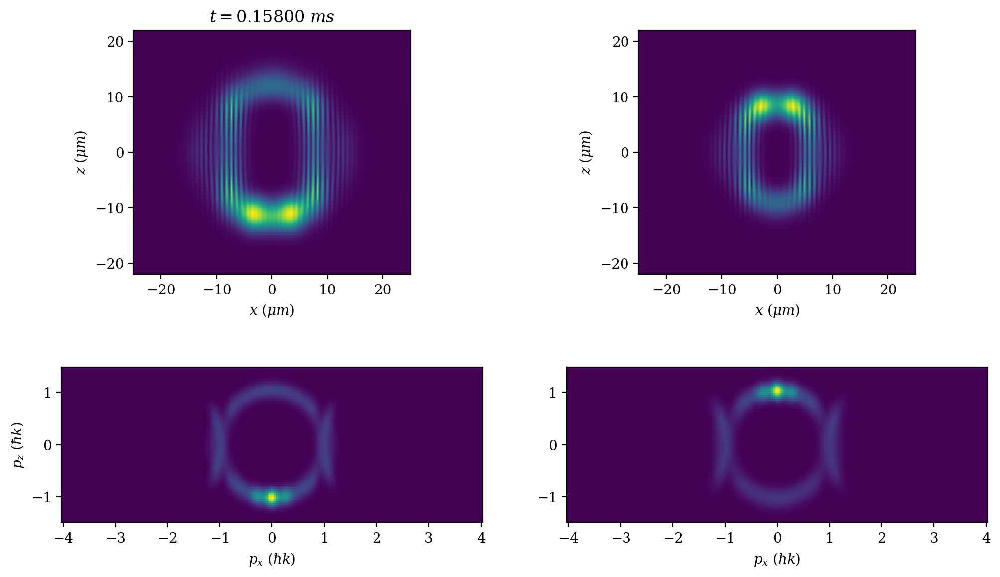

t = 0.15900 		 frame = 69 		 memory used: 7235.322MB  


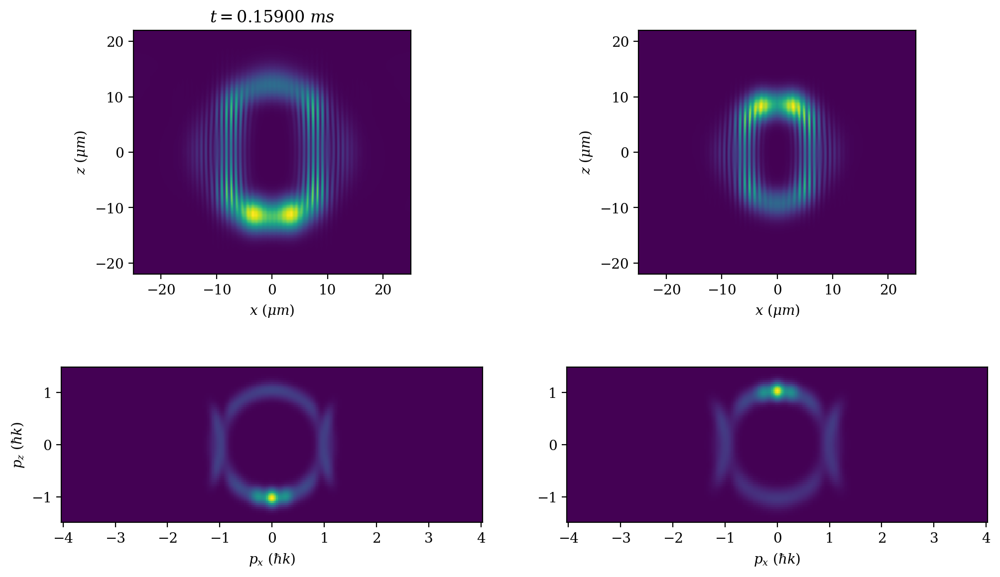

t = 0.16000 		 frame = 70 		 memory used: 7295.451MB  


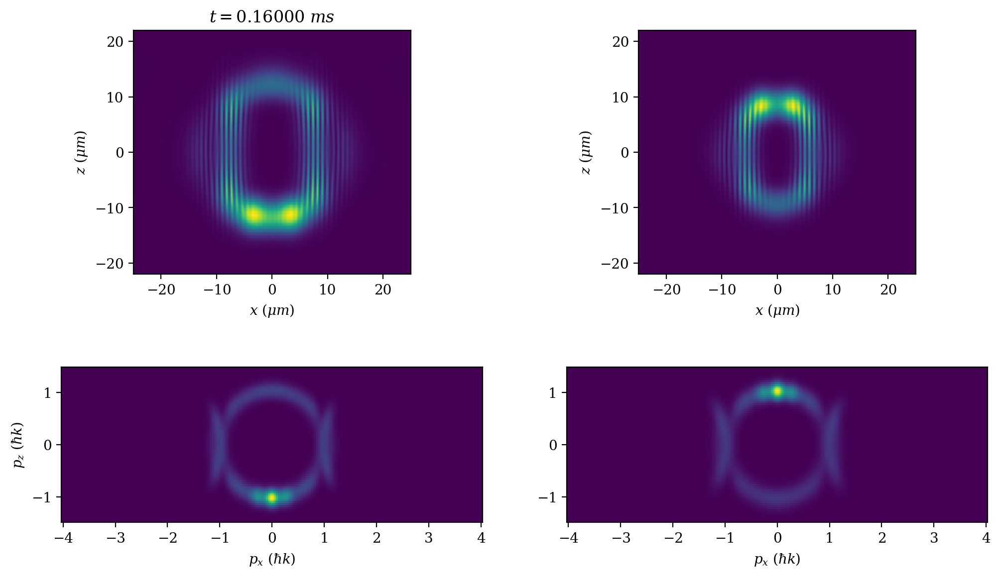

t = 0.16100 		 frame = 71 		 memory used: 9560.949MB  


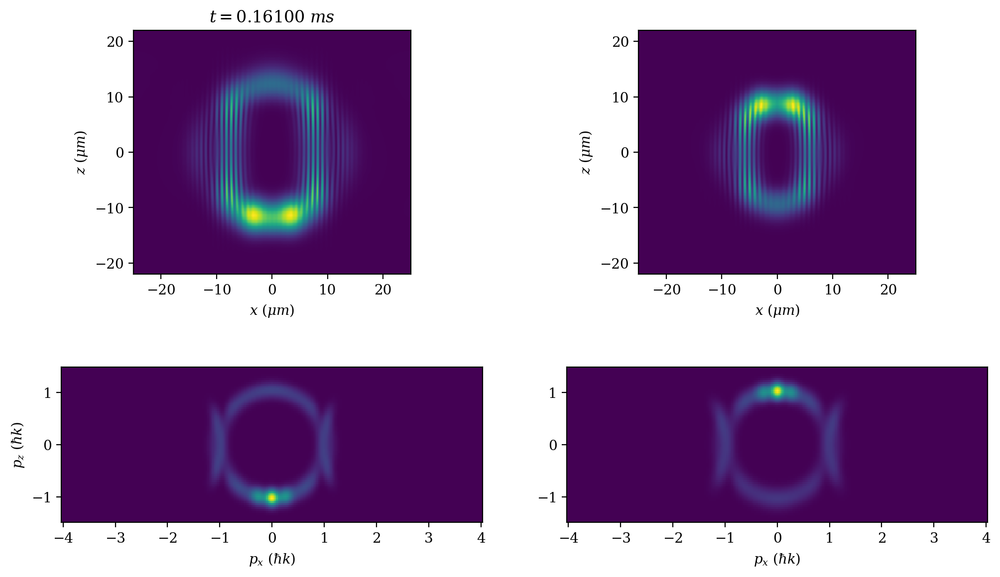

t = 0.16200 		 frame = 72 		 memory used: 6861.93MB  


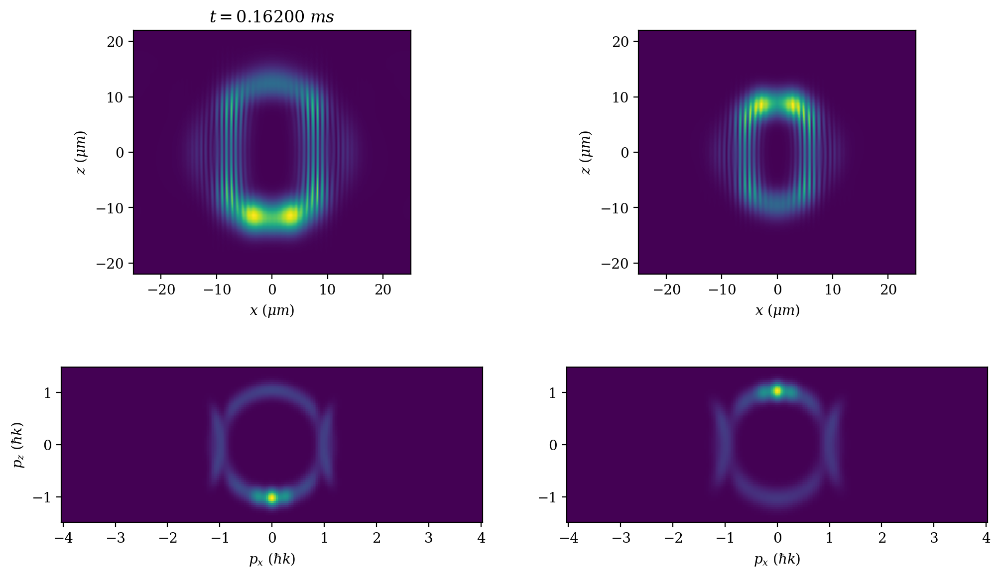

t = 0.16300 		 frame = 73 		 memory used: 6835.765MB  


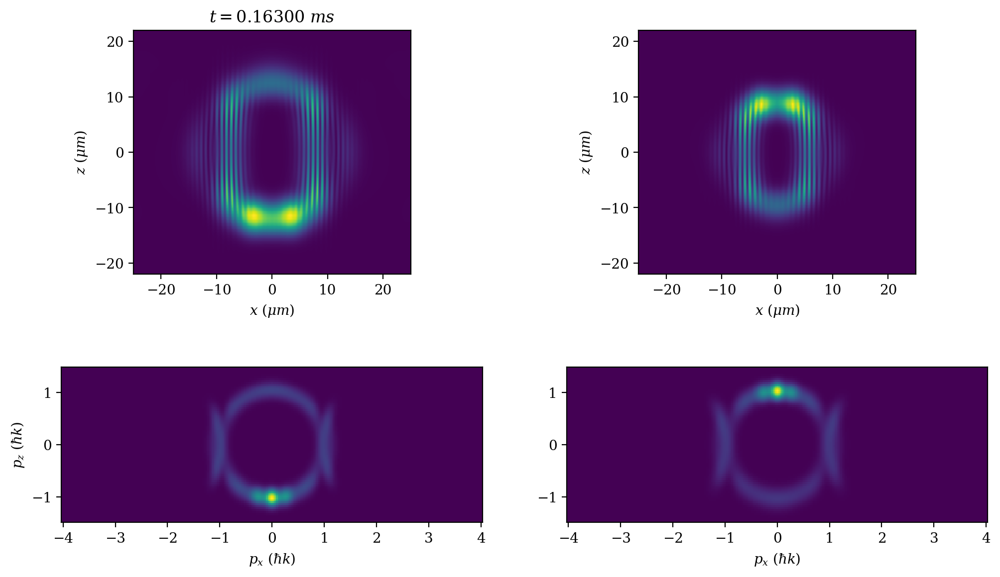

t = 0.16400 		 frame = 74 		 memory used: 6840.304MB  


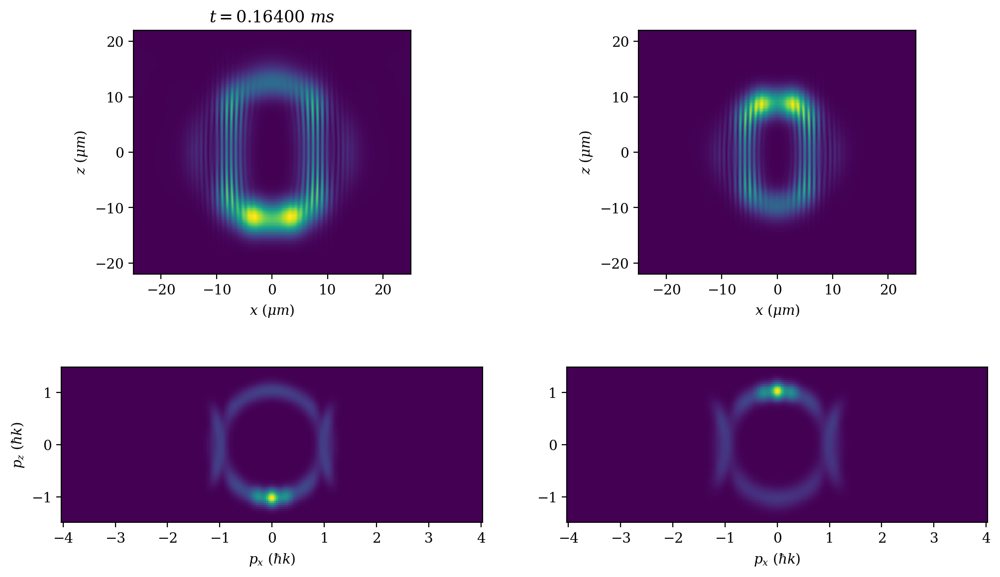

t = 0.16500 		 frame = 75 		 memory used: 6656.492MB  


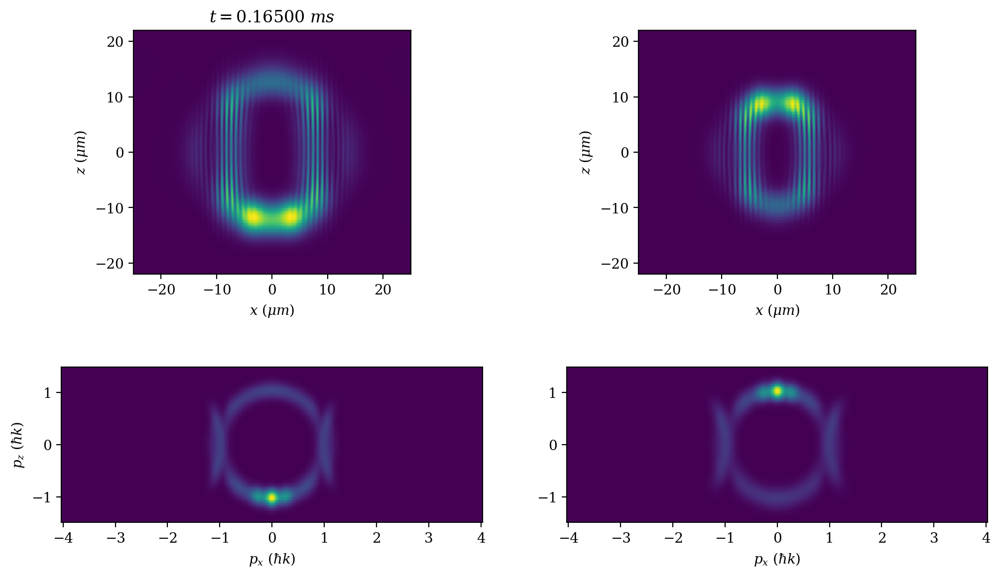

t = 0.16600 		 frame = 76 		 memory used: 6667.125MB  


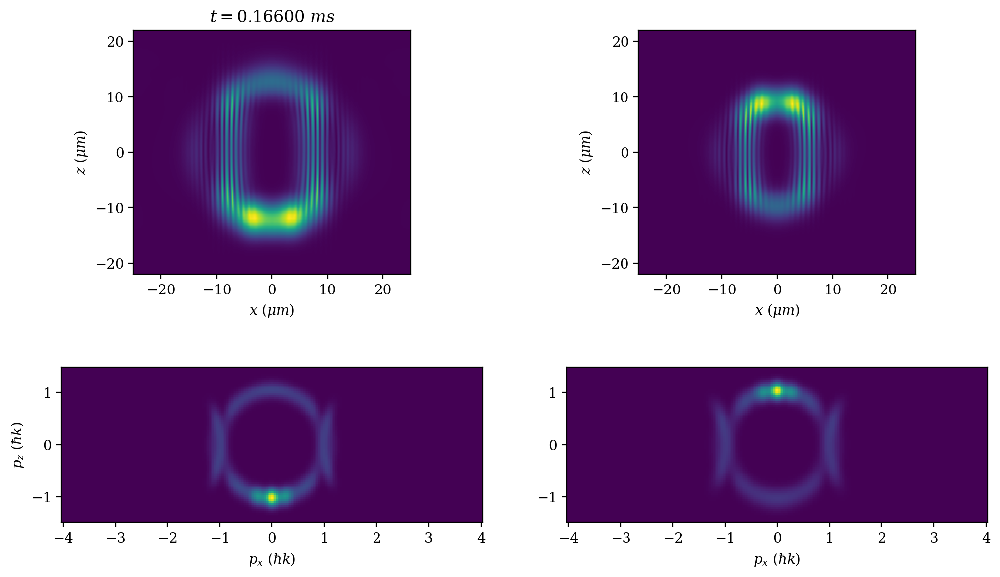

t = 0.16700 		 frame = 77 		 memory used: 9752.953MB  


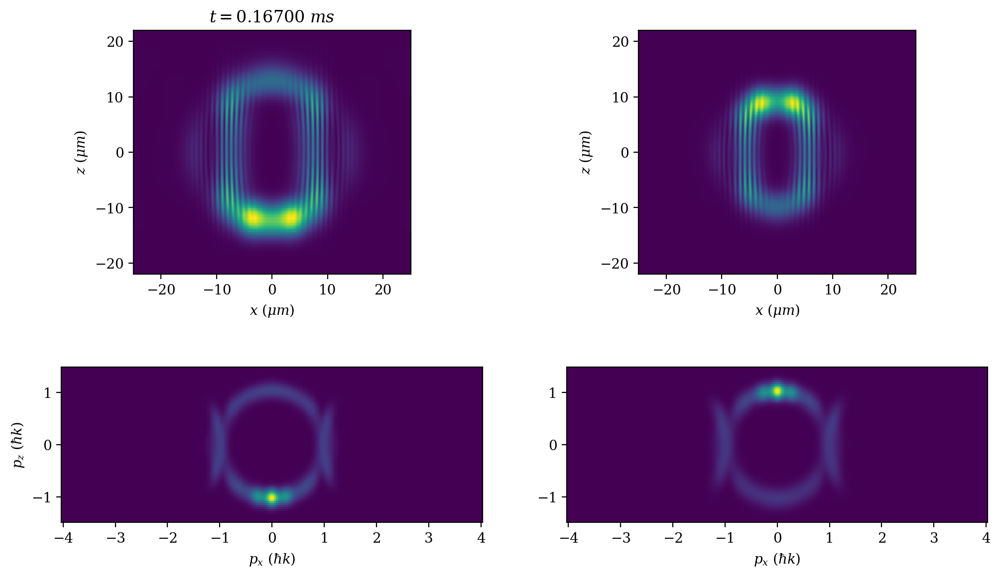

t = 0.16800 		 frame = 78 		 memory used: 7088.816MB  


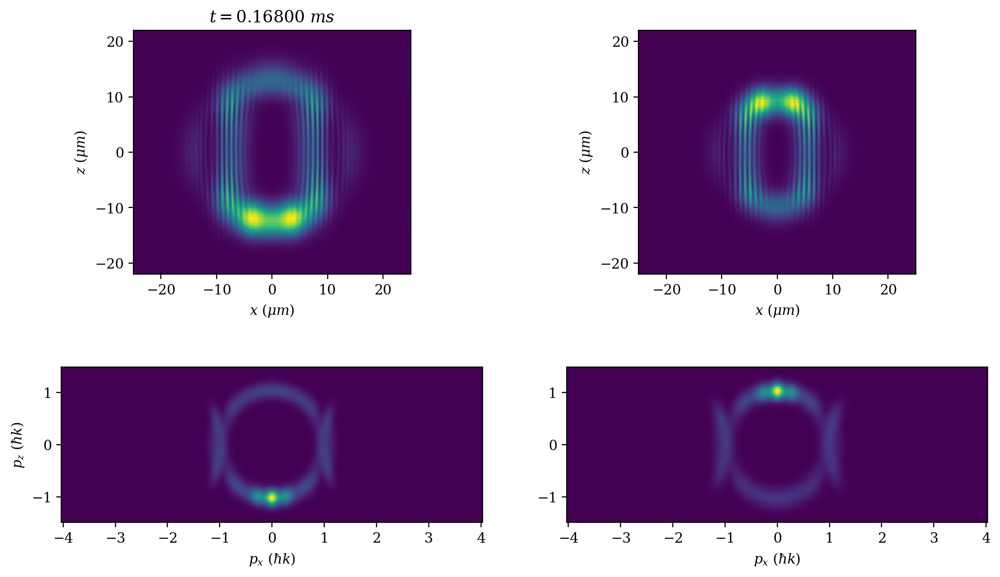

t = 0.16900 		 frame = 79 		 memory used: 9435.529MB  


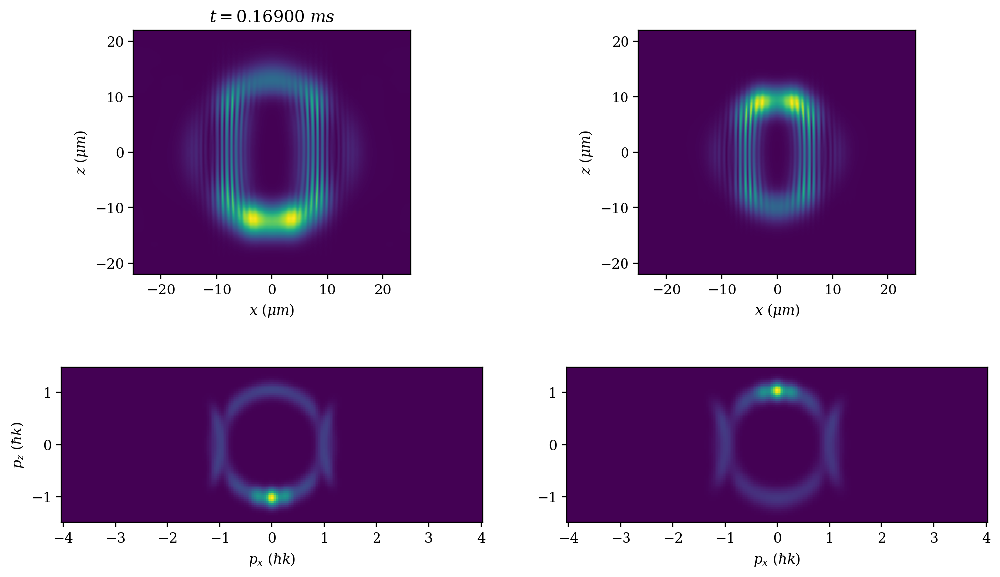

t = 0.17000 		 frame = 80 		 memory used: 9721.348MB  


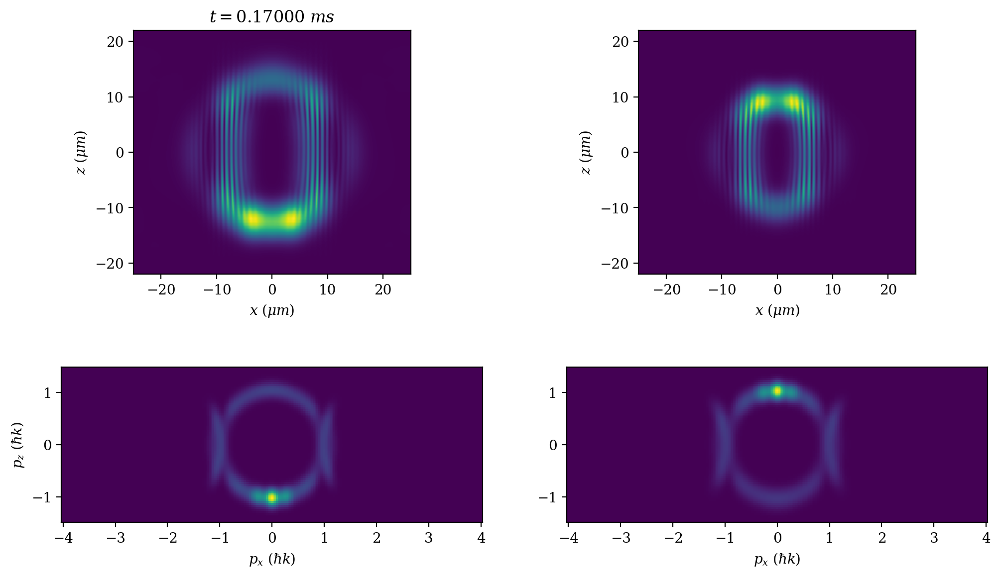

t = 0.17100 		 frame = 81 		 memory used: 9490.022MB  


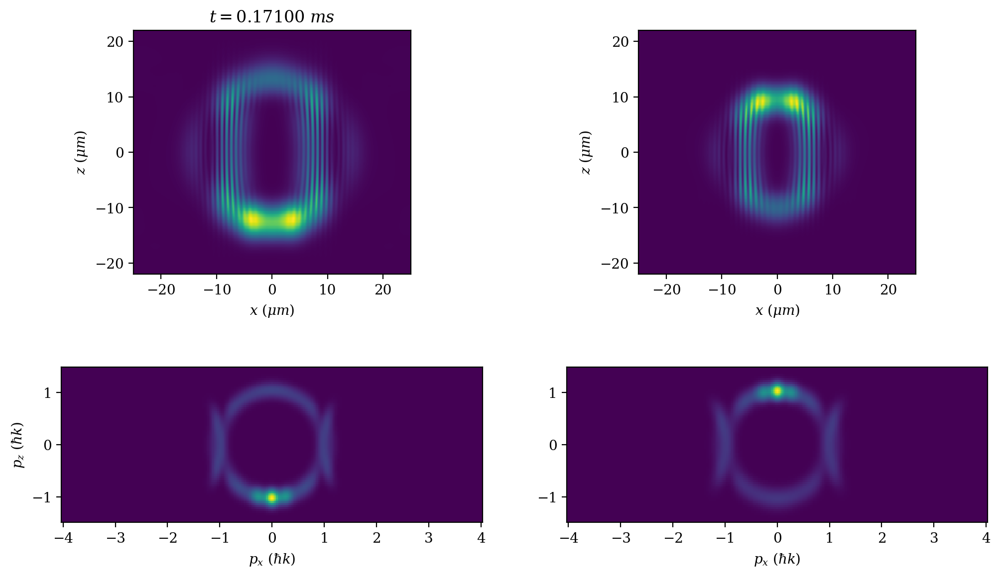

t = 0.17200 		 frame = 82 		 memory used: 7015.563MB  


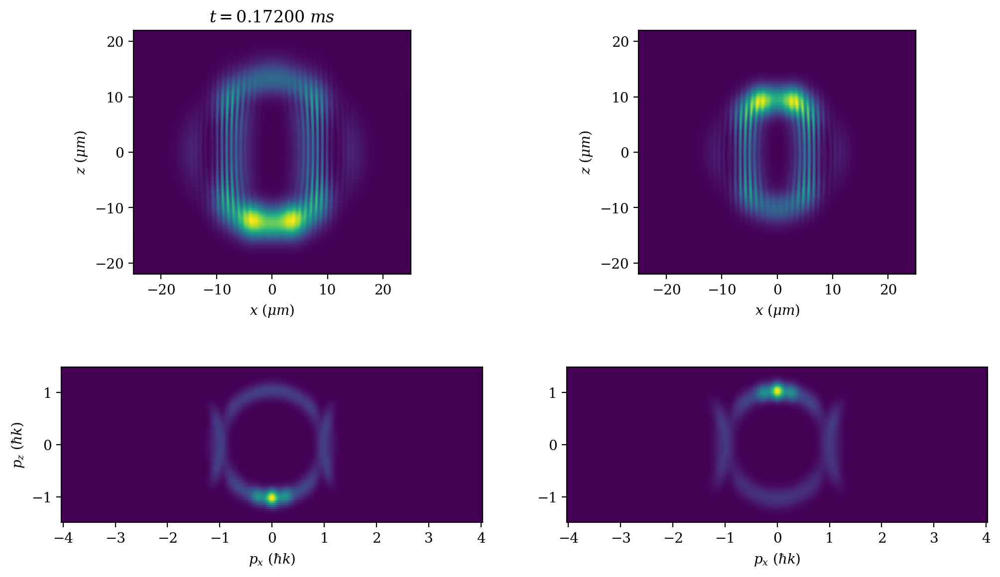

t = 0.17300 		 frame = 83 		 memory used: 6869.975MB  


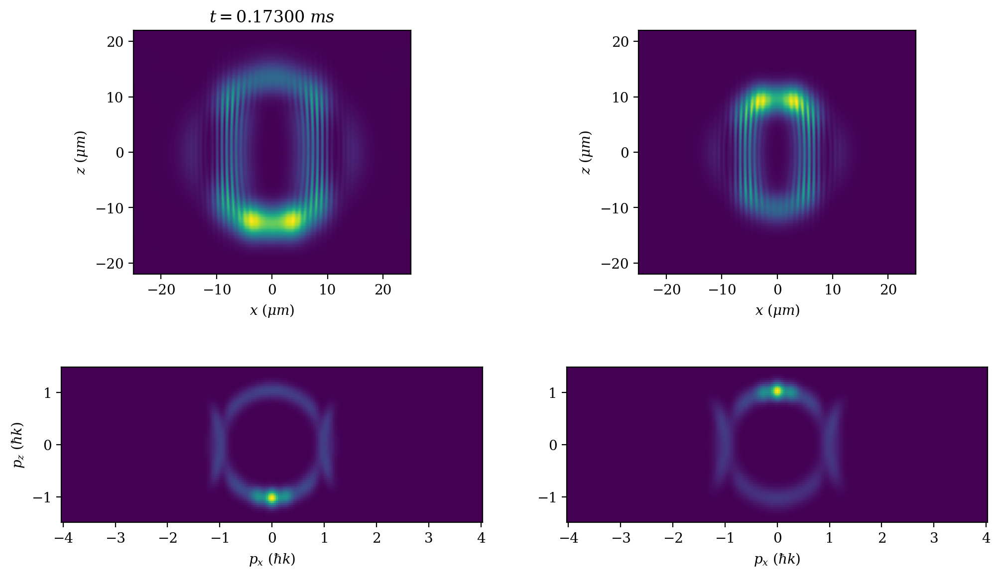

t = 0.17400 		 frame = 84 		 memory used: 9670.705MB  


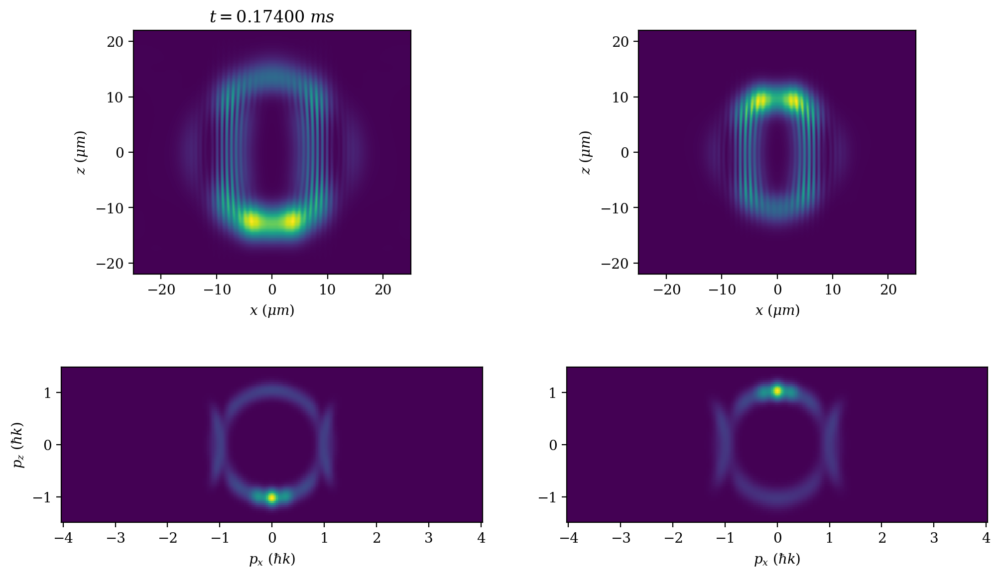

t = 0.17500 		 frame = 85 		 memory used: 6872.302MB  


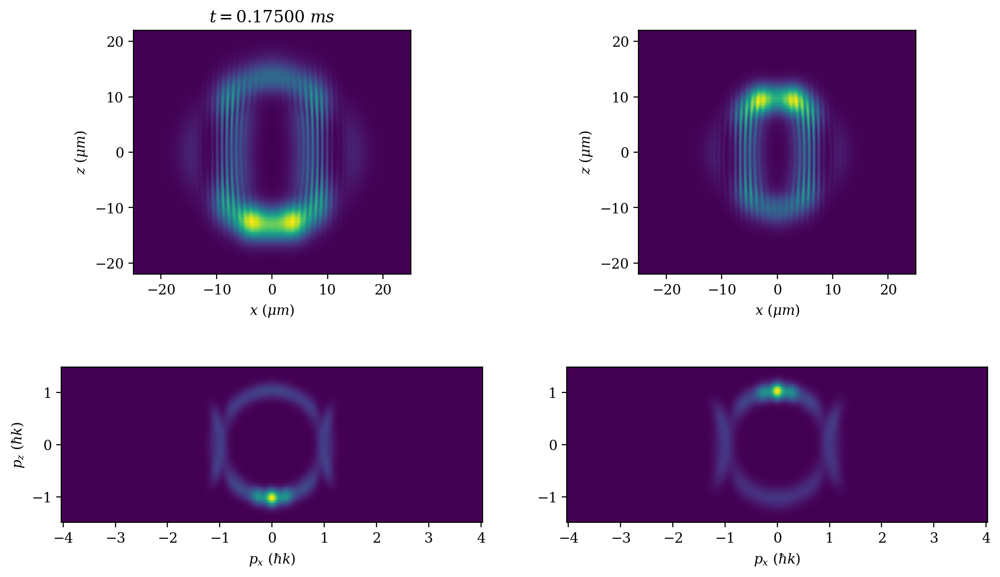

t = 0.17600 		 frame = 86 		 memory used: 9521.414MB  


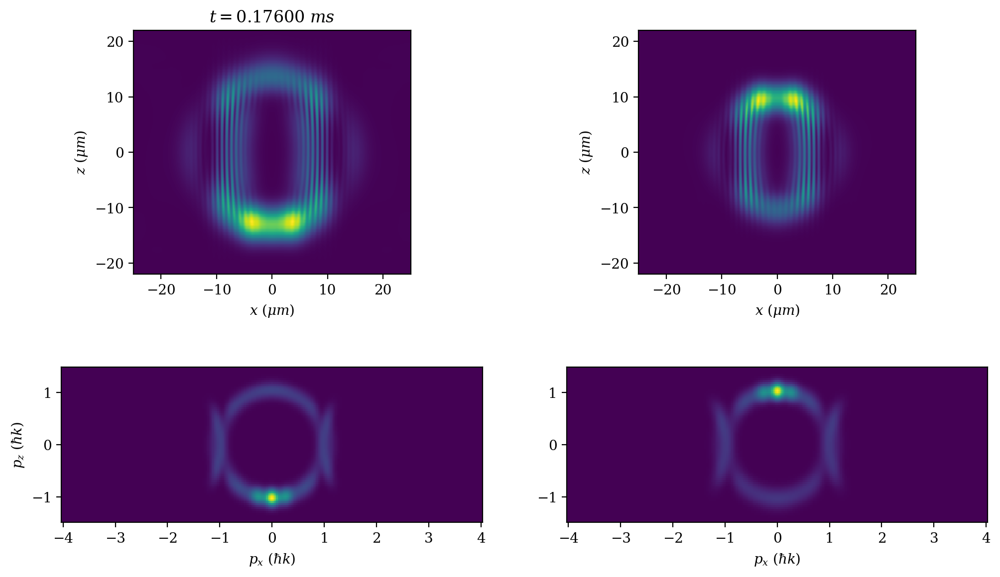

t = 0.17700 		 frame = 87 		 memory used: 9316.794MB  


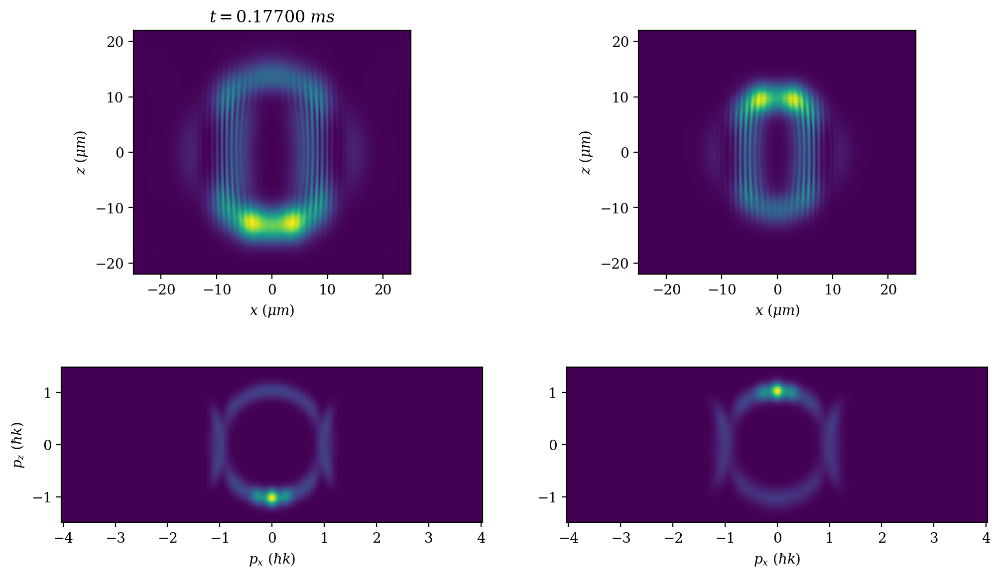

t = 0.17800 		 frame = 88 		 memory used: 6853.149MB  


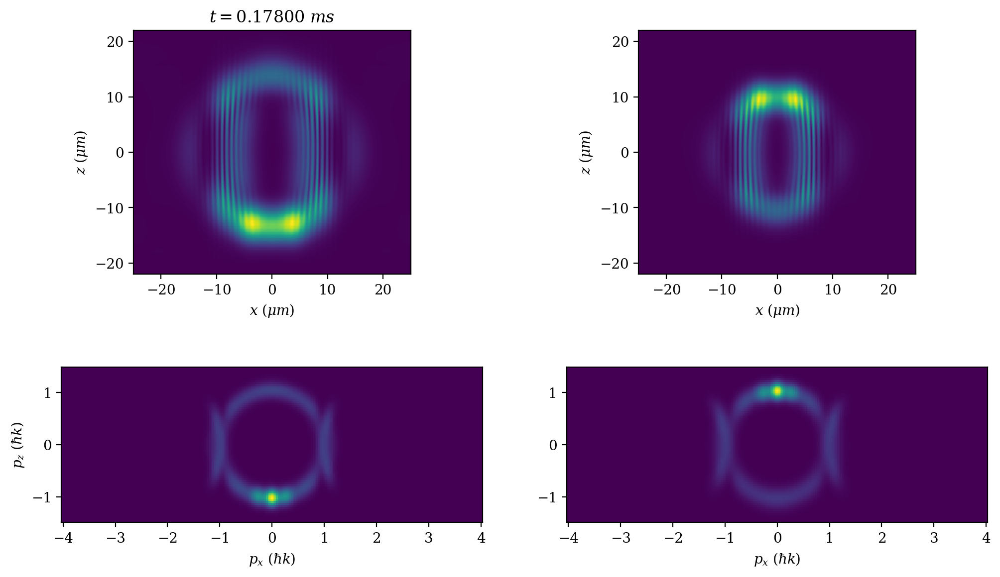

t = 0.17900 		 frame = 89 		 memory used: 9616.146MB  


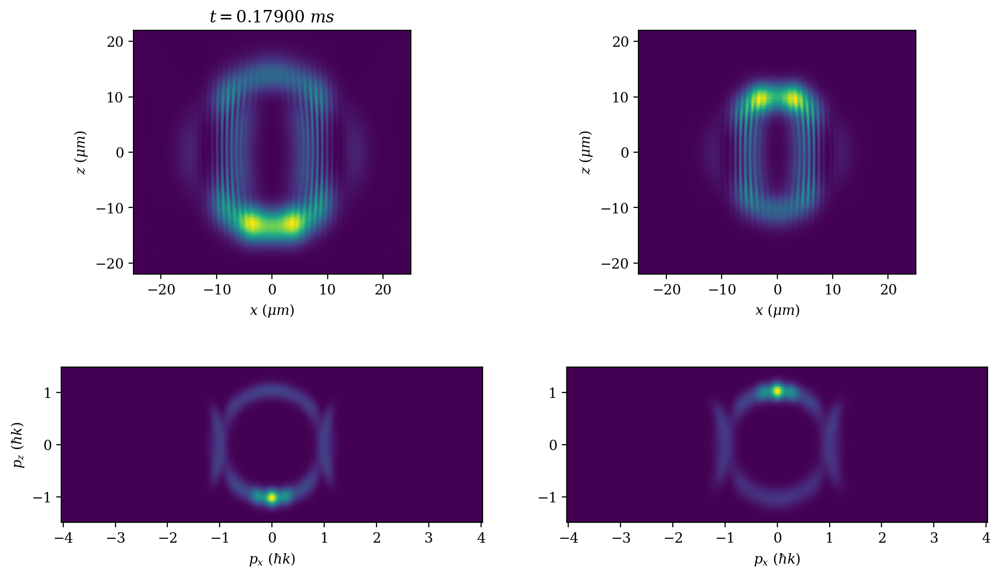

t = 0.18000 		 frame = 90 		 memory used: 9578.824MB  


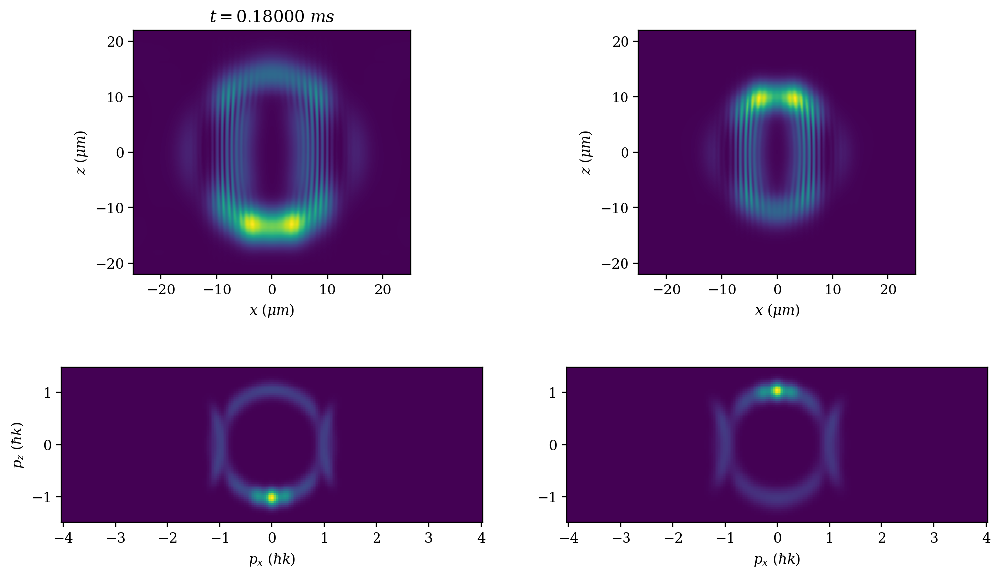

t = 0.18100 		 frame = 91 		 memory used: 9725.755MB  


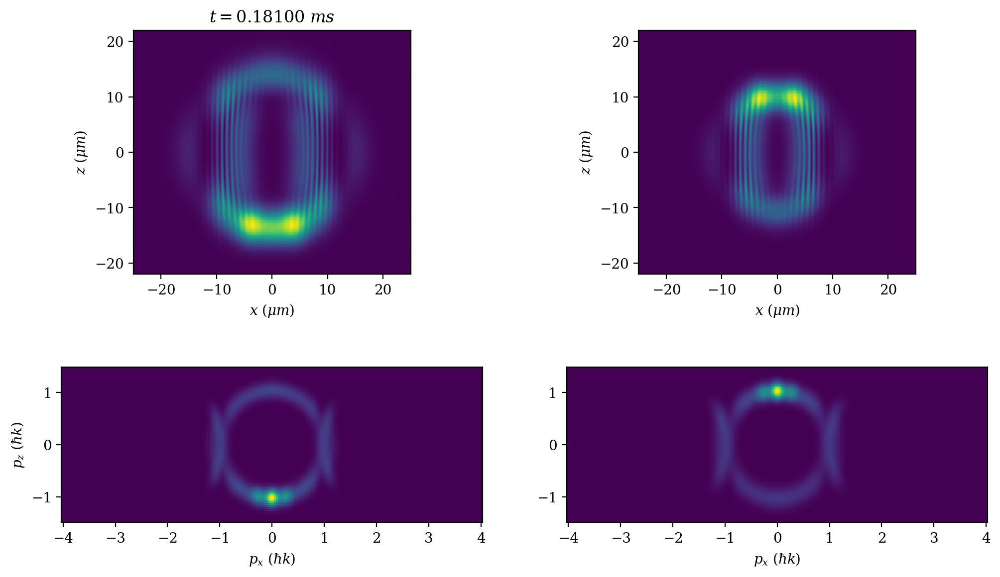

t = 0.18200 		 frame = 92 		 memory used: 6981.452MB  


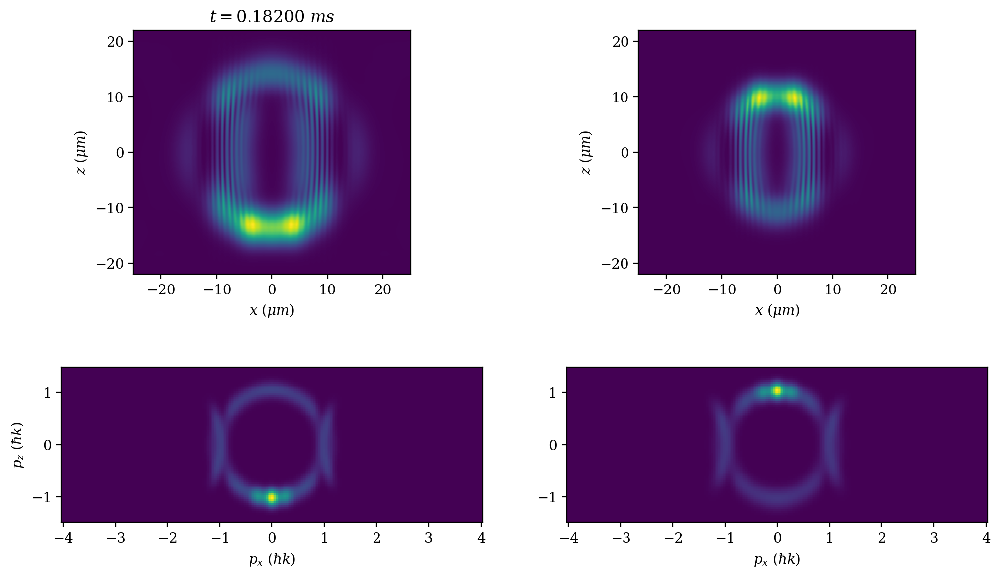

t = 0.18300 		 frame = 93 		 memory used: 6671.237MB  


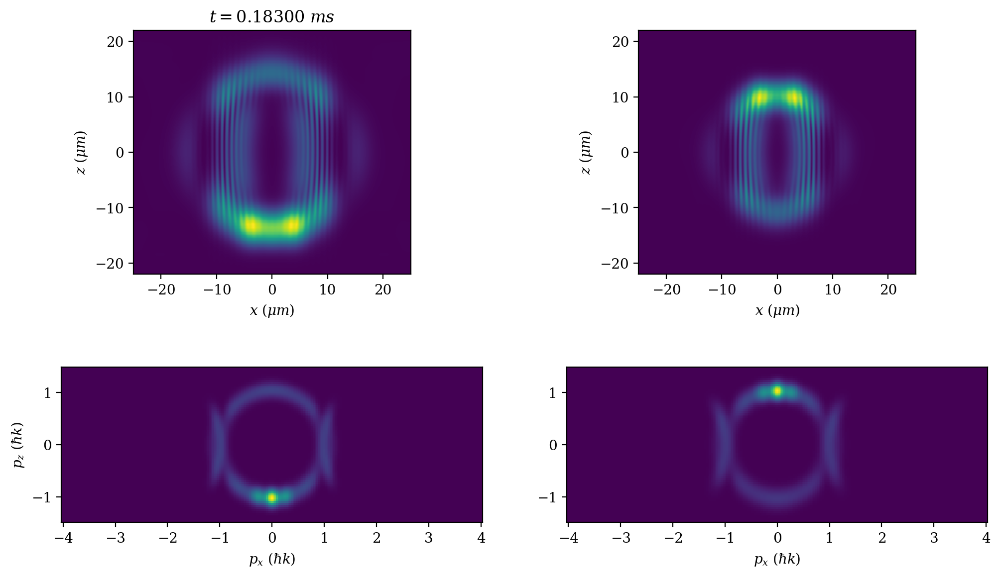

In [94]:
fb = 0
with ProgressBar(total=stepsBragg) as progressbar:
    for fb in range(frames_count_bragg):
        scattering_evolve_loop_plot(t,fb,psi,phi,
                                    plt_show=True, plt_save=True,plt_save_func_name="bragg_mirror")
        del phi # slower but saves memory
        gc.collect()
        (t,psi,phi) = bragg_evolve_helper_step(t_init=t,psi_init=psi,
                                               tw3=tau3Pi1,tc3=tMirMid,
                                               tw4=tau4Pi1,tc4=tMirMid,
                                               ph3=0,ph4=0,
                                               V3=0.4*V0F,V4=0.4*V0F,
                                               dop3=0,dop4=0,
                                               swnf=swnf,
                                               steps=print_every,
                                               progress_proxy=progressbar
                                              )
        
scattering_evolve_loop_plot(t,fb+1,psi,phi,
                            plt_show=True,plt_save=True,plt_save_func_name="bragg_mirror")

In [55]:
with pgzip.open('output/entangled_halo_proj/(20230211-181529-F) (t,psi) mirrorred.pgz.pkl', 'rb', thread=8) as file:
    (t,psi) = pickle.load(file)
phi, swnf = phiAndSWNF(psi, nthreads=8)


In [56]:
t 

0.18300000000000013

In [32]:
hbar_k_transfers = np.arange(-6,6+1)
pzlinIndexSet = np.zeros((len(hbar_k_transfers), len(pxlin)), dtype=bool)
# cut_p_width = 0.1
lr_include = 1
for (j, hbar_k) in enumerate(hbar_k_transfers):
#     pzlinIndexSet[j] = abs(pxlin/(hb*k) - hbar_k) <= cut_p_width

    index_unshift = round(hbar_k*(hb*k)/dpx)
    index = int(index_unshift + (nx-1)/2)
    for ishift in range(-lr_include, lr_include+1):
        pzlinIndexSet[j,index+ishift] = True
    
#     print(i,hbar_k, index)

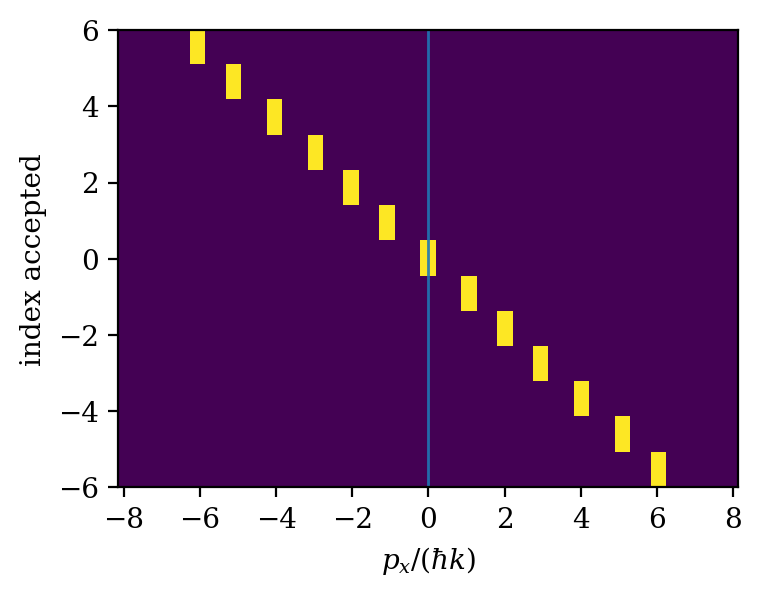

In [33]:
# plt.figure()
ax = plt.figure(figsize=(4,4)).gca()
plt.imshow(pzlinIndexSet,interpolation='none',aspect=1, extent=[-pxmax/(hb*k),pxmax/(hb*k),-6,+6])
# plt.axvline(x=(nx-1)/2, linewidth=1, alpha=0.1)
plt.axvline(x=0, linewidth=1, alpha=0.9)
plt.xlabel("$p_x/(\hbar k)$")
plt.ylabel("index accepted")
ax.xaxis.set_major_locator(MaxNLocator(integer=True))

title="hbar_k_pxlin_integration_range"
# plt.savefig("output/"+title+".pdf", dpi=600)
# plt.savefig("output/"+title+".png", dpi=600)
plt.show()

In [40]:
phiDensityGrid_hbark = np.zeros(len(hbar_k_transfers))

In [43]:
phiX3 = np.trapz(np.trapz(np.trapz( (np.abs(phi_try1)**2) , pzlin,axis=3),pxlin,axis=2),pzlin,axis=1)
for (j, hbar_k) in enumerate(hbar_k_transfers):
    index = pzlinIndexSet[j]
    phiDensityGrid_hbark[j] = np.trapz(phiX3[index], pxlin[index])

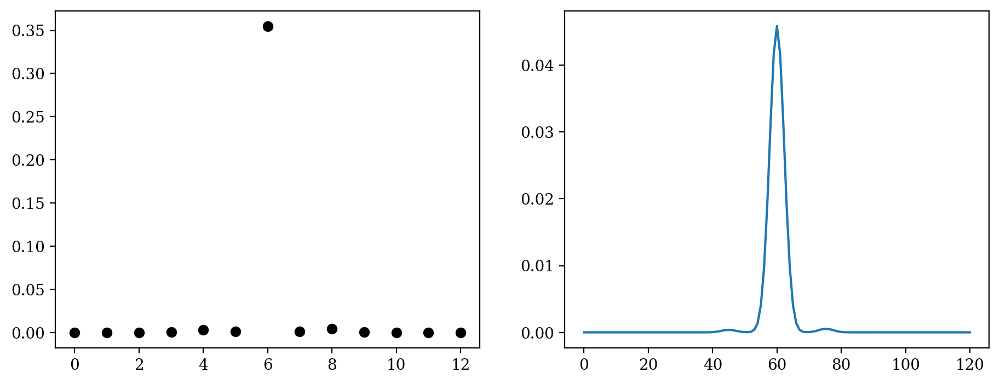

In [46]:
plt.figure(figsize=(11,4))
plt.subplot(1,2,1)
plt.plot(phiDensityGrid_hbark,'ko')
plt.subplot(1,2,2)
plt.plot(phiX3)

In [39]:
np.zeros(10)

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

In [50]:
def scan_tauPi_init_gaussian(tPi, a3=0, a4=0, p3=0, p4=0, doppd=dopd, V0FArg=V0F, 
                             logging=False, progress_bar=False):
    tauPi  = tPi
    tauMid = tauPi * 5
    tauEnd = tauPi * 10
    px3 = p3*cos(a3)
    pz3 = p3*sin(a3)
    px4 = p4*cos(a4)
    pz4 = p4*sin(a4)
    
    if logging:
        print("Testing parameters")
        print("tauPi =", round(tPi,6), "    \t tauMid =", round(tauMid,6), " \t tauEnd = ", round(tauEnd,6))
    output = numericalEvolve(t_init=0, 
                psi_init=psi0gaussian(sx3=su, sz3=su, sx4=su, sz4=su, px3=px3, pz3=pz3, px4=px4, pz4=pz4), 
                t_final=tauEnd, tPi=tauPi, tMid=tauMid, V0FArg=V0FArg, phase=0, doppd=doppd, 
                print_every_t=0*dt, final_plot=False, progress_bar=progress_bar)
    

In [52]:
_ = scan_tauPi_init_gaussian(tauPi,a3=0,a4=0,p3=0,p4=0,doppd=-10*dopd,V0FArg=V0F,
                             logging=False,progress_bar=True)

  0%|          | 0/39 [00:00<?, ?it/s]

In [91]:
tPiTest = np.append(np.arange(0.015,0,-dt), 0) # note this is decending
    # tPiTest = np.arange(dt,3*dt,dt)  

In [92]:
tPiTest[[1,2,3]]

array([0.0145, 0.014 , 0.0135])

In [ ]:
tPiOutput = Parallel(n_jobs=N_JOBS)(
    delayed(lambda tPi: (tPi, scan_tauPi_init_gaussian(tPi,a3=0,a4=0,p3=0,p4=0,doppd=-10*dopd,V0FArg=V0F,
                             logging=False,progress_bar=True)
           )(tPi) 
    for tPi in tqdm(tPiTest)
)     

In [ ]:
phiDensityGrid = np.zeros((len(tPiTest), pxlin.size))
phiDensityGrid_hbark = np.zeros((len(tPiTest),len(hbar_k_transfers)))

for i in tqdm(range(len(tPiTest))):
    item = tPiOutput[i]
    (swnf, phi) = phiAndSWNF(item[1][1])
    phiAbsSq = np.abs(phi)**2
    phiX = np.trapz(phiAbsSq, pzlin,axis=1)
    phiDensityGrid[i] = phiX

    for (j, hbar_k) in enumerate(hbar_k_transfers):
        index = pzlinIndexSet[j]
        phiDensityGrid_hbark[i,j] = np.trapz(phiX[index], pxlin[index])

## Free evolution

In [57]:
t_free_to_mix_c = tMix - dt*total_steps
print("t after mirror:", t_free_to_mix_c)
print("in steps:", t_free_to_mix_c/dt)

t after mirror: 0.07500000000000001
in steps: 150.00000000000003


In [58]:
tMixMid = t + t_free_to_mix_c
print("time of centre of mixing in this frame:",tMixMid)

time of centre of mixing in this frame: 0.2580000000000001


In [59]:
tMixBeg = tMixMid - tau4Pi2*5
tMixEnd = tMixMid + tau4Pi2*5

In [60]:
t_free_delta = tMixBeg - t
t_free_delta_steps = round(t_free_delta / dt)

tMix_steps = round(tau4Pi2*10/dt)

print("time delta: ", t_free_delta)
print("time steps: ", t_free_delta_steps)
print("mix steps:  ", tMix_steps)

time delta:  0.04899999999999999
time steps:  98
mix steps:   104


In [61]:
(tMixEnd-tMixBeg)/dt

104.00000000000003

t = 0.23200 		 frame = -1 		 memory used: 15517.27MB  


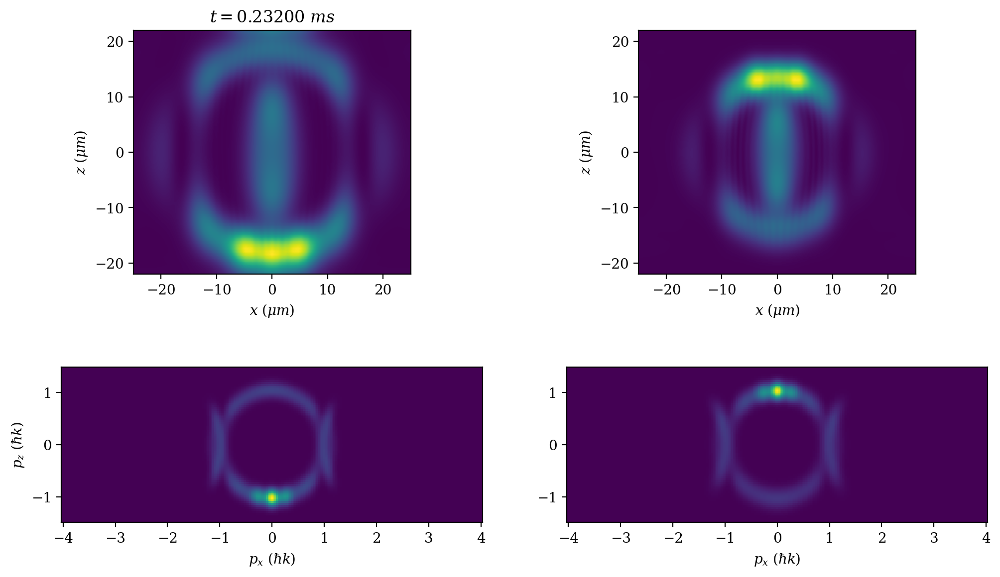

In [62]:
# assert False, "don't run yet"
for (iz3,pz3) in enumerate(pzlin):
    for (ix4,px4) in enumerate(pxlin):
        for (iz4,pz4) in enumerate(pzlin):
            phi[:,iz3,ix4,iz4] *= np.exp( -(1j/hb) * t_free_delta * (\
                                         (0.5/m3) * ( pxlin**2 + pz3**2) + \
                                         (0.5/m4) * ( px4**2   + pz4**2)  )
                                        )
psi = toPsi(phi,swnf,nthreads=7)
t = t + t_free_delta
scattering_evolve_loop_plot(t,-1,psi,phi,
                            plt_show=True,plt_save=True,plt_save_func_name="free_evolve")

In [63]:
t

0.23200000000000012

In [64]:
tMixMid

0.2580000000000001

## Final Mix Bragg

In [65]:
tMix_frames = tMix_steps // print_every
print(tMix_frames)

52


  0%|                                                                                                         …

t = 0.28400 		 frame = 52 		 memory used: 7589.822MB  


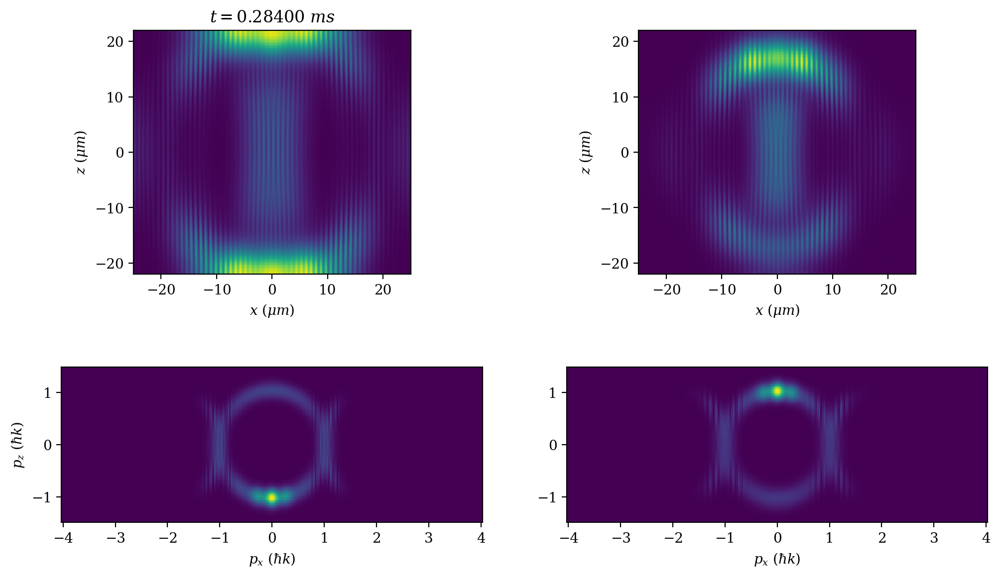

In [66]:
fb = 0
title_br_mix = "bragg_mixing_0_Pi"
with ProgressBar(total=tMix_steps) as progressbar:
    for fb in range(tMix_frames):
        scattering_evolve_loop_plot(t,fb,psi,phi,
                                    plt_show=False, plt_save=True,plt_save_func_name=title_br_mix)
        del phi # slower but saves memory
        gc.collect()
        (t,psi,phi) = bragg_evolve_helper_step(t_init=t,psi_init=psi,
                                               tw3=tau3Pi2,tc3=tMixMid,
                                               tw4=tau4Pi2,tc4=tMixMid,
                                               ph3=phase0,ph4=phasePi,
                                               V3=0.4*V0F,V4=0.4*V0F,
                                               dop3=0,dop4=0,
                                               swnf=swnf,
                                               steps=print_every,
                                               progress_proxy=progressbar
                                              )
        
scattering_evolve_loop_plot(t,fb+1,psi,phi,
                            plt_show=True,plt_save=True,plt_save_func_name=title_br_mix)

TODO:
* phase
* bigger grid

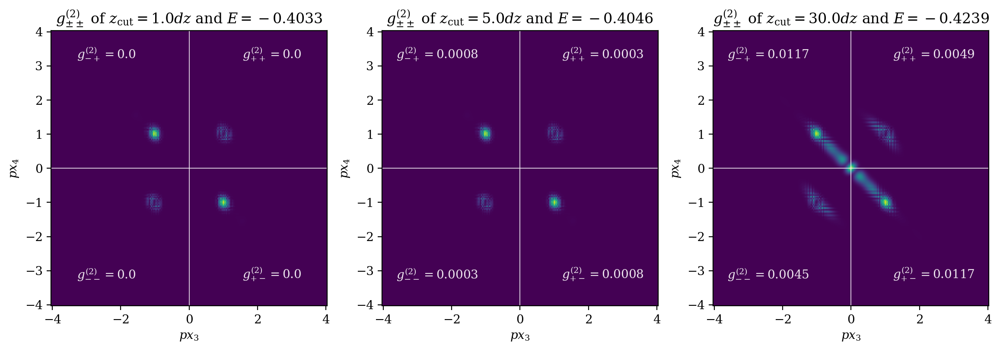

In [75]:
plt.figure(figsize=(14,6))

cut_list = [1.0, 5.0, 30.0]
for i in range(3):
    cut = cut_list[i]
    gx3x4 = gx3x4_calc(phi,cut=cut)
    plt.subplot(1,3,i+1)
    plot_gx3x4_phi(gx3x4,cut)
plt.show()
del gx3x4

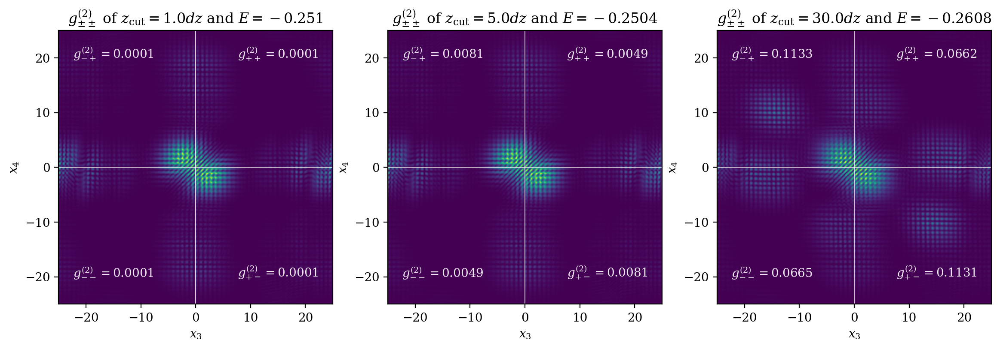

In [71]:
plt.figure(figsize=(14,6))

cut_list = [1.0, 5.0, 30.0]
for i in range(3):
    cut = cut_list[i]
    gx3x4 = gx3x4_calc(psi,cut=cut)
    plt.subplot(1,3,i+1)
    plot_gx3x4(gx3x4,cut)
plt.show()
del gx3x4

In [189]:
1/sqrt(2)

0.7071067811865475